In [1]:
import numpy as np
from sklearn.manifold import TSNE
%matplotlib inline
from matplotlib import pyplot as plt
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA


In [ ]:
data = np.load("/sailhome/ethanchi/structural-probes/relationOutputs/all.npy") 
labels = np.load("/sailhome/ethanchi/structural-probes/relationOutputs/allY.npy")
extra = np.load("/sailhome/ethanchi/structural-probes/relationOutputs/all-data.npy").T

print(np.unique(labels).shape)
print("Finished loading data.")
print(labels)
print(data)


In [ ]:


try:
    tsne = TSNE(n_components=2, random_state=229, verbose=10)
except KeyboardInterrupt:
    print("Interrupted.")
    exit()
print("Fitting.")
projected = tsne.fit_transform(data)
print("Fitted.")





Fitting.
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 56328 samples in 0.153s...


In [7]:
# np.save("/sailhome/ethanchi/structural-probes/relationOutputs/en-fr-transfer-projected.npy", projected)
np.save("/sailhome/ethanchi/structural-probes/relationOutputs/en-fr-transfer-labels.npy", labels)
np.save("/sailhome/ethanchi/structural-probes/relationOutputs/en-fr-transfer-extra.npy", extra)

In [3]:
projected = np.load("/sailhome/ethanchi/structural-probes/relationOutputs/en-fr-transfer-projected.npy".format(path))
print(projected.shape)

(56328, 2)


In [29]:
NUM_CLUSTERS = 70

kmeans = KMeans(n_clusters=NUM_CLUSTERS)

kmeans.fit(projected)


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=70, n_init=10, n_jobs=None, precompute_distances='auto',
    random_state=None, tol=0.0001, verbose=0)

In [22]:
remove_colon = np.vectorize(lambda x: x if ':' not in x else x.split(':')[0])
labels = remove_colon(labels)

unique_labels, counts = np.unique(labels, return_counts=True)

mapping = dict(zip(unique_labels, counts))
mapping = sorted(mapping.items(), key=lambda kv: -kv[1])
print("\n".join("\t".join(str(y) for y in x) for x in mapping))

remove_langs = np.vectorize(lambda x: x.replace('en-', '').replace('fr-', ''))
base_labels = remove_langs(labels)

base_unique_labels, base_counts = np.unique(base_labels, return_counts=True)

base_mapping = dict(zip(base_unique_labels, base_counts))
base_mapping = sorted(base_mapping.items(), key=lambda kv: -kv[1])
print("\n".join("\t".join(str(y) for y in x) for x in base_mapping))


fr-case	5229
fr-det	4432
fr-punct	3804
fr-nmod	3225
en-punct	3066
fr-obl	2412
en-nsubj	2143
fr-nsubj	2076
en-case	2015
fr-amod	1904
en-det	1846
en-advmod	1316
fr-advmod	1260
en-amod	1251
en-nmod	1239
en-obj	1234
fr-conj	1199
fr-obj	1167
en-obl	1151
en-compound	1110
fr-cc	951
en-conj	920
en-aux	914
en-cc	801
en-mark	784
fr-acl	742
fr-flat	714
fr-aux	672
fr-appos	594
en-cop	593
fr-mark	565
fr-cop	451
fr-xcomp	399
en-acl	394
en-xcomp	371
en-advcl	365
fr-nummod	338
fr-fixed	299
fr-advcl	294
en-nummod	272
en-parataxis	240
en-ccomp	228
en-flat	225
fr-expl	184
en-appos	175
en-discourse	123
fr-ccomp	101
en-expl	87
en-list	75
fr-parataxis	72
fr-iobj	70
en-fixed	58
en-iobj	46
en-csubj	40
en-goeswith	33
en-vocative	21
fr-orphan	11
en-reparandum	6
fr-goeswith	5
fr-csubj	4
fr-discourse	3
fr-reparandum	3
en-dep	2
en-orphan	2
fr-dislocated	1
fr-vocative	1
case	7244
punct	6870
det	6278
nmod	4464
nsubj	4219
obl	3563
amod	3155
advmod	2576
obj	2401
conj	2119
cc	1752
aux	1586
mark	1349
acl	1136
compound	1

In [23]:
print(kmeans.labels_)
print(kmeans.cluster_centers_)
print(kmeans.labels_[labels == 'en-nsubj'])
print(kmeans.labels_[labels == 'en-nsubj'].shape)
print(np.bincount(kmeans.labels_[labels == 'en-nsubj']))

u_labels, counts = np.unique(kmeans.labels_, return_counts=True)
print(dict(zip(u_labels, counts)))

for label in np.unique(labels):
  print("{: <10}".format(label), end="\t")
  print("".join(["{:4d}".format(x) for x in np.bincount(kmeans.labels_[labels == label], minlength=NUM_CLUSTERS)]))

[13 53  0 ... 26  6  6]
[[ 26.241299   -16.341722  ]
 [ -4.204549    28.502048  ]
 [-20.6401     -16.695642  ]
 [ 10.519639   -37.54846   ]
 [  6.3278346   10.833763  ]
 [-46.709763    13.002562  ]
 [ 35.853024     7.7430134 ]
 [ 21.357       50.118492  ]
 [ -9.659454   -38.96571   ]
 [-21.73325     18.080854  ]
 [-45.56355     -2.171072  ]
 [ -3.5334725   44.697544  ]
 [ 18.70981     32.928482  ]
 [ 14.339172   -12.359253  ]
 [ 45.207237   -22.04095   ]
 [-27.805094    27.185654  ]
 [-12.728339   -10.543058  ]
 [-26.803404   -28.867271  ]
 [-46.129063    28.71819   ]
 [ 20.28282    -32.413376  ]
 [-17.789116   -51.910458  ]
 [ 23.771116    14.358359  ]
 [ -9.432263    15.823885  ]
 [ 12.459979    54.684433  ]
 [-23.082655    38.794167  ]
 [ 31.551447    23.875298  ]
 [-31.983942    -5.978046  ]
 [ 33.264114    -9.220588  ]
 [ -5.8502665  -17.916985  ]
 [-16.777752    25.10187   ]
 [ 19.728937    -6.245812  ]
 [-28.989634   -42.181625  ]
 [ 10.764223   -49.09623   ]
 [ 46.01217     17.

In [24]:
# top_labels = [x[0] for x in mapping[:20]]
important_labels = ['case', 'det', 'nsubj', 'amod', 'advmod', 'conj', 'cc', 'xcomp', 'cop', 'obl', 'obj', 'punct', 'compound', 'aux', 'mark']
top_labels = ['fr-' + x for x in important_labels] + ['en-' + x for x in important_labels]
print(top_labels)

print(labels.shape)


['fr-case', 'fr-det', 'fr-nsubj', 'fr-amod', 'fr-advmod', 'fr-conj', 'fr-cc', 'fr-xcomp', 'fr-cop', 'fr-obl', 'fr-obj', 'fr-punct', 'fr-compound', 'fr-aux', 'fr-mark', 'en-case', 'en-det', 'en-nsubj', 'en-amod', 'en-advmod', 'en-conj', 'en-cc', 'en-xcomp', 'en-cop', 'en-obl', 'en-obj', 'en-punct', 'en-compound', 'en-aux', 'en-mark']
(56328,)


In [25]:
import matplotlib.colors
xkcd_colors = ['xkcd:purple', 'xkcd:pink', 'xkcd:blue', 'xkcd:green', 'xkcd:brown', 'xkcd:red', 'xkcd:teal', 'xkcd:orange', 'xkcd:yellow', 'xkcd:magenta', 'xkcd:sky blue', 'xkcd:grey', 'xkcd:lime green', 'xkcd:light purple', 'xkcd:violet', 'xkcd:dark green', 'xkcd:turquoise', 'xkcd:lavender', 'xkcd:dark blue', 'xkcd:tan', 'xkcd:cyan', 'xkcd:aqua', 'xkcd:forest green', 'xkcd:mauve', 'xkcd:dark purple', 'xkcd:bright green', 'xkcd:maroon', 'xkcd:olive', 'xkcd:salmon', 'xkcd:beige', 'xkcd:royal blue', 'xkcd:navy blue', 'xkcd:lilac', 'xkcd:black', 'xkcd:hot pink', 'xkcd:light brown', 'xkcd:pale green', 'xkcd:peach', 'xkcd:olive green', 'xkcd:dark pink']
base_colors = ['xkcd:blue', 'xkcd:green', 'xkcd:orange', 'red', 'purple', 'xkcd:brown', 'xkcd:black'] + xkcd_colors
base_colors = base_colors[:len(important_labels)]
brighten = lambda x: [min(1, y + 0.4) for y in x]
darken = lambda x: [max(0, y - 0.2) for y in x]
en_colors = [brighten(matplotlib.colors.to_rgba(x)) for x in base_colors]
fr_colors = [darken(matplotlib.colors.to_rgba(x)) for x in base_colors]
colors = fr_colors + en_colors

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


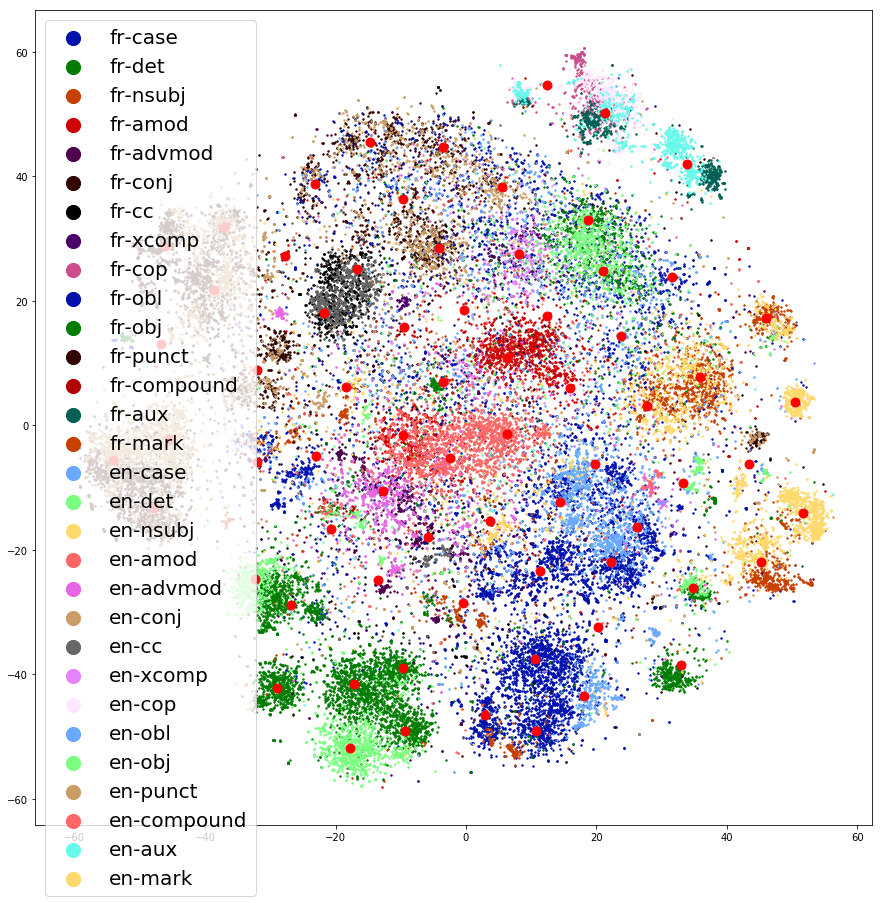

Shown


In [26]:


plt.figure(figsize=(15, 15))

USE_MARKERS = False
if USE_MARKERS:
    CUT = 300

    # c = np.vectorize(lambda x: colors[top_labels.index(x)])(labels)
    for i, c in list(zip(top_labels, colors)):
        plt.scatter(projected[labels == i, 0][:CUT], projected[labels == i, 1][:CUT], c=c, label=i, s=40, alpha=1, marker="." if i.startswith('en') else "+")
else:
     for i, c in list(zip(top_labels, colors)):
        plt.scatter(projected[labels == i, 0], projected[labels == i, 1], c=c, label=i, s=2, alpha=1)
        
for row in kmeans.cluster_centers_:
  plt.scatter(row[0], row[1], c="red", s=80)

# in_top_labels = np.vectorize(lambda x: x in top_labels)

# print(labels.shape)
# labels = labels[np.where(in_top_labels(labels))]
# projected = projected[np.where(in_top_labels(labels))]
# print(labels.shape)
# # for row in projected.shape[0]:
# labels = labels.reshape(-1, 1)
# print(projected.shape, labels.shape)
# c = np.vectorize(lambda x: colors[top_labels.index(x)])(labels)

# print(c[1:5])
# print("Colors loaded")
# arr = np.concatenate((projected, labels, c), axis=1)
# np.random.shuffle(arr)


# for i in range(100):
#     plt.scatter(arr[i][0].astype(np.float32), arr[i][1].astype(np.float32), c=arr[i][3], label=arr[i][2], s=2, alpha=1)
# print("Scatter finished")



    
# for i, c in zip(top_labels, colors):
#     plt.scatter(projected[labels == i, 0], projected[labels == i, 1], c=c, label=i, s=2, alpha=1)
plt.legend(markerscale=1 if USE_MARKERS else 10, prop={'size': 20})
plt.show();
print("Shown")



In [27]:
srcData = np.load("/sailhome/ethanchi/structural-probes/relationOutputs/en-pairs.npy") 
destData = np.load("/sailhome/ethanchi/structural-probes/relationOutputs/en-fr-pairs.npy") 
pairs_data = np.concatenate([srcData, destData], axis=0)

Cluster 0 (686 words)
[ 26.241299 -16.341722]
{'en-case': 261, 'fr-case': 311, 'fr-nmod': 21}
0.5306339


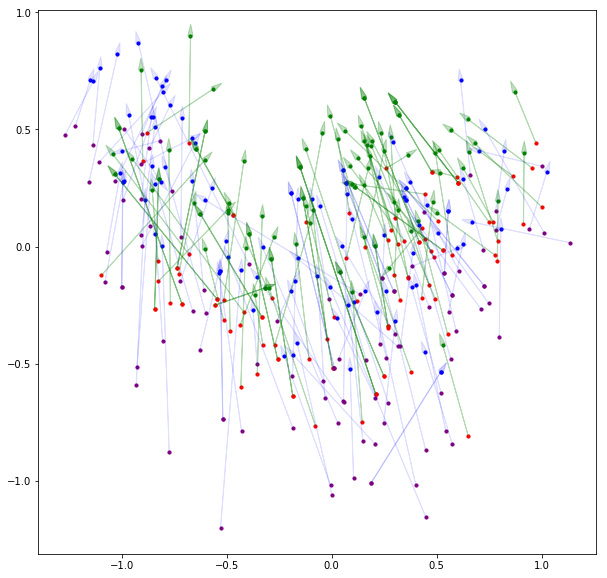

Cluster 1 (965 words)
[-4.204549 28.502048]
{'en-conj': 245, 'en-nmod': 34, 'en-obl': 29, 'fr-appos': 38, 'fr-conj': 261, 'fr-nmod': 84, 'fr-obl': 49}
0.47103107


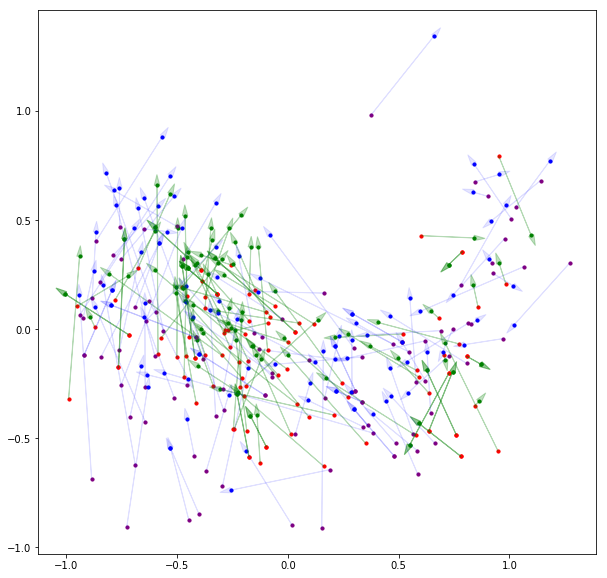

Cluster 2 (796 words)
[-20.6401   -16.695642]
{'en-advmod': 37, 'en-amod': 35, 'en-det': 85, 'en-nummod': 107, 'fr-advmod': 32, 'fr-amod': 41, 'fr-det': 68, 'fr-nummod': 234, 'fr-obl': 33}
0.46079236


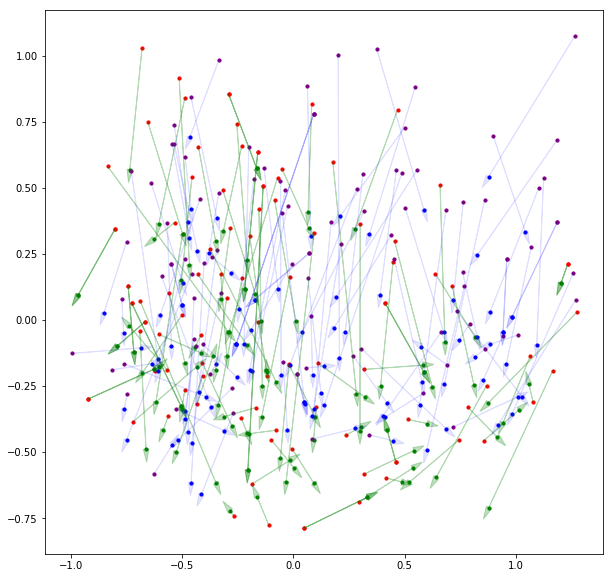

Cluster 3 (1059 words)
[ 10.519639 -37.54846 ]
{'fr-case': 948}
0.6109121


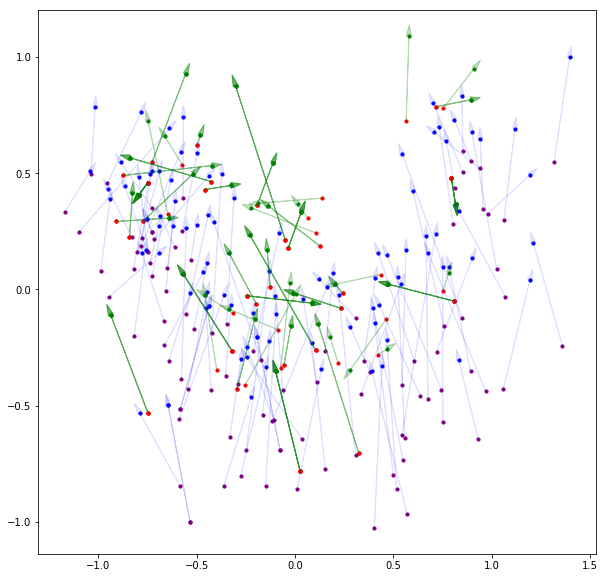

Cluster 4 (1112 words)
[ 6.3278346 10.833763 ]
{'en-advmod': 26, 'en-nmod': 25, 'fr-acl': 72, 'fr-amod': 568, 'fr-appos': 52, 'fr-case': 27, 'fr-nmod': 134, 'fr-obl': 21}
0.49110615


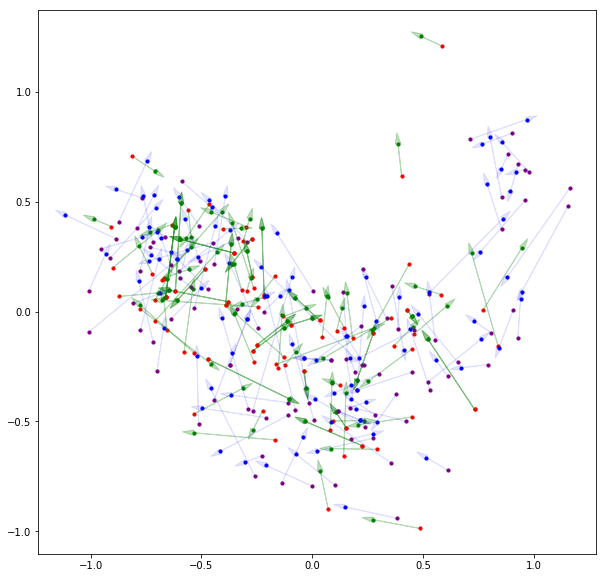

Cluster 5 (364 words)
[-46.709763  13.002562]
{'en-punct': 122, 'fr-det': 73, 'fr-punct': 87}
0.55979127


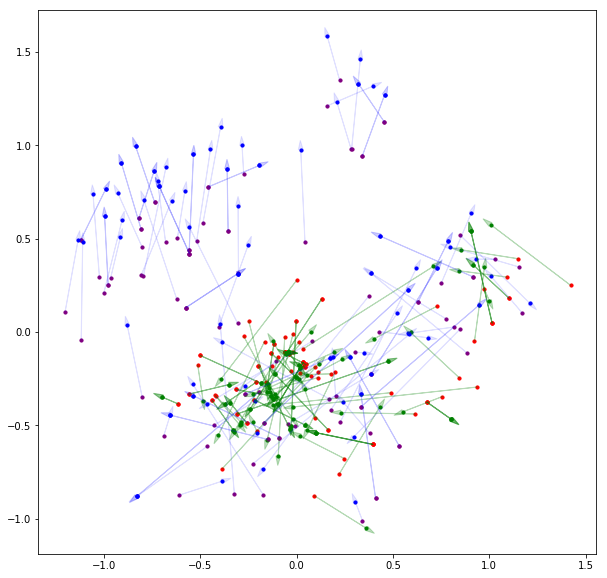

Cluster 6 (1061 words)
[35.853024   7.7430134]
{'en-nsubj': 326, 'fr-nmod': 26, 'fr-nsubj': 574, 'fr-obj': 24, 'fr-obl': 29}
0.33636937


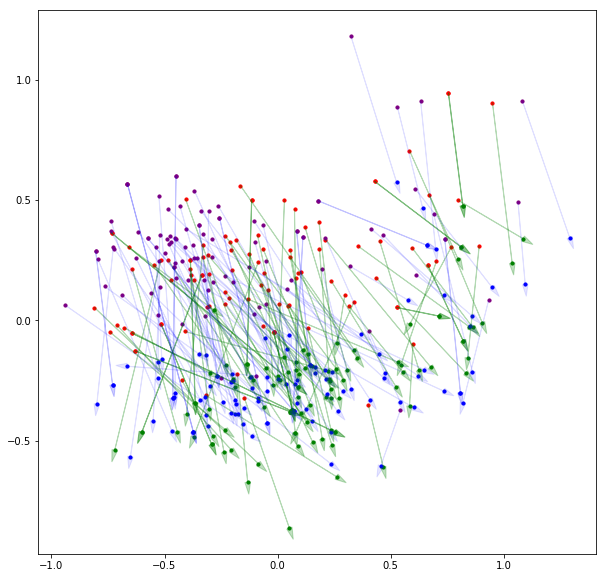

Cluster 7 (1243 words)
[21.357    50.118492]
{'en-aux': 216, 'en-cop': 448, 'fr-aux': 284, 'fr-cop': 230}
0.3721858


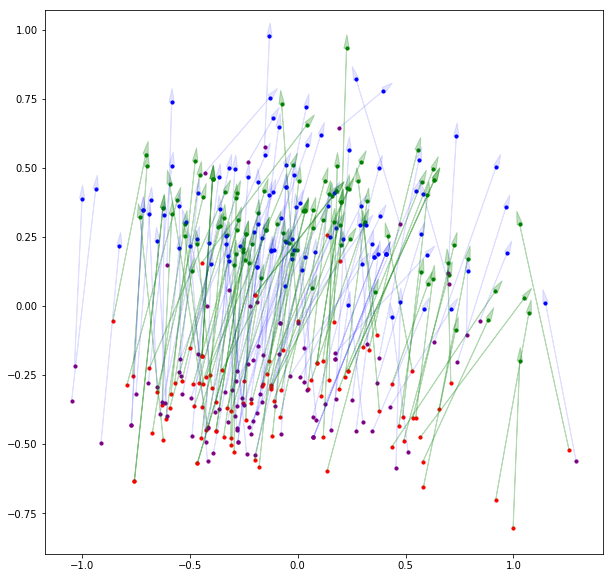

Cluster 8 (700 words)
[ -9.659454 -38.96571 ]
{'en-det': 35, 'fr-case': 33, 'fr-det': 516}
0.57878363


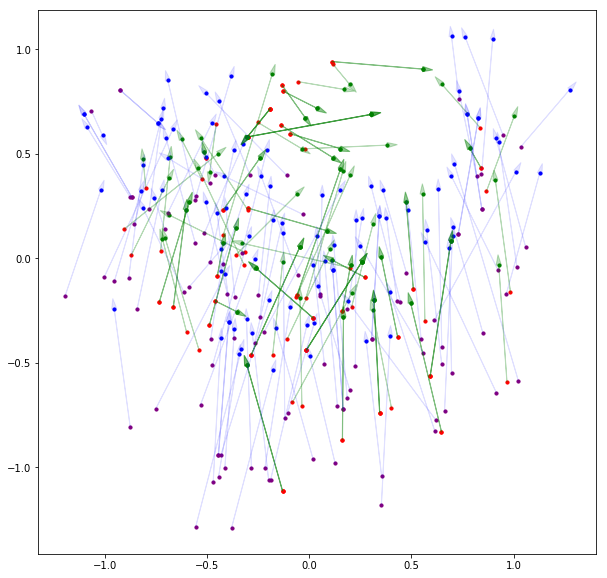

Cluster 9 (862 words)
[-21.73325   18.080854]
{'en-advmod': 88, 'en-cc': 327, 'fr-cc': 348}
0.41554356


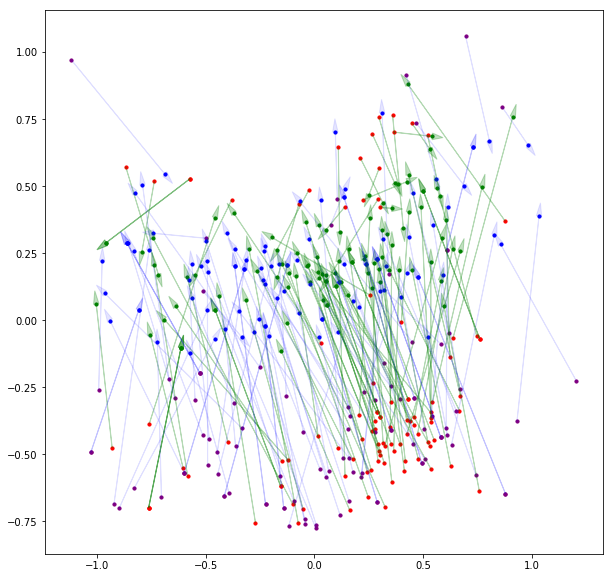

Cluster 10 (994 words)
[-45.56355   -2.171072]
{'en-punct': 807, 'fr-punct': 155}
0.25284678


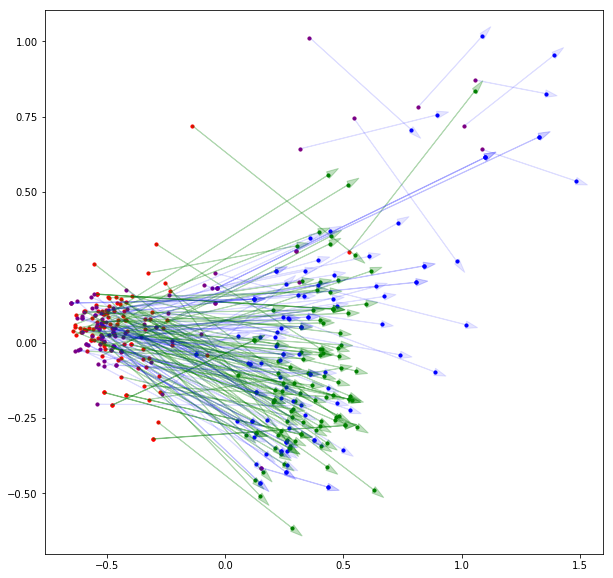

Cluster 11 (905 words)
[-3.5334725 44.697544 ]
{'en-acl': 27, 'en-advcl': 40, 'en-conj': 137, 'en-list': 23, 'en-obl': 32, 'en-parataxis': 70, 'fr-acl': 52, 'fr-advcl': 51, 'fr-advmod': 23, 'fr-appos': 24, 'fr-conj': 180, 'fr-nmod': 27, 'fr-obl': 63}
0.36682582


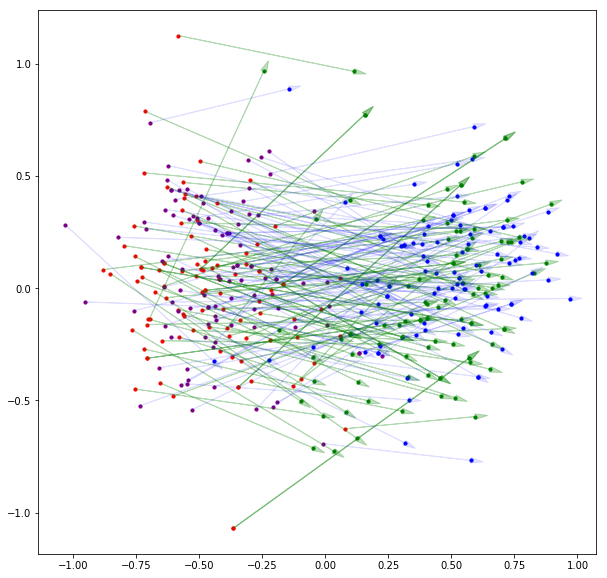

Cluster 12 (1015 words)
[18.70981  32.928482]
{'en-nsubj': 21, 'en-obj': 307, 'en-obl': 50, 'fr-nmod': 62, 'fr-obj': 303, 'fr-obl': 150}
0.4152623


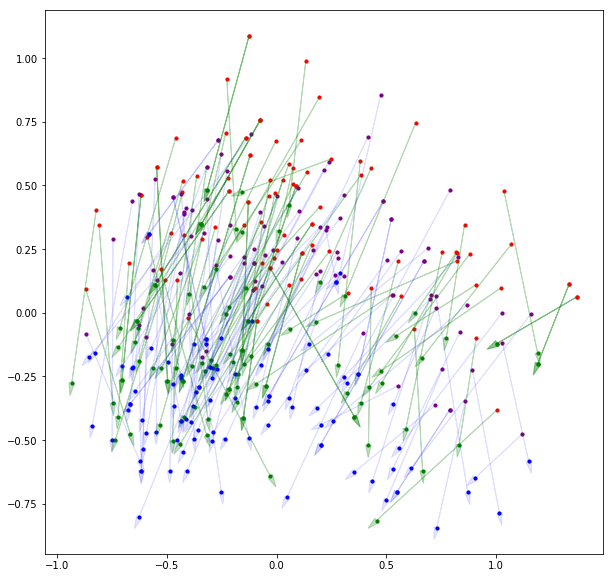

Cluster 13 (820 words)
[ 14.339172 -12.359253]
{'en-case': 384, 'en-mark': 44, 'fr-case': 249, 'fr-nmod': 21, 'fr-obl': 26}
0.44755596


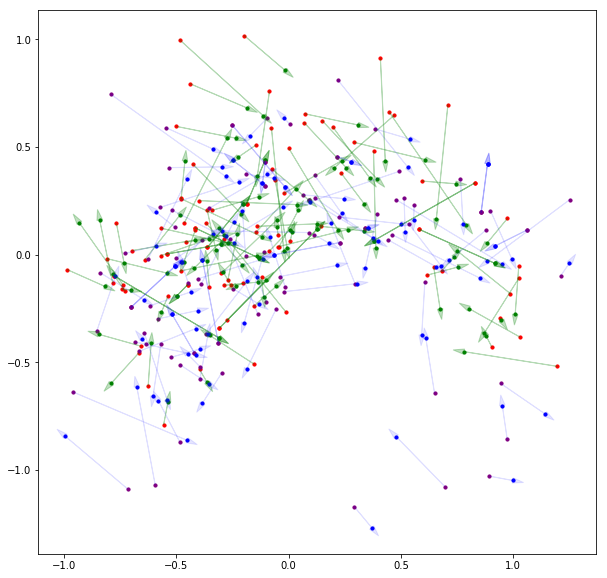

Cluster 14 (933 words)
[ 45.207237 -22.04095 ]
{'en-expl': 82, 'en-nsubj': 339, 'fr-nsubj': 462}
0.40117228


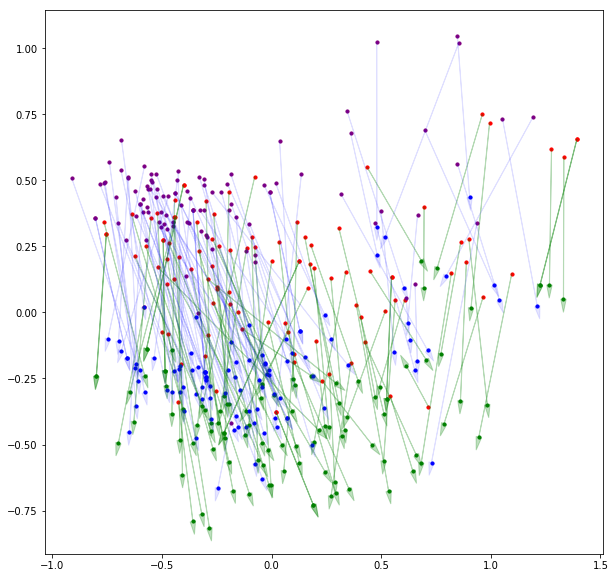

Cluster 15 (392 words)
[-27.805094  27.185654]
{'en-punct': 98, 'fr-case': 22, 'fr-nmod': 100, 'fr-punct': 59}
0.6123796


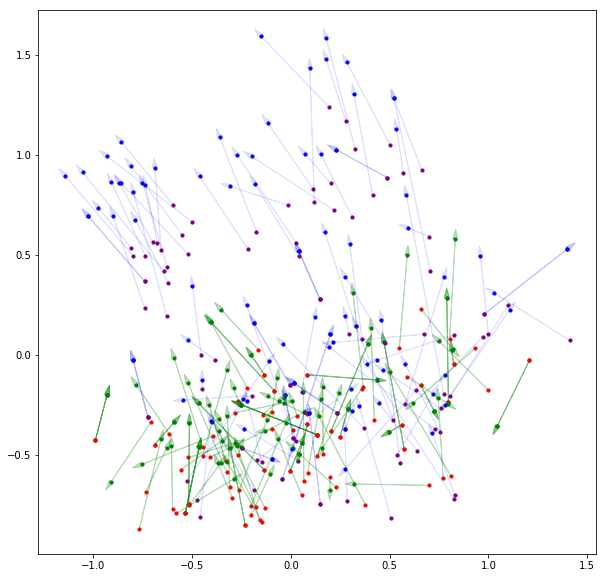

Cluster 16 (862 words)
[-12.728339 -10.543058]
{'en-advmod': 399, 'en-amod': 56, 'fr-advmod': 264, 'fr-amod': 28, 'fr-obl': 22}
0.43271667


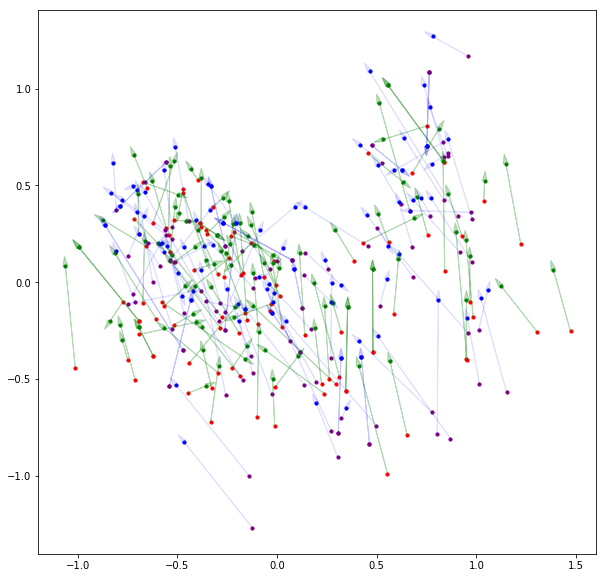

Cluster 17 (750 words)
[-26.803404 -28.867271]
{'en-det': 36, 'fr-case': 34, 'fr-det': 626}
0.4694087


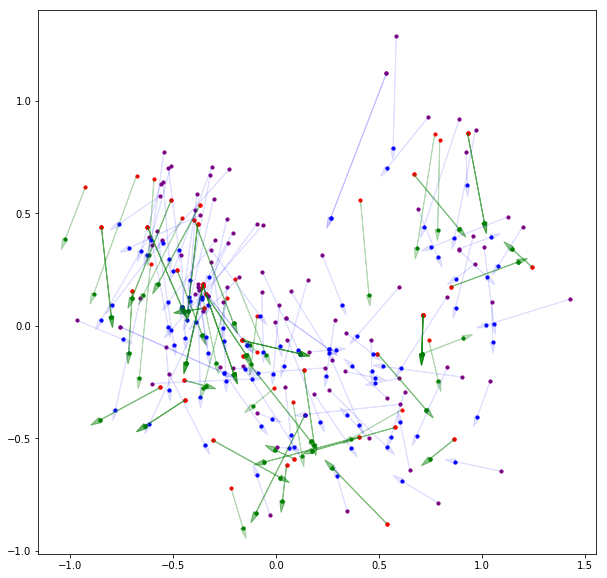

Cluster 18 (620 words)
[-46.129063  28.71819 ]
{'en-punct': 102, 'fr-punct': 513}
0.39182234


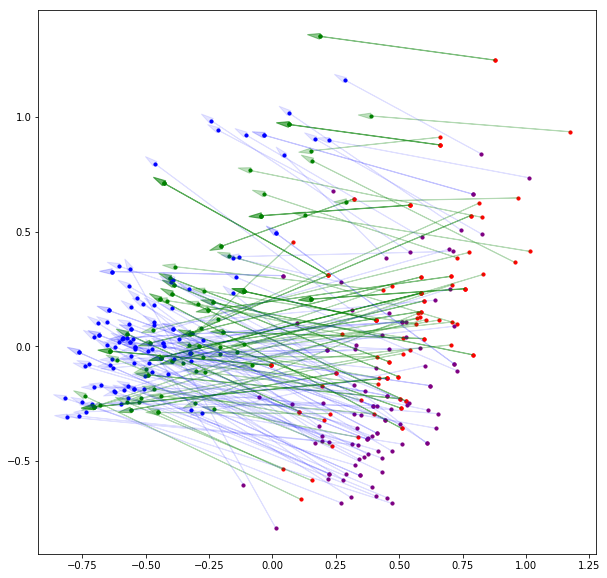

Cluster 19 (435 words)
[ 20.28282  -32.413376]
{'en-case': 24, 'fr-case': 207, 'fr-fixed': 52}
0.5461973


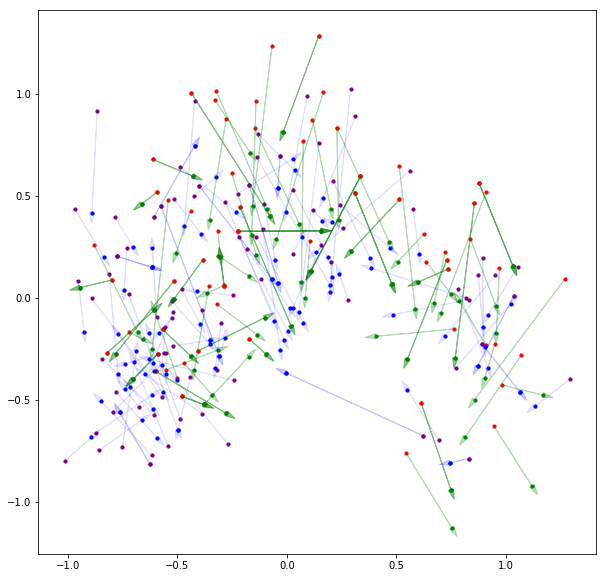

Cluster 20 (902 words)
[-17.789116 -51.910458]
{'en-det': 763, 'fr-det': 120}
0.4465301


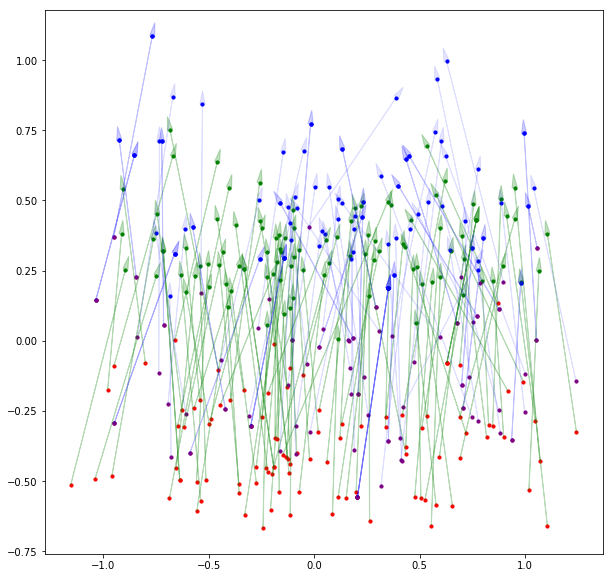

Cluster 21 (928 words)
[23.771116 14.358359]
{'en-nmod': 124, 'en-nsubj': 24, 'en-obj': 25, 'en-obl': 79, 'fr-nmod': 374, 'fr-nsubj': 24, 'fr-obj': 49, 'fr-obl': 127}
0.46766204


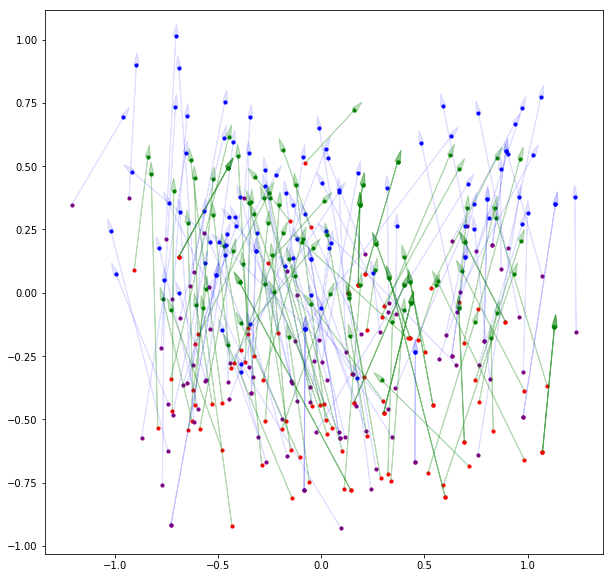

Cluster 22 (705 words)
[-9.432263 15.823885]
{'en-flat': 40, 'en-obl': 27, 'fr-amod': 31, 'fr-flat': 137, 'fr-nmod': 97, 'fr-obl': 26, 'fr-xcomp': 67}
0.4642713


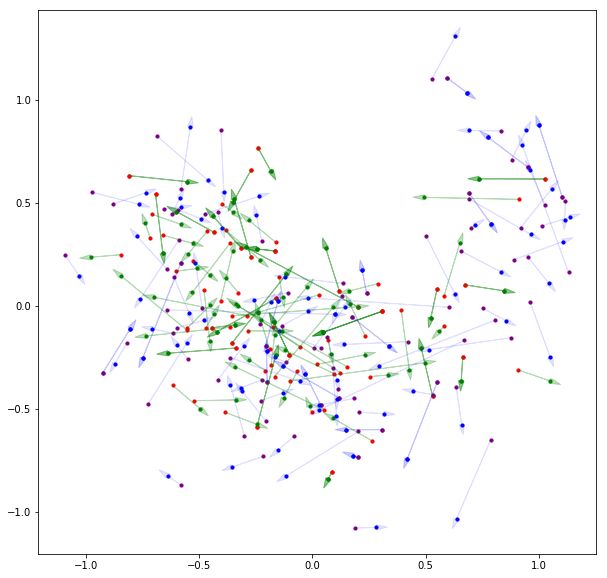

Cluster 23 (493 words)
[12.459979 54.684433]
{'en-aux': 102, 'en-cop': 100, 'fr-aux': 69, 'fr-cop': 185}
0.3664043


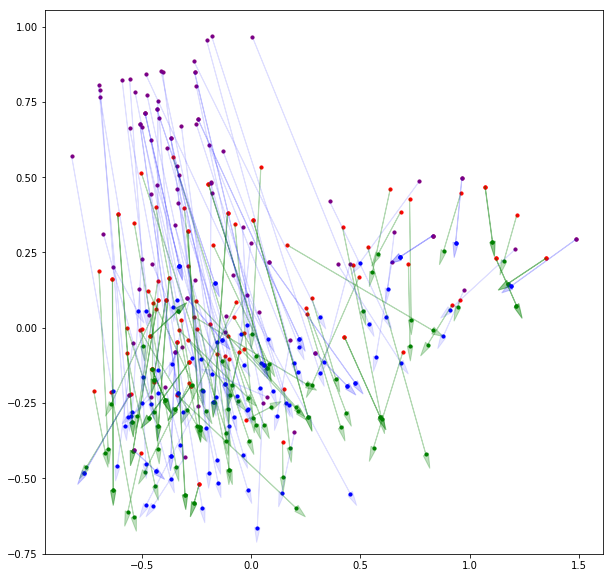

Cluster 24 (557 words)
[-23.082655  38.794167]
{'en-conj': 48, 'en-obl': 23, 'en-punct': 29, 'fr-acl': 52, 'fr-conj': 128, 'fr-nmod': 47, 'fr-obl': 54}
0.5543597


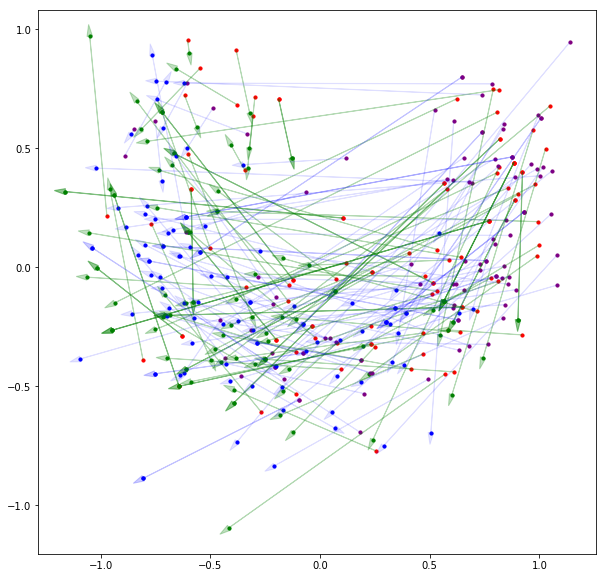

Cluster 25 (693 words)
[31.551447 23.875298]
{'en-nmod': 38, 'en-obj': 28, 'en-obl': 72, 'fr-flat': 21, 'fr-nmod': 160, 'fr-obj': 52, 'fr-obl': 195}
0.44627047


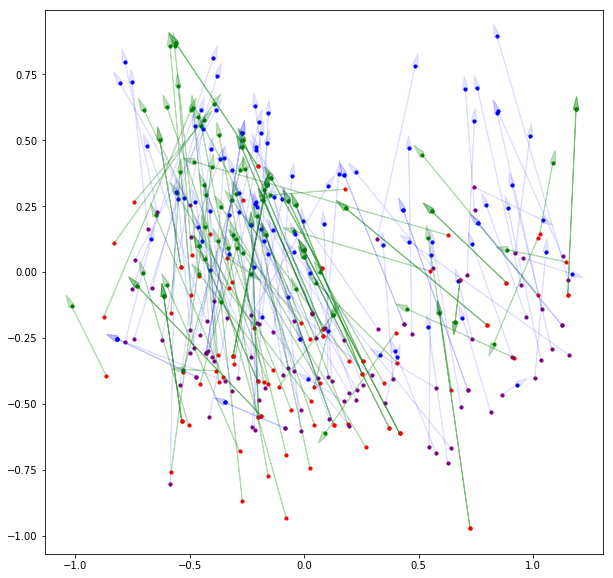

Cluster 26 (673 words)
[-31.983942  -5.978046]
{'en-advcl': 69, 'en-nsubj': 24, 'en-obl': 31, 'en-punct': 36, 'fr-advcl': 59, 'fr-advmod': 29, 'fr-nsubj': 105, 'fr-obl': 188}
0.35244715


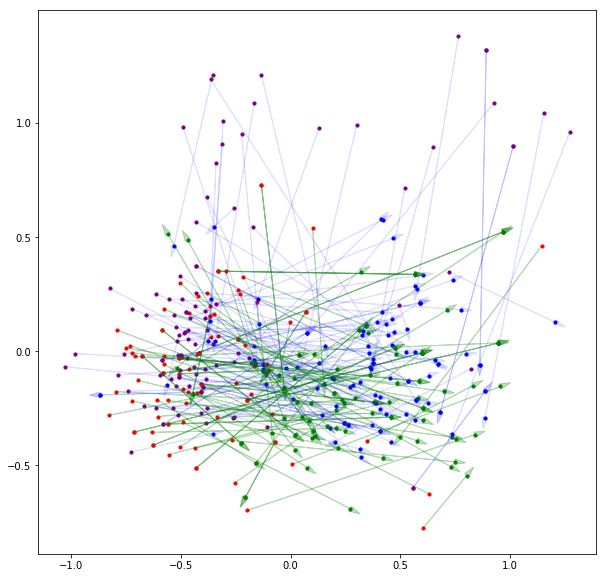

Cluster 27 (680 words)
[33.264114 -9.220588]
{'en-advmod': 77, 'en-case': 28, 'en-compound': 59, 'en-iobj': 24, 'en-obj': 154, 'en-obl': 42, 'fr-iobj': 47, 'fr-nmod': 27, 'fr-obj': 64, 'fr-obl': 41}
0.4479757


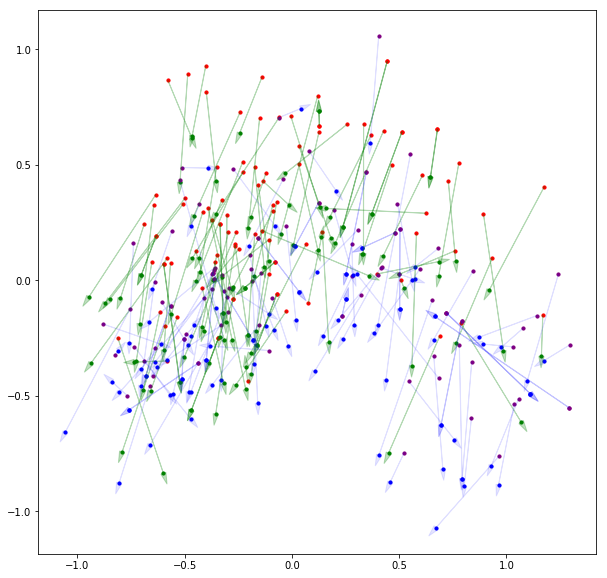

Cluster 28 (693 words)
[ -5.8502665 -17.916985 ]
{'en-advmod': 139, 'en-cc': 74, 'fr-advmod': 220, 'fr-cc': 46, 'fr-obl': 36}
0.41707122


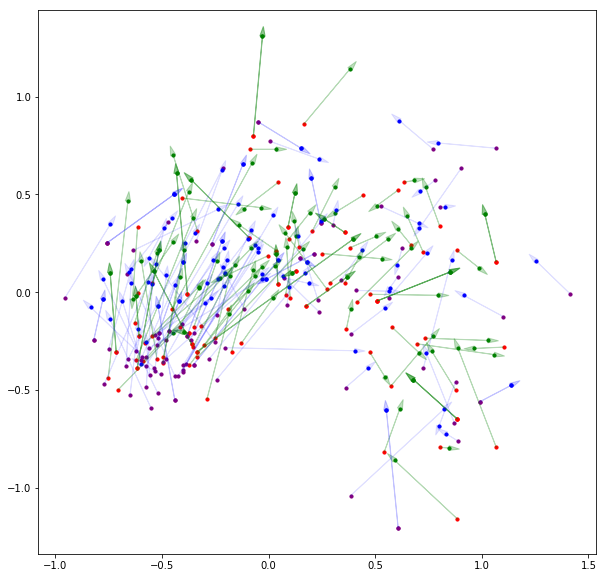

Cluster 29 (848 words)
[-16.777752  25.10187 ]
{'en-cc': 296, 'fr-cc': 335, 'fr-conj': 53, 'fr-obl': 28}
0.5895426


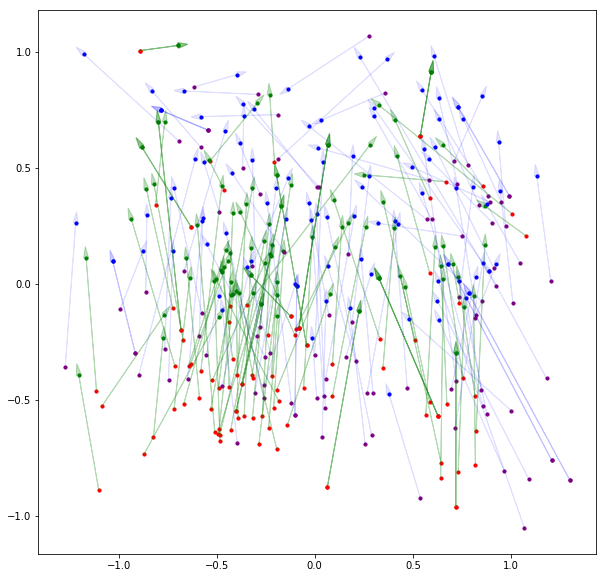

Cluster 30 (797 words)
[19.728937 -6.245812]
{'en-case': 309, 'en-mark': 36, 'en-obl': 35, 'fr-amod': 24, 'fr-case': 263, 'fr-nmod': 36, 'fr-obl': 23}
0.4742608


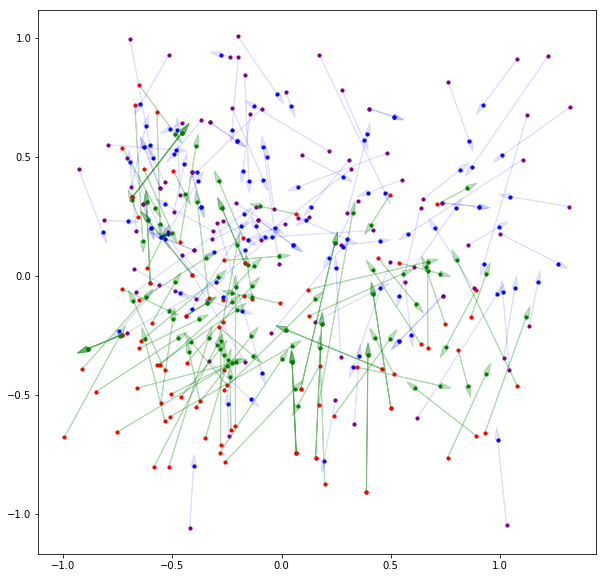

Cluster 31 (741 words)
[-28.989634 -42.181625]
{'fr-det': 682}
0.59310496


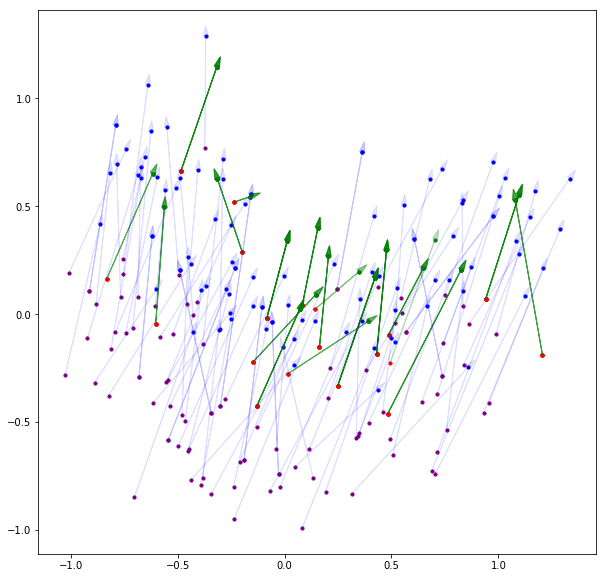

Cluster 32 (717 words)
[ 10.764223 -49.09623 ]
{'fr-case': 575, 'fr-mark': 93}
0.57457674


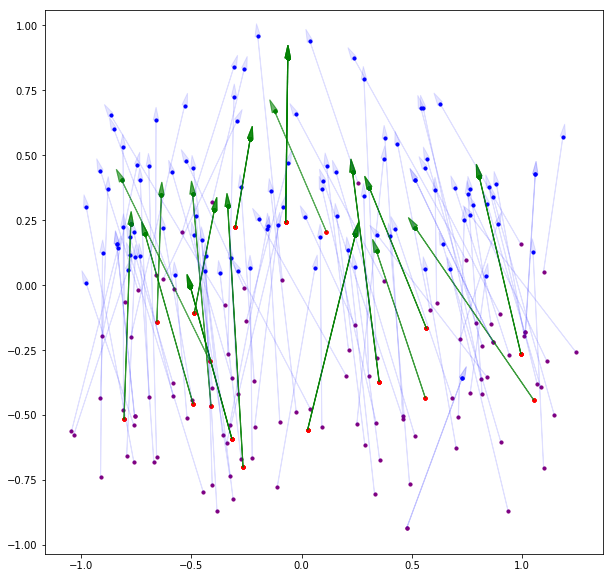

Cluster 33 (586 words)
[46.01217  17.212849]
{'en-mark': 75, 'en-nsubj': 89, 'fr-mark': 69, 'fr-nsubj': 195}
0.53631413


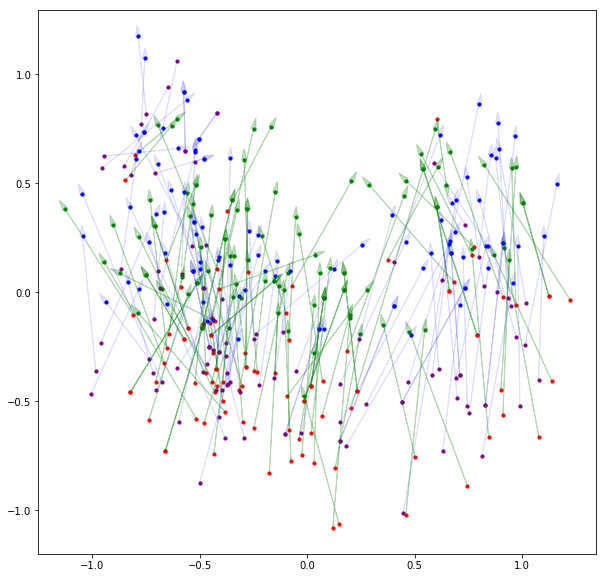

Cluster 34 (797 words)
[ -0.45407593 -28.575935  ]
{'en-case': 26, 'en-punct': 24, 'fr-acl': 22, 'fr-advmod': 113, 'fr-case': 224, 'fr-expl': 56, 'fr-mark': 109, 'fr-nsubj': 24, 'fr-obj': 55}
0.50032103


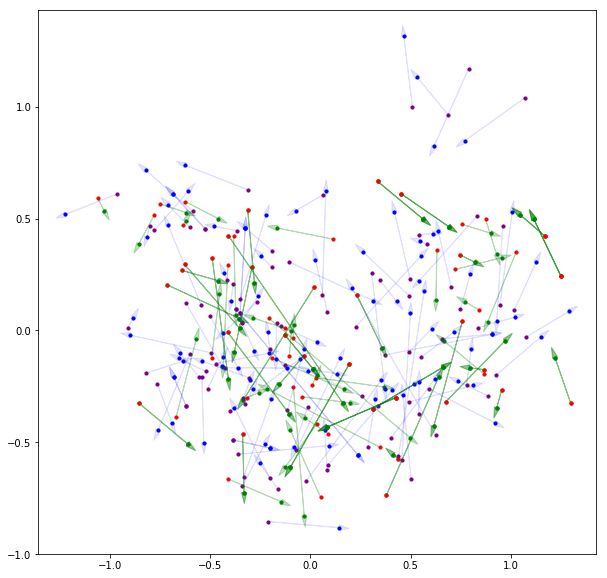

Cluster 35 (835 words)
[-3.5701241  6.9603043]
{'en-advmod': 40, 'en-case': 21, 'en-compound': 33, 'en-nmod': 41, 'en-obj': 23, 'en-obl': 38, 'en-xcomp': 23, 'fr-advmod': 21, 'fr-amod': 37, 'fr-expl': 84, 'fr-nmod': 71, 'fr-obj': 78, 'fr-obl': 80, 'fr-xcomp': 40}
0.50690335


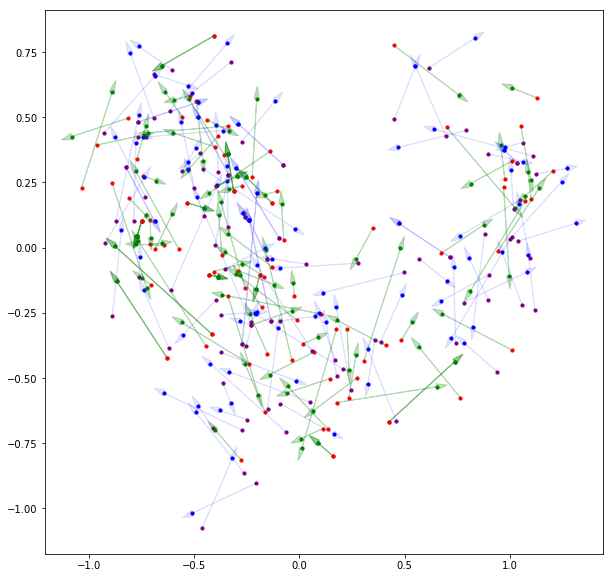

Cluster 36 (1087 words)
[ 8.201641 27.540527]
{'en-acl': 58, 'en-advcl': 32, 'en-advmod': 28, 'en-ccomp': 47, 'en-nmod': 34, 'en-obj': 65, 'en-obl': 58, 'en-xcomp': 192, 'fr-acl': 36, 'fr-nmod': 80, 'fr-obj': 55, 'fr-obl': 98, 'fr-xcomp': 130}
0.41401714


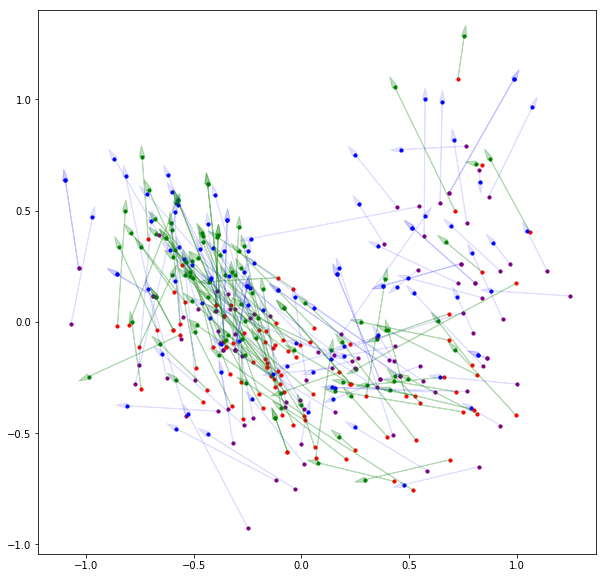

Cluster 37 (397 words)
[43.471832 -6.224034]
{'en-nsubj': 99, 'en-obj': 40, 'en-obl': 21, 'en-punct': 48, 'fr-case': 28, 'fr-punct': 77}
0.49985278


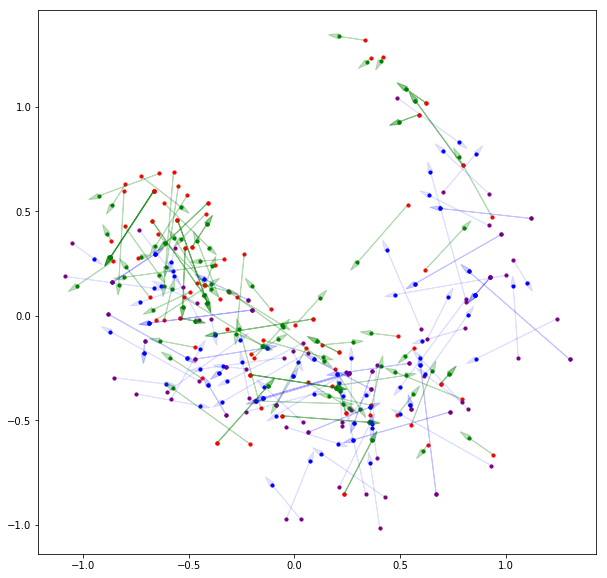

Cluster 38 (753 words)
[ 11.285109 -23.410156]
{'en-case': 39, 'fr-advmod': 23, 'fr-case': 581}
0.5802325


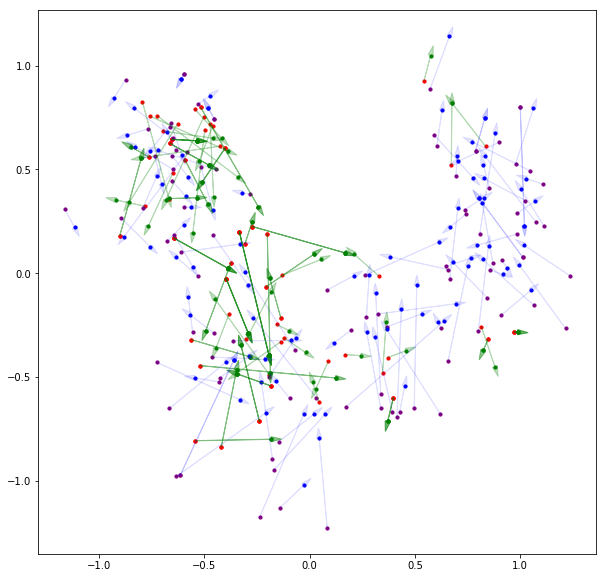

Cluster 39 (546 words)
[-37.12004   31.892706]
{'en-punct': 229, 'fr-punct': 300}
0.5920311


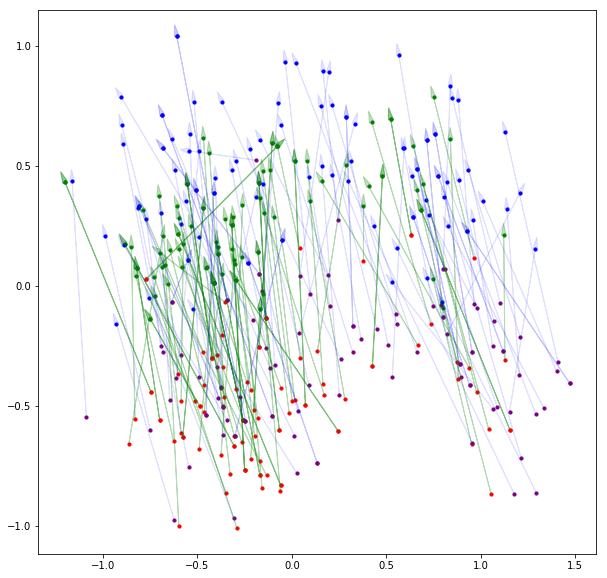

Cluster 40 (853 words)
[-32.32281  -24.643227]
{'en-det': 513, 'fr-det': 232, 'fr-nsubj': 21}
0.44246632


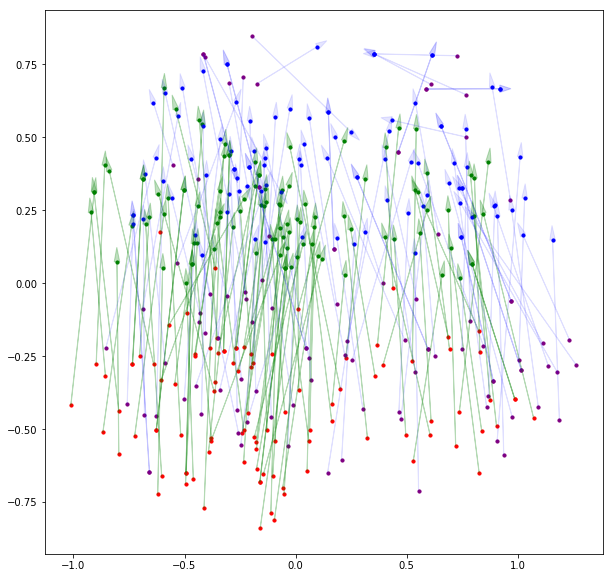

Cluster 41 (1015 words)
[ 5.593483 38.330833]
{'en-acl': 48, 'en-advcl': 70, 'en-appos': 27, 'en-ccomp': 42, 'en-conj': 139, 'en-nmod': 47, 'en-obl': 78, 'en-parataxis': 48, 'en-xcomp': 23, 'fr-acl': 37, 'fr-advcl': 30, 'fr-conj': 78, 'fr-nmod': 49, 'fr-obl': 142, 'fr-xcomp': 22}
0.33089638


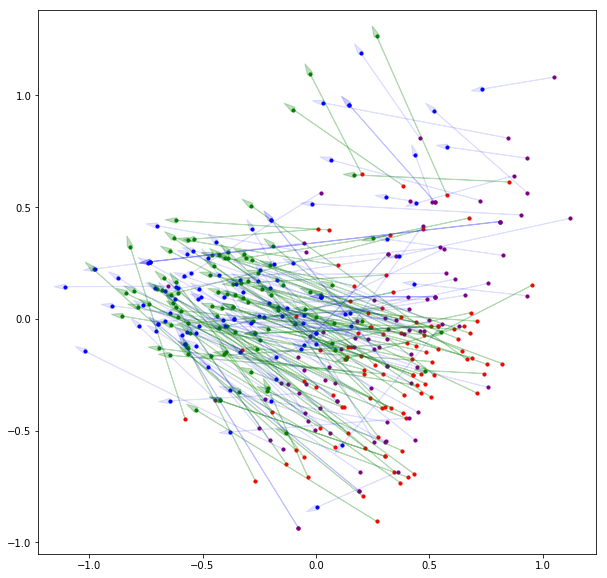

Cluster 42 (780 words)
[ 51.65325  -14.124348]
{'en-nsubj': 670, 'fr-nsubj': 68}
0.38757747


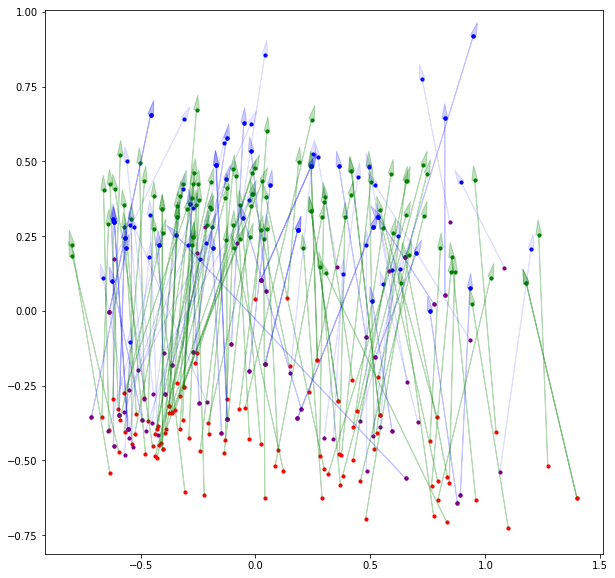

Cluster 43 (783 words)
[ -9.341565 -49.138973]
{'en-det': 143, 'fr-det': 603}
0.43392763


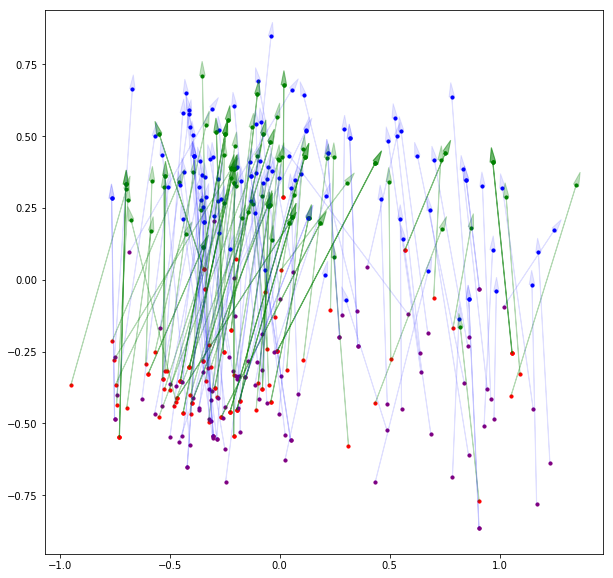

Cluster 44 (1004 words)
[-47.87081  -13.274583]
{'en-punct': 198, 'fr-punct': 775}
0.31352034


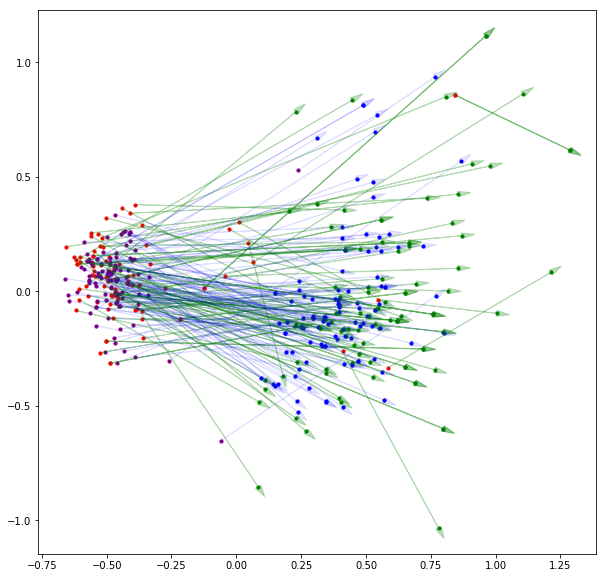

Cluster 45 (1001 words)
[-2.3772118 -5.225671 ]
{'en-advmod': 28, 'en-amod': 506, 'en-compound': 171, 'fr-advmod': 27, 'fr-amod': 126, 'fr-obl': 22}
0.4207952


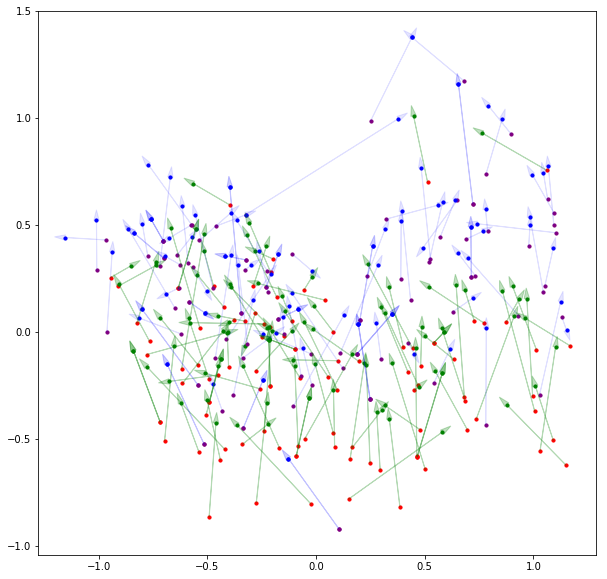

Cluster 46 (574 words)
[  2.9692   -46.464676]
{'fr-case': 437, 'fr-mark': 40}
0.5167954


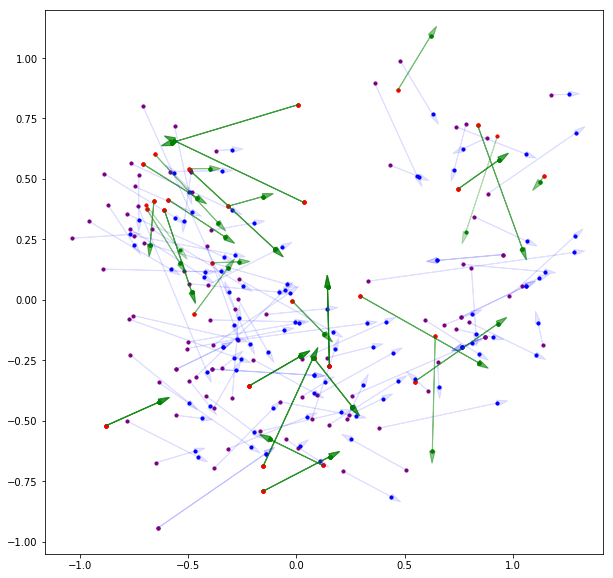

Cluster 47 (1111 words)
[12.366279 17.486397]
{'en-nmod': 83, 'en-obl': 36, 'fr-amod': 223, 'fr-appos': 21, 'fr-flat': 24, 'fr-nmod': 501, 'fr-obl': 46}
0.5203646


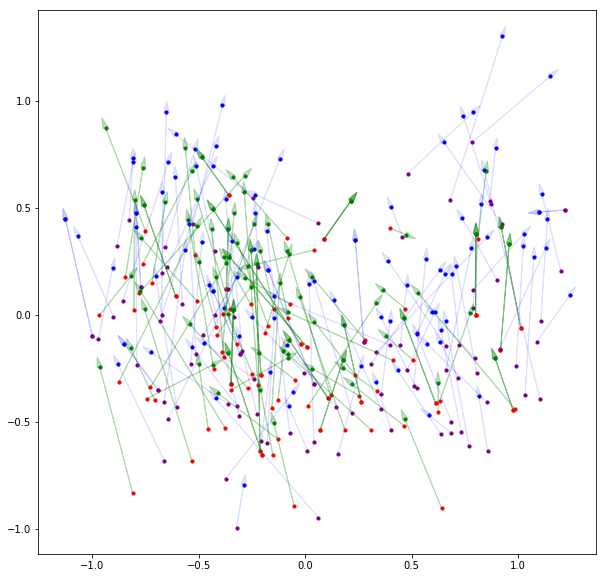

Cluster 48 (950 words)
[15.985827   6.0293097]
{'en-acl': 44, 'en-nmod': 80, 'en-obl': 37, 'fr-acl': 78, 'fr-amod': 187, 'fr-appos': 41, 'fr-nmod': 270, 'fr-obl': 64}
0.4635236


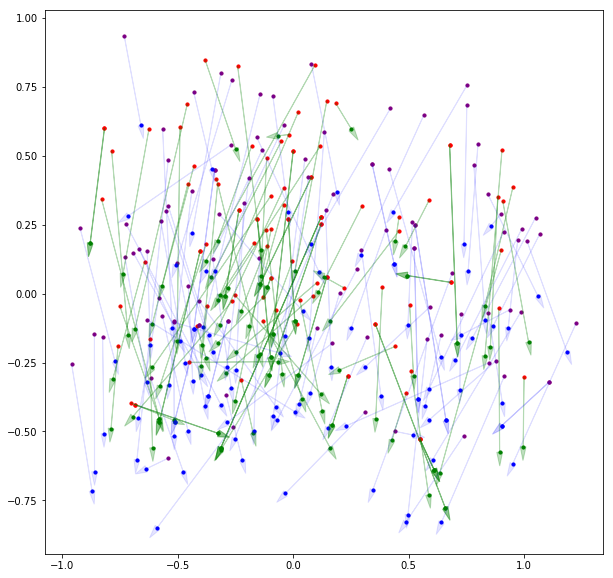

Cluster 49 (404 words)
[50.51434    3.7319293]
{'en-mark': 336}
0.5018302


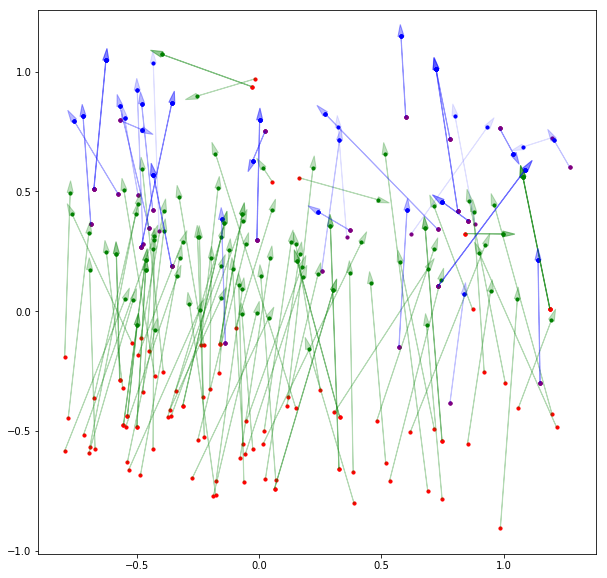

Cluster 50 (875 words)
[-32.08311    8.957169]
{'en-punct': 206, 'fr-nmod': 98, 'fr-punct': 477}
0.5645504


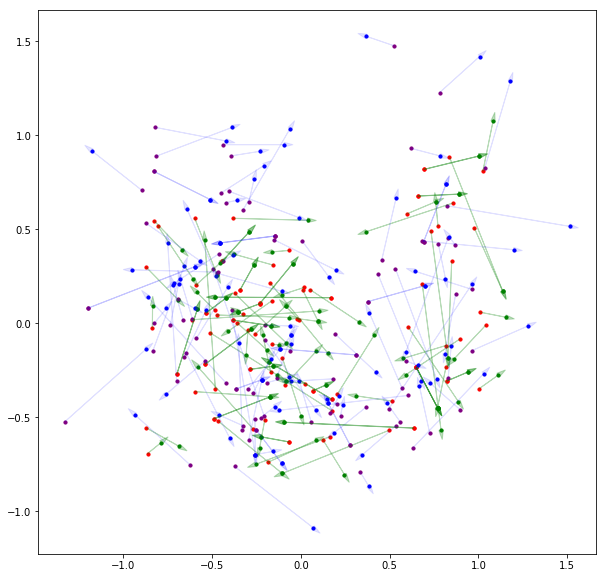

Cluster 51 (941 words)
[-17.097445 -41.584545]
{'en-det': 27, 'fr-det': 884}
0.5425113


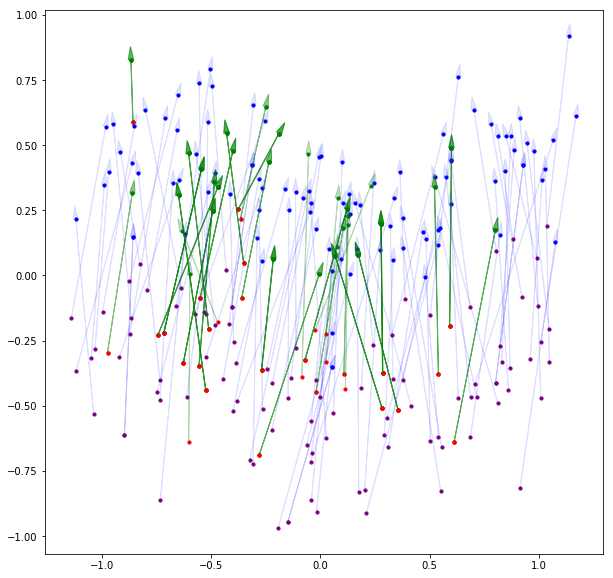

Cluster 52 (935 words)
[-38.68274   21.683191]
{'en-punct': 309, 'fr-punct': 590}
0.45525783


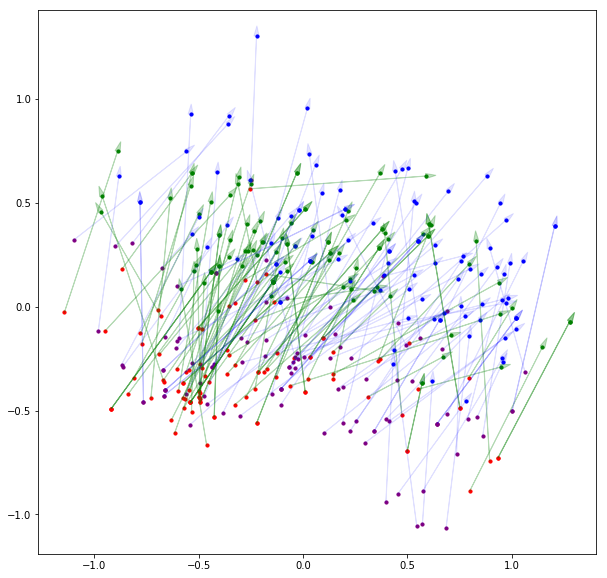

Cluster 53 (842 words)
[ 22.16939 -21.94138]
{'en-case': 280, 'fr-case': 512}
0.50134236


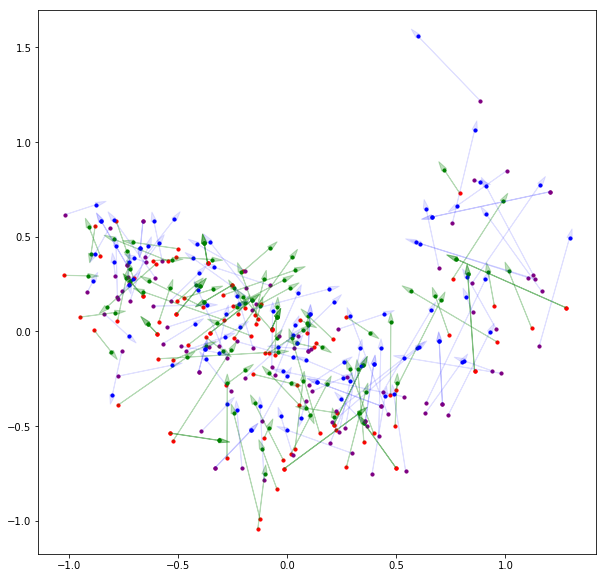

Cluster 54 (695 words)
[-9.690325 36.293198]
{'en-acl': 27, 'en-advcl': 22, 'en-conj': 68, 'en-nmod': 35, 'en-obl': 42, 'fr-acl': 43, 'fr-appos': 49, 'fr-conj': 134, 'fr-nmod': 74, 'fr-obl': 60}
0.43801796


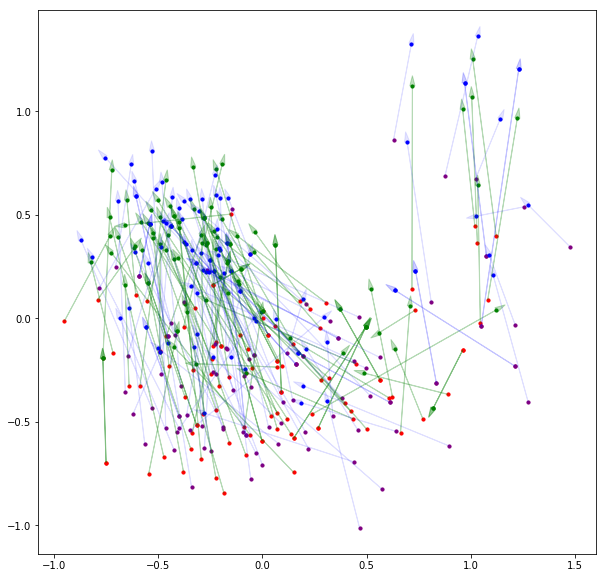

Cluster 55 (1068 words)
[20.958574 24.797384]
{'en-nmod': 51, 'en-obj': 312, 'en-obl': 76, 'fr-nmod': 156, 'fr-obj': 241, 'fr-obl': 127}
0.43254158


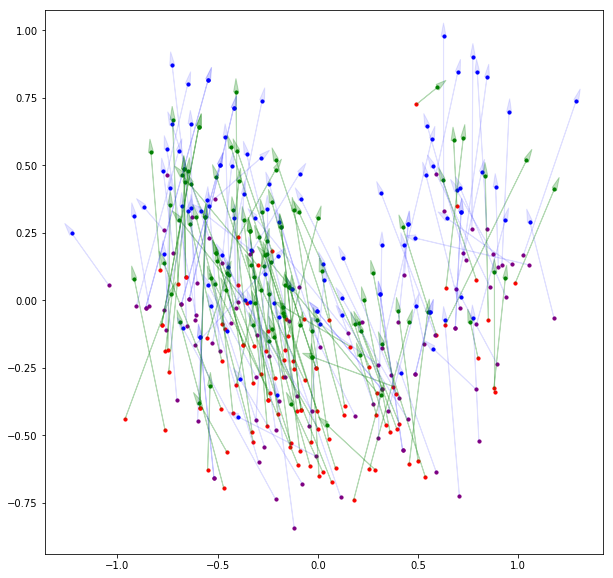

Cluster 56 (705 words)
[ 18.030819 -43.545734]
{'en-case': 292, 'fr-case': 327}
0.5389883


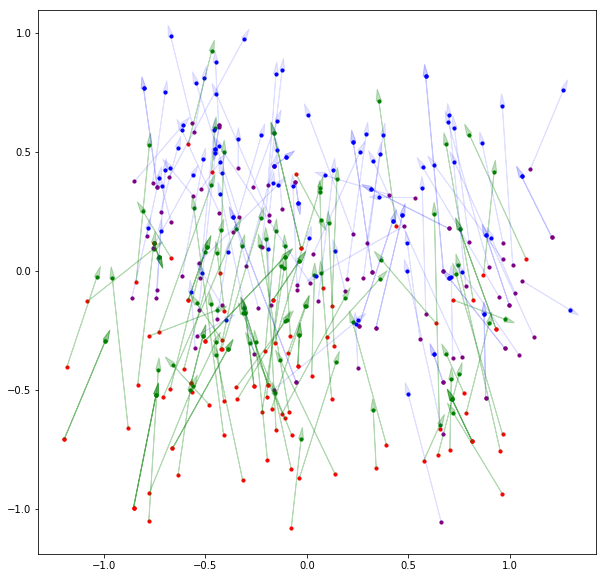

Cluster 57 (1082 words)
[-54.111126  -5.65209 ]
{'en-punct': 530, 'fr-punct': 534}
0.23142636


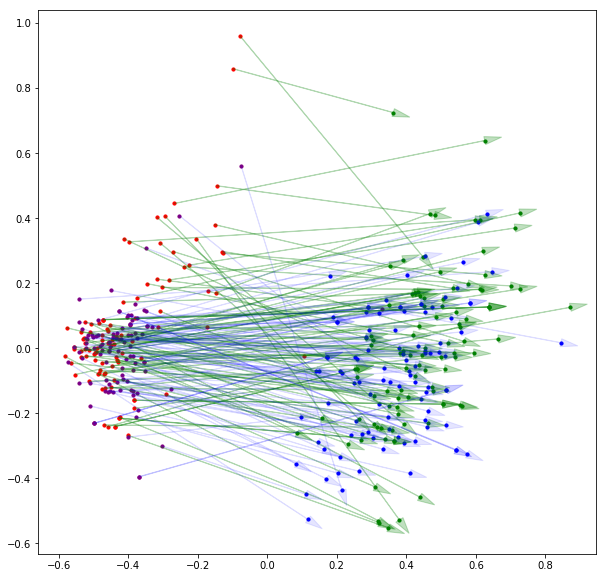

Cluster 58 (918 words)
[33.92407  41.950954]
{'en-aux': 528, 'fr-acl': 27, 'fr-aux': 285}
0.4028114


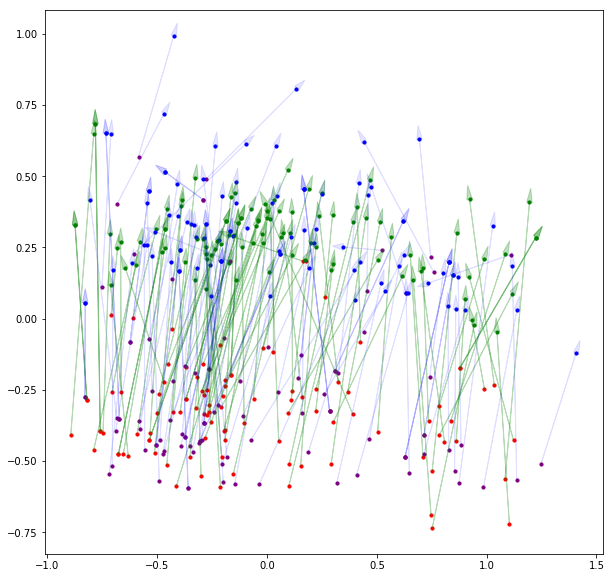

Cluster 59 (895 words)
[-9.643998 -1.630583]
{'en-amod': 335, 'fr-amod': 338, 'fr-obl': 24}
0.45407376


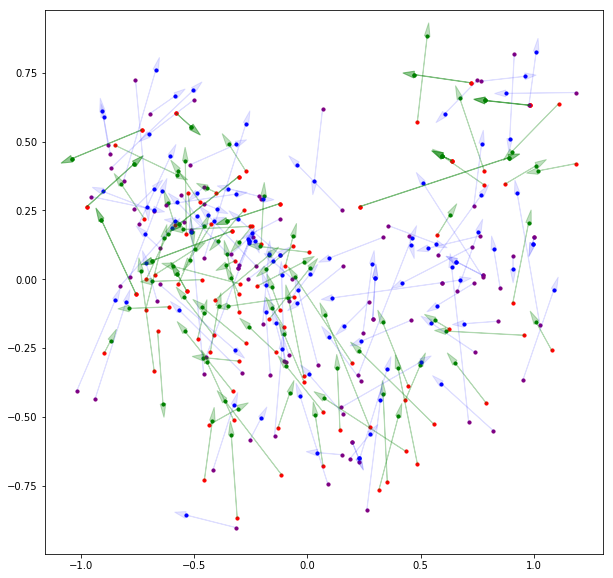

Cluster 60 (648 words)
[-23.00145    -4.8752327]
{'en-advmod': 37, 'en-nummod': 27, 'en-obl': 37, 'fr-advmod': 92, 'fr-nmod': 64, 'fr-nsubj': 62, 'fr-obl': 162}
0.46657604


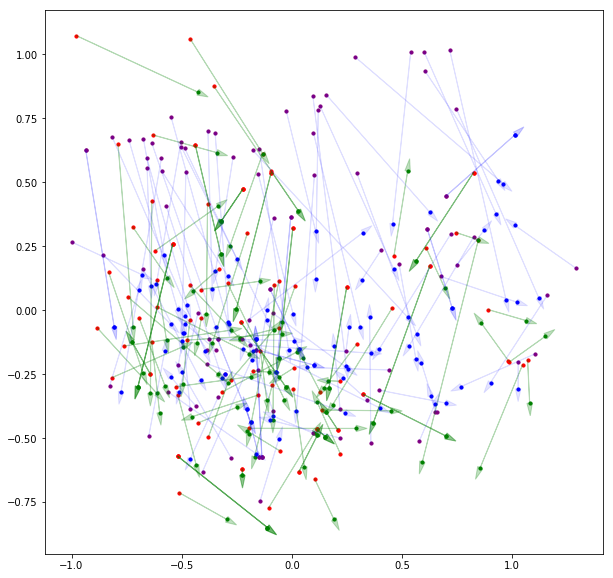

Cluster 61 (869 words)
[-14.724211  45.570217]
{'en-advcl': 36, 'en-conj': 121, 'en-parataxis': 55, 'en-punct': 30, 'fr-acl': 85, 'fr-advcl': 64, 'fr-conj': 232, 'fr-nmod': 32, 'fr-obl': 52, 'fr-parataxis': 23}
0.4888888


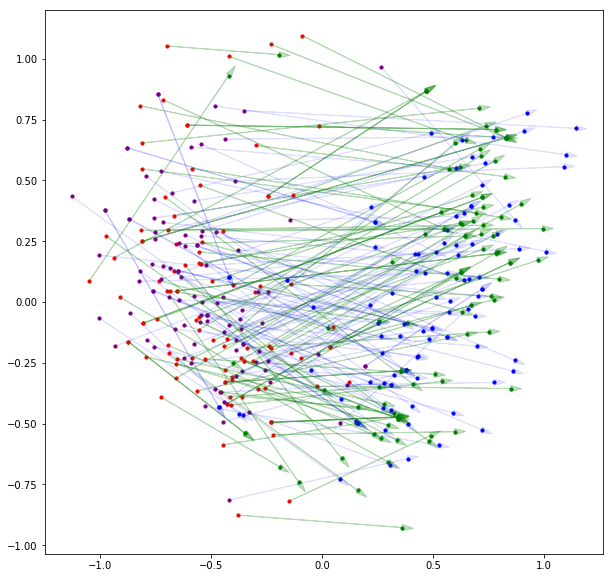

Cluster 62 (797 words)
[27.712923   3.1589928]
{'en-nmod': 37, 'en-nsubj': 257, 'fr-nmod': 80, 'fr-nsubj': 247, 'fr-obl': 57}
0.41153473


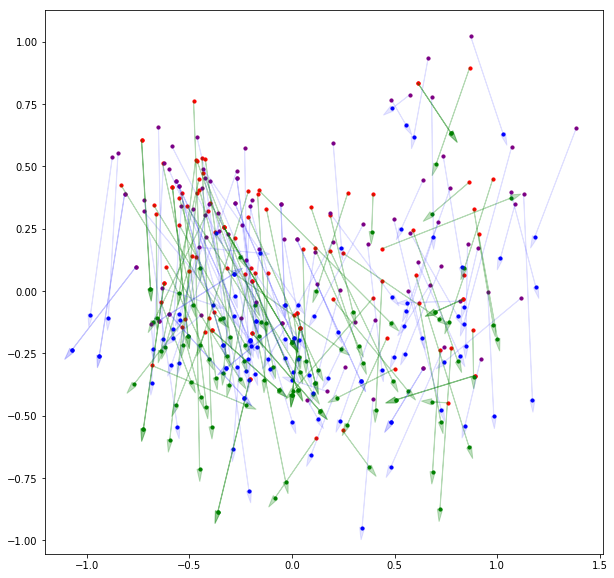

Cluster 63 (762 words)
[ 33.03406  -38.522827]
{'en-case': 47, 'en-nmod': 303, 'fr-det': 336}
0.48988494


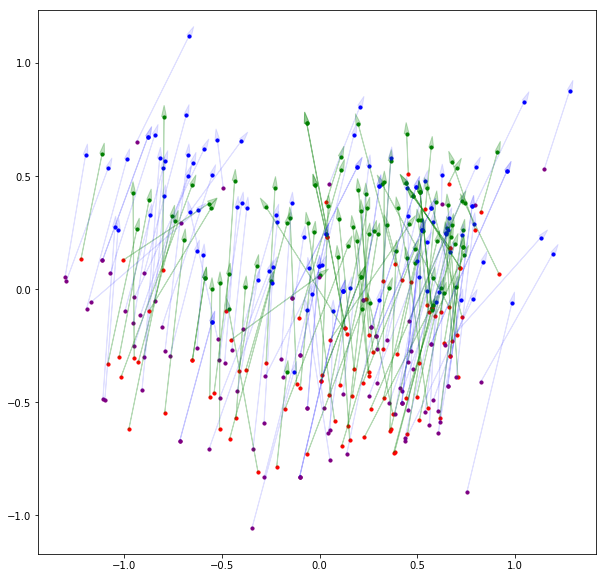

Cluster 64 (1053 words)
[-0.24956436 18.459568  ]
{'en-acl': 21, 'en-flat': 144, 'en-nmod': 31, 'fr-acl': 23, 'fr-amod': 68, 'fr-appos': 94, 'fr-flat': 360, 'fr-nmod': 106, 'fr-obl': 26}
0.4737578


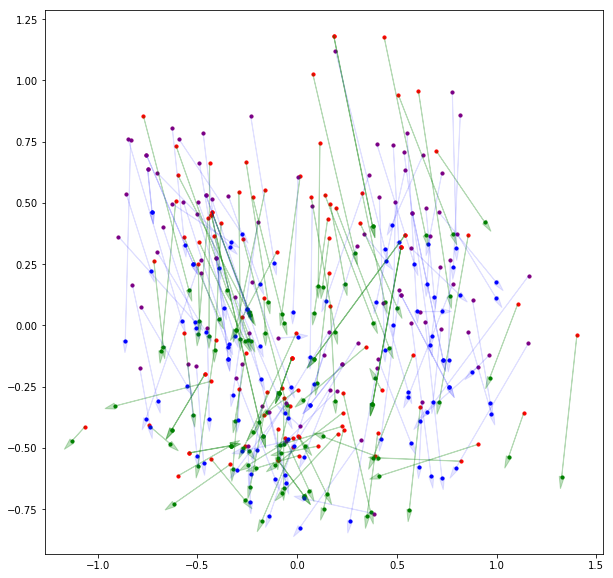

Cluster 65 (522 words)
[ 34.801937 -26.094067]
{'en-det': 132, 'en-nsubj': 29, 'fr-case': 25, 'fr-det': 160, 'fr-obl': 26}
0.54277587


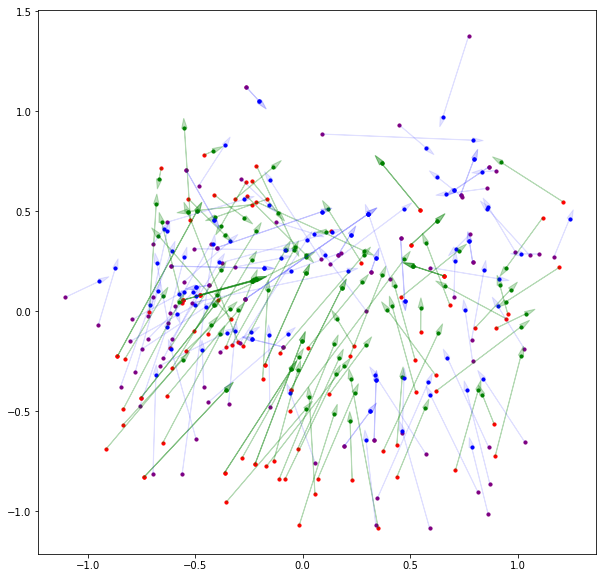

Cluster 66 (1182 words)
[ 6.300294 -1.452864]
{'en-amod': 171, 'en-compound': 574, 'en-nmod': 27, 'en-obl': 26, 'fr-amod': 23, 'fr-appos': 26, 'fr-nmod': 79, 'fr-obl': 50}
0.44351935


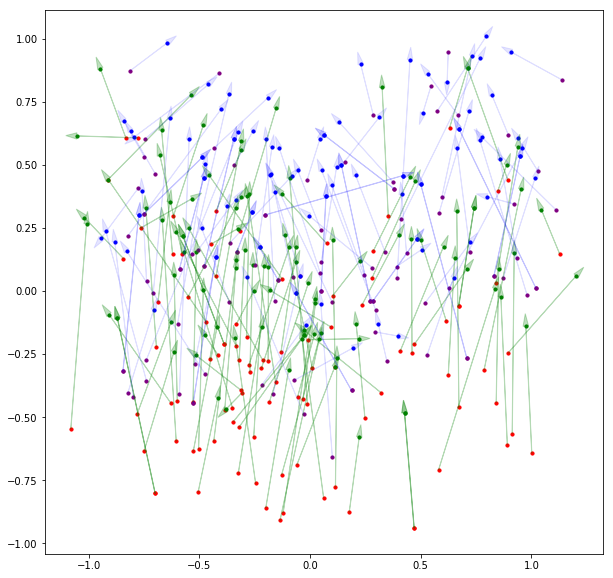

Cluster 67 (739 words)
[-18.469744   6.084393]
{'en-advmod': 25, 'en-case': 29, 'en-mark': 46, 'en-obj': 28, 'en-punct': 69, 'fr-case': 23, 'fr-fixed': 97, 'fr-mark': 102, 'fr-nmod': 29, 'fr-obl': 58}
0.46258622


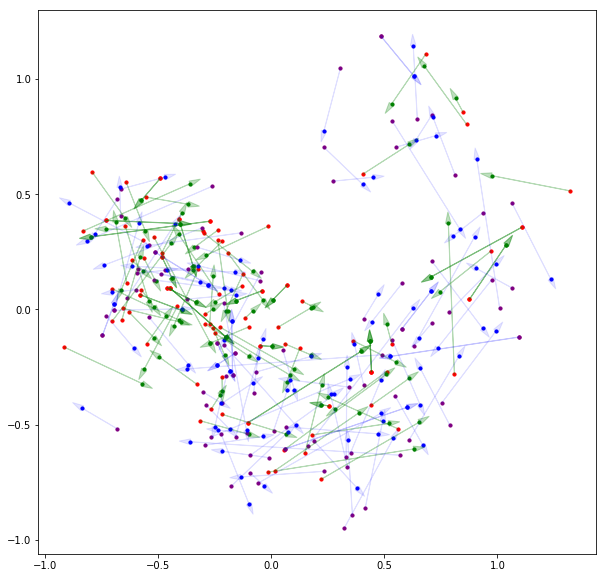

Cluster 68 (565 words)
[-13.548194 -24.925201]
{'en-advmod': 118, 'en-det': 36, 'en-nummod': 54, 'fr-advmod': 110, 'fr-nmod': 21, 'fr-nummod': 43}
0.46318865


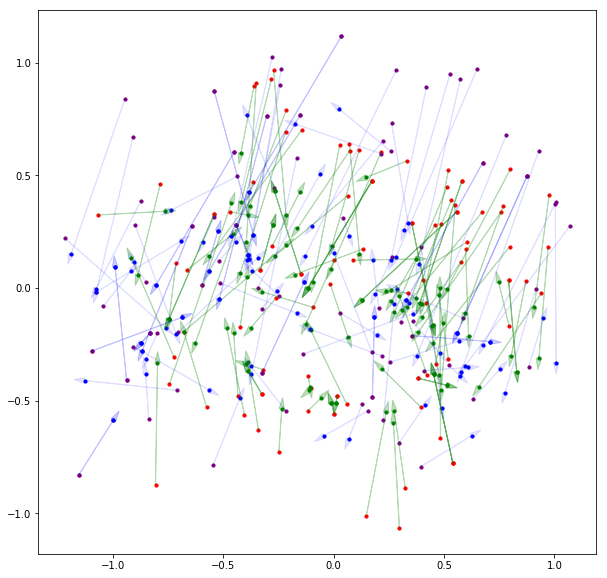

Cluster 69 (758 words)
[  3.7294855 -15.331324 ]
{'en-advmod': 77, 'en-case': 38, 'en-compound': 29, 'en-discourse': 29, 'en-mark': 133, 'en-nsubj': 29, 'en-obl': 23, 'fr-advmod': 35, 'fr-case': 109, 'fr-mark': 46, 'fr-nmod': 22, 'fr-nsubj': 21, 'fr-obl': 35}
0.40470523


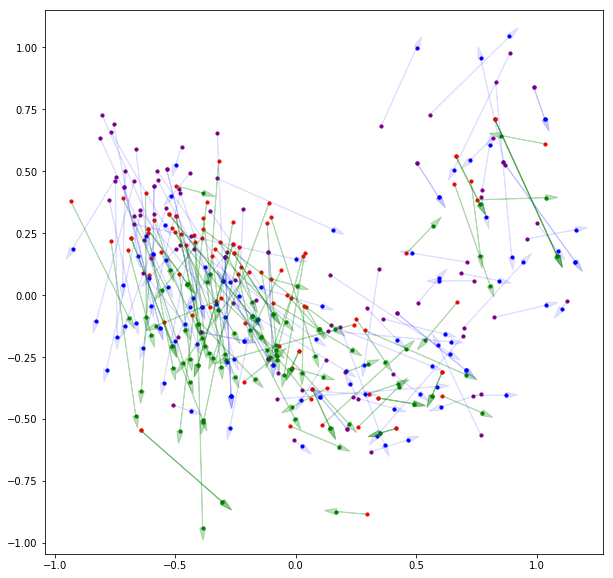

(758, 2, 2)


In [28]:
NUM_TO_DRAW = 100

for cluster in u_labels:
  word_pairs = pairs_data[kmeans.labels_ == cluster]
  print("Cluster {} ({} words)".format(cluster, word_pairs.shape[0]))
  print(kmeans.cluster_centers_[cluster])
  trimmedLabels = labels[kmeans.labels_ == cluster]
  cluster_labels, counts = np.unique(trimmedLabels, return_counts=True)
  print(dict([kv for kv in zip(cluster_labels, counts) if kv[1] > 20]))
  pca = PCA(n_components=2)
  pca_data = pca.fit_transform(word_pairs.reshape(-1, 32))
  print(np.sum(pca.explained_variance_))
  pca_data = pca_data.reshape(-1, 2, 2)
  

  plt.figure(figsize=(10, 10))

  is_src = np.vectorize(lambda x: 'en' in x)
  is_dest = np.vectorize(lambda x: 'fr' in x)

  
  to_draw_src = pca_data[is_src(trimmedLabels)]
  to_draw_dest = pca_data[is_dest(trimmedLabels)]

  indices_to_examine_src = np.random.randint(to_draw_src.shape[0], size=NUM_TO_DRAW)
  indices_to_examine_dest = np.random.randint(to_draw_dest.shape[0], size=NUM_TO_DRAW)
  
  to_draw_src = to_draw_src[indices_to_examine_src]
  to_draw_dest = to_draw_dest[indices_to_examine_dest]
  
  
  for row in to_draw_src:
    plt.arrow(row[0][0], row[0][1], row[1][0] - row[0][0], row[1][1] - row[0][1], color='green', head_width=0.025, head_length=0.05, alpha=0.25)
  for row in to_draw_dest:
    plt.arrow(row[0][0], row[0][1], row[1][0] - row[0][0], row[1][1] - row[0][1], color='blue', head_width=0.025, head_length=0.05, alpha=0.1)
  
  plt.scatter(to_draw_src[:, 0, 0], to_draw_src[:, 0, 1], c='r', label='en-subj', s=10, alpha=1)
  plt.scatter(to_draw_src[:, 1, 0], to_draw_src[:, 1, 1], c='green', label='en-verb', s=10, alpha=1)

  plt.scatter(to_draw_dest[:, 0, 0], to_draw_dest[:, 0, 1], c='purple', label='fr-subj', s=10, alpha=1)
  plt.scatter(to_draw_dest[:, 1, 0], to_draw_dest[:, 1, 1], c='blue', label='fr-verb', s=10, alpha=1)

  plt.show()
    
    
pca_data = pca_data.reshape(-1, 2, 2)

# ROW_TO_CHECK = 57
# pca_first_test = pca.transform(trimmedData[ROW_TO_CHECK][1].reshape(1, -1)).squeeze()
# assert np.allclose(pca_first_test, pca_data[ROW_TO_CHECK][1])

print(pca_data.shape)

In [33]:
kmeans_all = KMeans(n_clusters=NUM_CLUSTERS)

kmeans_all.fit(data)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=70, n_init=10, n_jobs=None, precompute_distances='auto',
    random_state=None, tol=0.0001, verbose=0)

Cluster 0 (923 words)
[ 0.10097998  0.06126521 -0.05442748  0.08219317  0.17173938 -0.06461985
  0.17280029 -0.09207122  0.10087723  0.24815719  0.06353662  0.3758232
 -0.32677805  0.0570168  -0.11068742 -0.01114148 -0.01371997  0.1787553
  0.11686568 -0.2120465  -0.00688224 -0.09267233 -0.07607552  0.09298172
 -0.01359265 -0.0552435   0.15844455 -0.05835354 -0.04883419 -0.00550619
 -0.03359028 -0.03853953]
{'en-det': 80, 'fr-case': 24, 'fr-det': 788}
0.5429248
[['President Bush on Tuesday nominated two individuals to replace retiring jurists on federal courts in the Washington area .'
  '15' 'the']
 ['there will be some girls there and then we can get them to meet up with us at that garden in the heights party later that night .'
  '21' 'the']
 ['Tammi ,' '1' ',']]
[['En géographie , le 109e méridien ouest est le méridien joignant les points de la surface de la Terre dont la longitude est égale à 109 ° ouest .'
  '20' 'la']
 ['Identifié à Shou , il porte deux hautes plumes sur la tête

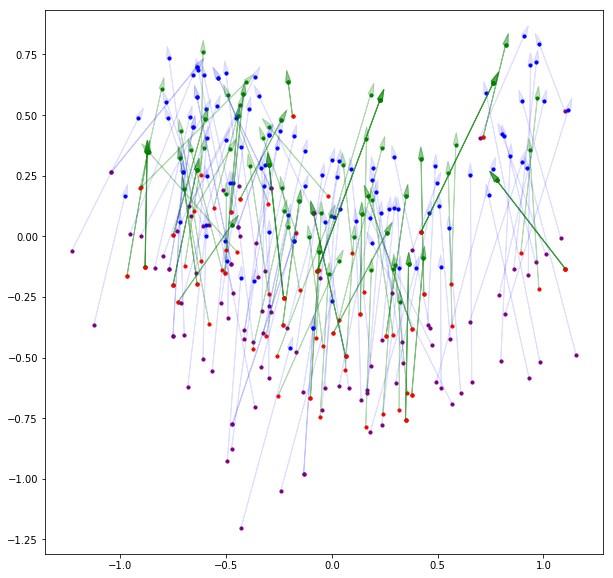

Cluster 1 (697 words)
[-1.46444812e-01  1.89642578e-01 -1.04452528e-01 -1.13411425e-02
  8.20330307e-02  9.35432836e-02 -9.41213593e-03 -7.99843483e-03
  5.00937626e-02 -2.50035077e-01  2.65262313e-02 -7.83479661e-02
  5.18979728e-02  4.91810637e-03 -1.10983692e-01  3.73404138e-02
 -4.89821061e-02 -1.07329518e-01 -1.95530578e-01 -1.08011991e-01
 -3.07302177e-01 -2.01320164e-02  2.59542882e-01 -7.48012215e-02
  1.79865689e-04 -2.92736460e-02  1.40467346e-01  9.70541313e-03
  1.21280178e-01 -8.22789669e-02  1.73681974e-01 -1.02538958e-01]
{'en-mark': 90, 'en-nsubj': 100, 'en-obj': 22, 'fr-advmod': 21, 'fr-case': 29, 'fr-mark': 84, 'fr-nmod': 22, 'fr-nsubj': 187, 'fr-obj': 21}
0.5045126
[['He has become our department expert on the PSA account ( much more knowledgeable than myself ) and the various plan provision amendments .'
  '14' 'than']
 ['But getting past who should get them , is who has them , and who is really close .'
  '3' 'who']
 ['There are a few life theories like that which 

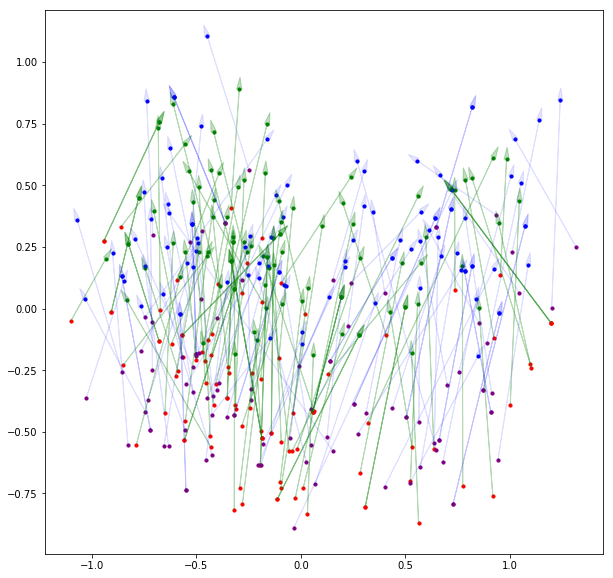

Cluster 2 (666 words)
[-0.17061052  0.0146573  -0.22593127  0.11512111  0.10078252  0.08316068
  0.09947487 -0.07122537 -0.00390533  0.04064916 -0.06725581 -0.13925499
  0.03167824 -0.03703164  0.00658784  0.10765272 -0.10481007  0.1649272
  0.01695354  0.00643922  0.02226605 -0.01681474  0.04450429  0.25955433
 -0.07091925 -0.04911054 -0.10348181 -0.15396008 -0.11454295 -0.16249931
 -0.0747364   0.11015768]
{'en-case': 36, 'en-iobj': 35, 'en-nsubj': 23, 'en-obj': 173, 'en-obl': 51, 'fr-iobj': 47, 'fr-nmod': 26, 'fr-obj': 67, 'fr-obl': 26}
0.46338606
[['You have received this BBC Breaking News Alert because you subscribed to it or , someone forwarded it to you .'
  '17' 'it']
 ['As such , we have a CPA , Larry Lewis , working with us to audit and set up transition files .'
  '13' 'us']
 ['Why not wait for him in a sexy dress with lunch or dinner , or a light snack at his house .'
  '4' 'him']]
[['Bien maîtrisé par un connaisseur de la race , il peut être un compétiteur redoutable .'
  

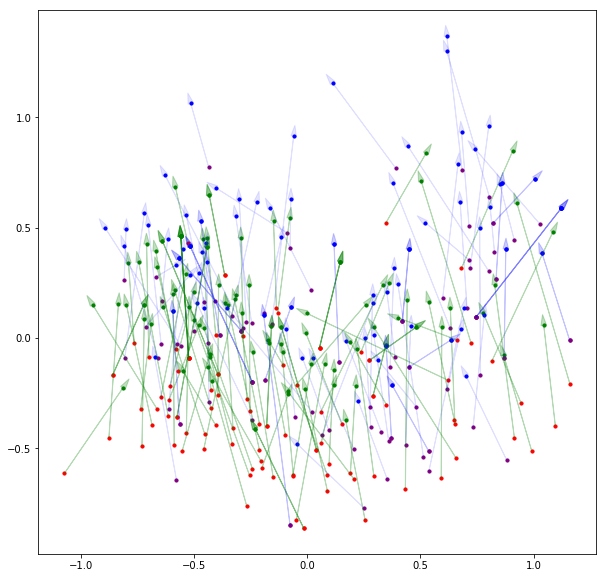

Cluster 3 (797 words)
[-0.08722125  0.03170045 -0.03601441  0.07533986 -0.00914446 -0.04415281
 -0.05977243  0.11716448  0.03675382 -0.03732817  0.11697142  0.11500413
 -0.04531235  0.0447588  -0.00455851 -0.1154715  -0.57135373 -0.03118083
 -0.16469198 -0.01857358 -0.13905595  0.07794426 -0.13588303  0.1382982
  0.16786866  0.1430934  -0.09545823  0.02357077  0.06274261  0.05250474
  0.02555681  0.15599446]
{'en-acl': 34, 'en-advcl': 50, 'en-ccomp': 28, 'en-conj': 114, 'en-nmod': 31, 'en-obl': 43, 'en-parataxis': 42, 'fr-acl': 37, 'fr-advcl': 21, 'fr-appos': 21, 'fr-conj': 100, 'fr-nmod': 32, 'fr-obl': 105}
0.33458024
[['- TEXT.htm << File : TEXT.htm >>' '3' 'File']
 ['If you have received this transmittal and / or attachments in error , please notify us immediately by reply or by telephone ( call us collect at +1 212-848-8400 ) and immediately delete this message and all its attachments .'
  '11' 'error']
 ['" Townsend , George " < gtownsend@manorisd.net >' '6'
  'gtownsend@manorisd.

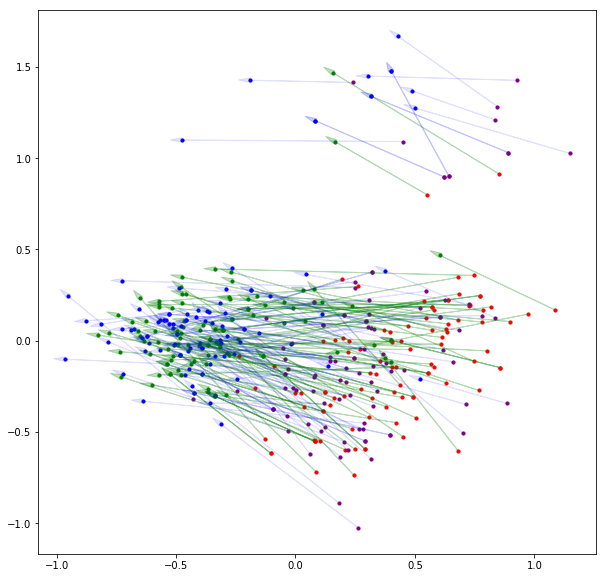

Cluster 4 (880 words)
[-0.09125301  0.01092073  0.38967457 -0.01272146 -0.09612115  0.0050283
 -0.00496377  0.08736338  0.0959092  -0.05492904 -0.0801291  -0.16994248
 -0.10642053  0.01776972  0.01349784 -0.06139804  0.01287068  0.01282157
 -0.09261103 -0.11694843  0.04665721  0.01700074 -0.04228708  0.0489574
  0.0096645  -0.09546584 -0.04508425  0.11036791 -0.07787792  0.07870662
 -0.02976742  0.01698321]
{'en-amod': 196, 'en-compound': 247, 'en-obj': 21, 'en-punct': 23, 'fr-amod': 48, 'fr-nmod': 42, 'fr-obl': 37}
0.43364787
[['They work on Wall Street , after all , so when they hear a company who\'s stated goals include " Do n\'t be evil , " they imagine a company who\'s eventually history will be " Do n\'t be profitable . "'
  '36' 'Do']
 ['He has also had to pay the £ 15 each up front so woul d be grateful if you could get the cash to him as soon as poss ible .'
  '28' 'poss']
 ['As you know , we are in the process of transferring recordkeeping services from NTRC to Hewitt .'
  '1

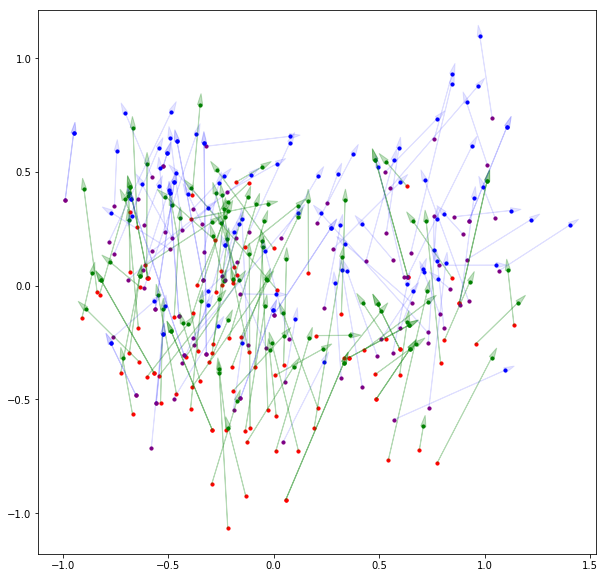

Cluster 5 (940 words)
[ 0.05861878 -0.0391947  -0.17941898  0.03078298  0.18282825  0.07137195
 -0.01773188 -0.08140416  0.04060601  0.07938179 -0.07339056  0.03540584
  0.19640684 -0.01071141  0.03075888 -0.05335205 -0.08102142 -0.02766906
  0.1003189   0.14007209  0.0251599   0.00545434 -0.11100328 -0.04985561
  0.06997434  0.09482793 -0.02326988 -0.18498042  0.11427911  0.06225075
  0.03719964  0.02683065]
{'en-case': 25, 'en-conj': 134, 'en-flat': 39, 'en-nmod': 21, 'en-nummod': 23, 'fr-advmod': 25, 'fr-amod': 50, 'fr-appos': 30, 'fr-conj': 95, 'fr-fixed': 41, 'fr-flat': 148, 'fr-nmod': 97}
0.48459476
[['Privacy in kerala , help pls ..?' '6' '..?']
 ['Radical Shiite cleric Muqtada al - Sadr said the attack was " criminal " and that " the Zionists have left only one choice for the Arabs , that of fighting and jihad " .'
  '5' '-']
 ['It would be similar to flying the flag of the Third Reich in modern day Germany or in Israel .'
  '18' 'Israel']]
[['La cathédrale du Christ Rédempteur

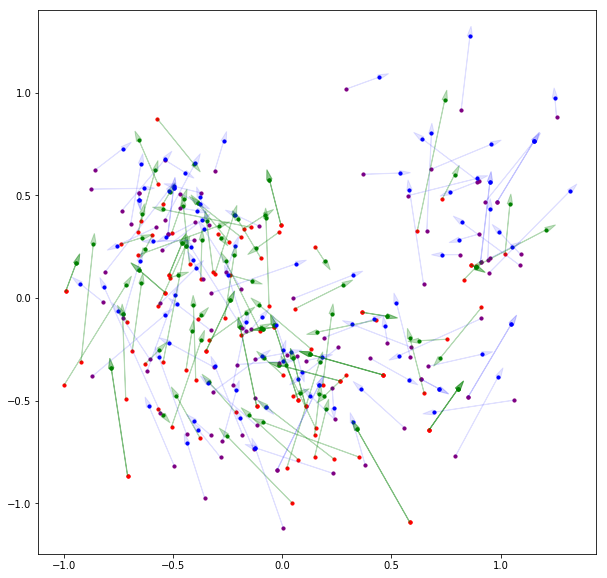

Cluster 6 (760 words)
[-0.07217352 -0.15247521 -0.04477061  0.12998529  0.00684659 -0.14128955
  0.02969747  0.05119757  0.16998015  0.09166089  0.06126336  0.31208798
 -0.1906304   0.14055692 -0.20479104  0.07216738  0.14984745  0.41297492
  0.03829769 -0.15126273  0.07744517 -0.12218402 -0.03104959  0.19432956
 -0.04754165 -0.08713396  0.12751998  0.11634327 -0.06055895  0.09222011
 -0.08739606  0.04351187]
{'fr-case': 43, 'fr-det': 655}
0.5738961
[['is gare montparnasse storage still available ?' '1' 'gare']
 ["Being a suburban teenager , I do n't really know where is cheap , safe , and close to orchestra hall ( 220 South Michigan Ave . )"
  '15' ',']
 ['He comes with everything , litter box , carrier , ect .' '11' '.']]
[["Herman ( ou Hermant ) est probablement l' aîné , né vers 1385 , puis vient Paul ( ou Polleke ou Polequinen , suivant les sources ) , en 1386 ou 1387 , et Johan ( ou Johanneke , Jacquemin , Gillequin ou encore Jehanequin ) en 1388 ."
  '7' "l'"]
 ["La cathédrale d

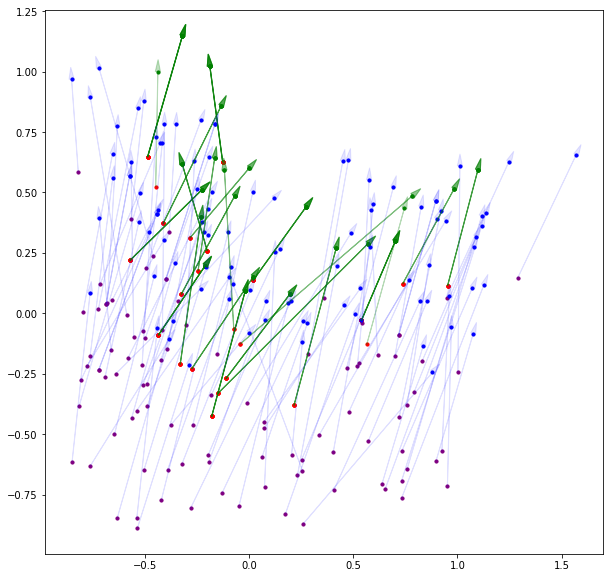

Cluster 7 (823 words)
[-0.05222042  0.27752256 -0.13954222  0.03832709 -0.00115927 -0.05079868
  0.18813665  0.03459852  0.01059217  0.15898027  0.00290729  0.09888784
  0.02589953 -0.1636273  -0.00811797  0.07429665  0.06514351 -0.07776635
 -0.20798208 -0.03456179  0.23367462  0.16051722  0.11239388  0.07427738
  0.01936256  0.2512252   0.14026085  0.05497666 -0.2646543  -0.02433799
  0.04861956 -0.07697511]
{'en-nsubj': 717, 'fr-nsubj': 52}
0.3982855
[['Heh , yep , I like to wear silk chemises , panties even stockings with garter belt .'
  '4' 'I']
 ['Attached is a new link for employees unable to attend the all - employee meeting today at 10 a.m. ( CDT ) at the Hyatt Regency Houston , Imperial Ballroom .'
  '20' 'CDT']
 ['P.S. I am moving back to Calgary in about a month .' '1' 'I']]
[['Je confirme que cette clinique est très recommandable .' '0' 'Je']
 ['Vous vouliez visiter le Mont Rushmore et vous vous êtes égarés ? ...'
  '7' 'vous']
 ["Le 24 octobre 2005 , George W. Bush a nomm

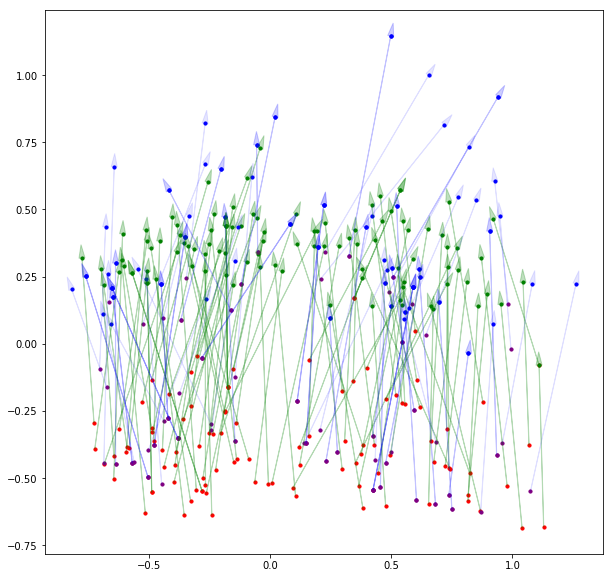

Cluster 8 (504 words)
[-0.01282482 -0.18054244 -0.03396947 -0.10017958  0.01894022 -0.00800728
 -0.03271912 -0.03385301  0.05575182 -0.07694232 -0.06999722  0.12062719
 -0.04996362  0.0350642   0.28361788  0.02776507 -0.01204179  0.05166726
 -0.12135027 -0.11408944 -0.12952489 -0.0431773   0.2083129  -0.07807223
  0.11096164  0.10872521 -0.11188921  0.10915834 -0.13322692 -0.02137213
  0.1699229  -0.07665538]
{'en-det': 137, 'en-nsubj': 25, 'fr-det': 167, 'fr-obl': 35}
0.51329
[['" And so we sang this hymn -- this is a long story trying to get to your answer .'
  '8' 'this']
 ['In addition , I received feedback from our Gas Desk that the access to the Gas segment of Enron On - Line was cut off to CPS --- do you know who would handle this at Enron that we can speak to ?'
  '34' 'this']
 ['If you are new to " The Cat Album " I can tell you that you \'ll find more than 1100 pictures of cute cats at this site .'
  '26' 'this']]
[["Afin de ménager encore l' Empire ottoman , la Conférence de

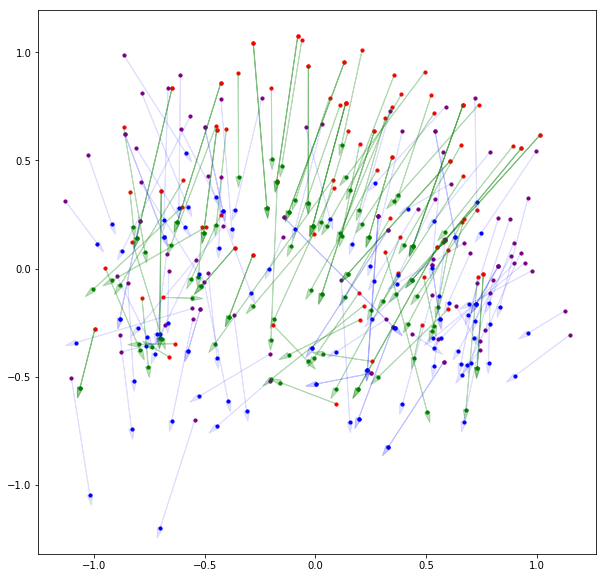

Cluster 9 (1015 words)
[ 0.11985452  0.26281407  0.0004095   0.30629876  0.20315465 -0.10032077
  0.08969998  0.19261082 -0.01511816  0.19236477  0.09823472  0.04171093
  0.10306585  0.06914969 -0.13093626 -0.15657434  0.02712782  0.213667
  0.06787931 -0.06431413 -0.01044211 -0.12460224 -0.10301235  0.02294745
 -0.00264041  0.01904792  0.01222889  0.01308586 -0.18661186  0.0733424
  0.01925432 -0.2541621 ]
{'fr-case': 765, 'fr-det': 27, 'fr-mark': 112}
0.5620949
[['" But it seems that Hamas has its own political agenda . "' '12' '"']
 ['Analyst Team 1 : Coach : Lisa Gilette' '2' '1']
 ['Bush also nominated A. Noel Anketell Kramer for a 15 - year term as associate judge of the District of Columbia Court of Appeals , replacing John Montague Steadman .'
  '22' 'of']]
[["Il dénonce Robert McNamara comme étant l' homme qui a permis de transformer la Banque mondiale en un moyen d' asservissement du tiers monde à l' empire global ."
  '11' 'de']
 ["Ainsi , il conviendra de regarder le second

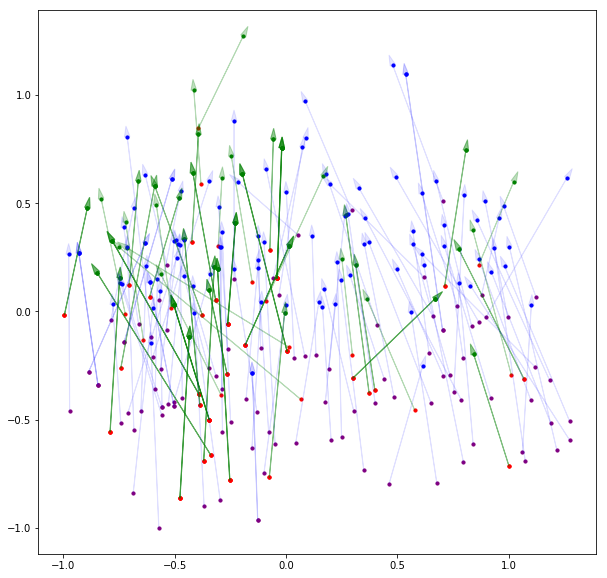

Cluster 10 (693 words)
[ 0.12201601  0.2295307  -0.03633015  0.23054741  0.28885177  0.07410967
  0.02611868  0.00105564 -0.00392095  0.09128241  0.10254656 -0.18473999
  0.01615335  0.11160819  0.02839438 -0.12400607 -0.12094217  0.12932402
 -0.08061296 -0.08533254  0.12793545 -0.11027764 -0.00681492  0.01169586
  0.13817725 -0.0445285  -0.1232745  -0.11812144 -0.11118416 -0.1310429
  0.03925418 -0.3578954 ]
{'en-case': 274, 'fr-case': 256, 'fr-nmod': 25}
0.5384626
[["While there have been spasms of speculation about the Bush administration naming a replacement for O'Keefe , no nominee has been declared ."
  '5' 'of']
 ['1 cup of empanadas' '2' 'of']
 ["He 's been away for a week and I was thinking of waiting for him in his apartment wearing only his dress shirt ."
  '11' 'of']]
[["A noter que deux ateliers seront organisés à l' occasion de la conférence d' Alger ."
  '13' "d'"]
 ['Rilly-sur-Loire est une commune française , située dans le département de Loir-et-Cher et la région Cent

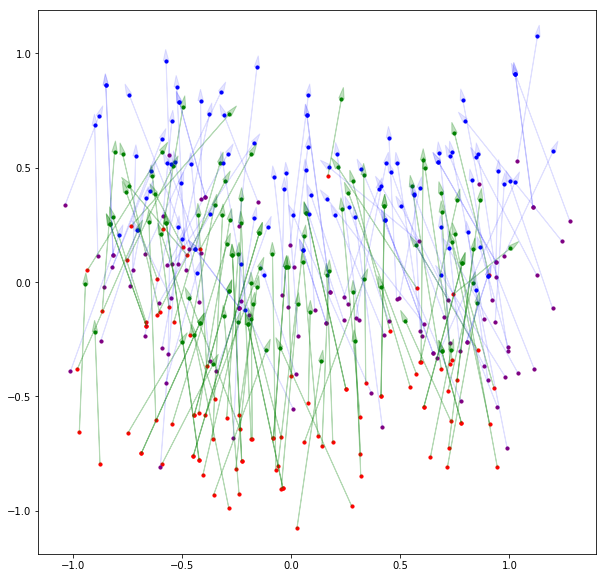

Cluster 11 (716 words)
[ 0.12131615 -0.10911698 -0.09191342 -0.08709405 -0.03158395  0.15343082
 -0.03671102  0.23721567 -0.15899728  0.02442534 -0.11327518 -0.10665929
  0.08371627 -0.158656    0.02222868  0.03317809 -0.08287098 -0.0620072
  0.12876998  0.13132529 -0.14258361 -0.14664482 -0.07246428 -0.15425116
  0.18548474  0.06322033 -0.00608169 -0.14560644  0.0711121   0.10493591
  0.087313    0.08144457]
{'en-flat': 130, 'fr-amod': 45, 'fr-appos': 30, 'fr-flat': 342, 'fr-nmod': 54}
0.49200034
[['Kristen Quinn , Sarah Mulholland , Samuel Pak , Daniel Kang' '4'
  'Mulholland']
 ['Interim Palestinian leader and the front - runner in the upcoming Jan. 9 , 2005 presidential election Mahmoud Abbas talks during his first official campaign speech in the West Bank town of Ramallah , Saturday Dec. 25 , 2004 .'
  '18' 'Abbas']
 ['Dr. Dorn is his backup .' '1' 'Dorn']]
[["Ce vallon est bordé au nord par le pic Saint-André ( 2857 mètres ) et le pic de Chabrières ( 2746 m ) , à l' est par le pi

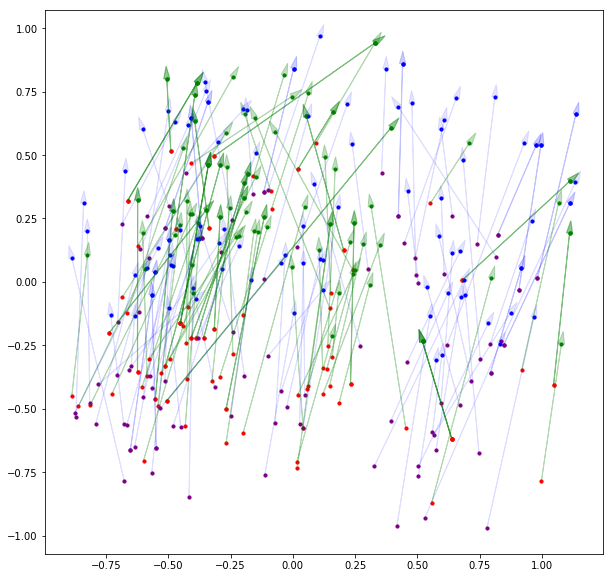

Cluster 12 (471 words)
[ 0.14597945  0.00576096  0.02340871 -0.17136054  0.07264952  0.03481805
  0.00143992  0.15553412  0.05459932 -0.16762823 -0.0040541   0.16049556
  0.19848847  0.01347959  0.11506095 -0.04254349  0.04262552  0.14513251
  0.1979173  -0.08460872  0.05022084  0.0407552  -0.06435563  0.07918694
  0.05197315  0.3519192  -0.10522265  0.04053445  0.043276   -0.11345001
  0.04687782 -0.36669335]
{'en-obl': 39, 'fr-nmod': 79, 'fr-obl': 247}
0.46282473
[['The broker called back shortly after I spoke to you to let me know that the kestrel air park building and the strip center at fm78 & walzem had both sold .'
  '4' 'shortly']
 ['Crap like this sure makes me want to rush right out and rescue people from dilemmas of their own making .'
  '2' 'this']
 ['Posted by Hidden Nook to Hidden Nook at 3/9/2005 11:16:00 PM' '8'
  '3/9/2005']]
[['En 1995 , il défendra 29.000 employées de Boeing réunis en procédure en nom collectif ( " class action " ) contre leur employeur pour discrimi

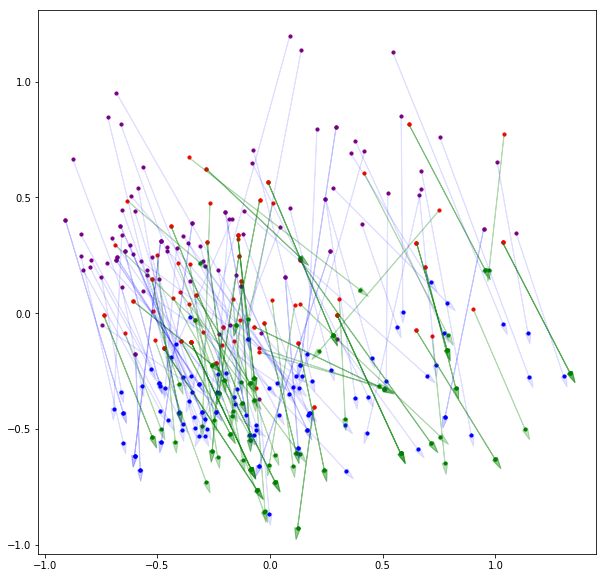

Cluster 13 (831 words)
[ 0.11293787 -0.12317219 -0.05881992 -0.10199402  0.05062184 -0.00729799
  0.26543728  0.01765744 -0.02604301  0.01803334  0.08384712  0.18998194
 -0.03737845 -0.11102691 -0.01952387 -0.20186287  0.0068163   0.01790046
  0.09908558  0.14019656 -0.13442835 -0.18316218  0.03325224 -0.01672013
  0.10968838 -0.06152951  0.2833956   0.14284578 -0.29843858 -0.05168102
  0.0743569   0.0528532 ]
{'en-det': 510, 'fr-det': 252, 'fr-nummod': 21}
0.43972808
[["Personally , I do n't find a travel agent to be of value to me as I am willing to put in the time doing research on the internet ."
  '6' 'a']
 ['In an apparently unrelated incidents , some eleven Iraqis were killed by snipers on Tuesday , including a group of police trainees in a bus near Hilla and two police in Kirkuk .'
  '17' 'a']
 ['Please find attached a credit worksheet for a Master Firm contract for the above mentioned counterparty .'
  '7' 'a']]
[["Le constructeur stoppe sa construction après 12 marches ou dès

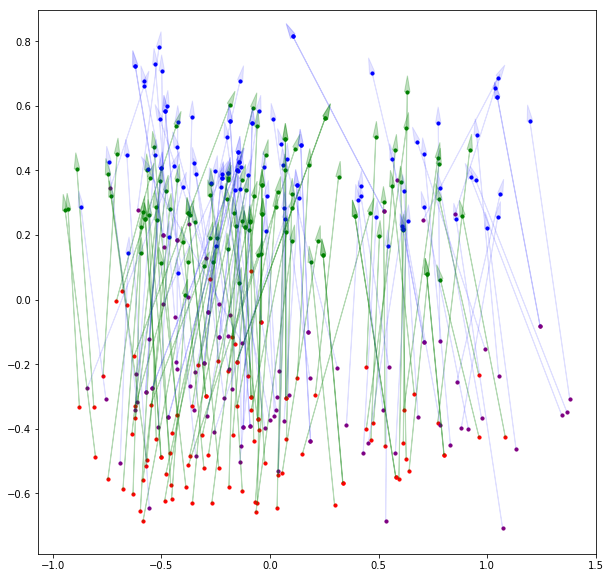

Cluster 14 (943 words)
[-0.19525182 -0.00337993 -0.04072411 -0.1975674  -0.01525675  0.02154231
 -0.0567175   0.00750322  0.11326094  0.09578897 -0.03723089  0.02343985
 -0.07025449  0.0361543  -0.03001271 -0.00365858  0.04622563  0.01835786
  0.04468562  0.18620707 -0.10163911 -0.0466554  -0.02330795  0.1554129
 -0.08421516  0.05928513 -0.06563786  0.01326589 -0.10458501 -0.17155062
 -0.05404906 -0.15661152]
{'en-advmod': 154, 'en-amod': 72, 'en-compound': 27, 'en-det': 79, 'en-nsubj': 30, 'fr-advmod': 169, 'fr-amod': 76, 'fr-case': 28, 'fr-det': 45, 'fr-nummod': 45, 'fr-obl': 22}
0.4148476
[['Brian has been one of the most crucial elements to the success of Mozilla software over the past few years , ...'
  '18' 'few']
 ["I really have n't thought about writing a book ." '5' 'about']
 ['Erm ya How can I watch Fair City Online in England lols ?' '2' 'How']]
[['Il étudie notamment à Rennes dans le cadre du programme School Year Abroad et effectue également un stage chez Renault .'
  '2'

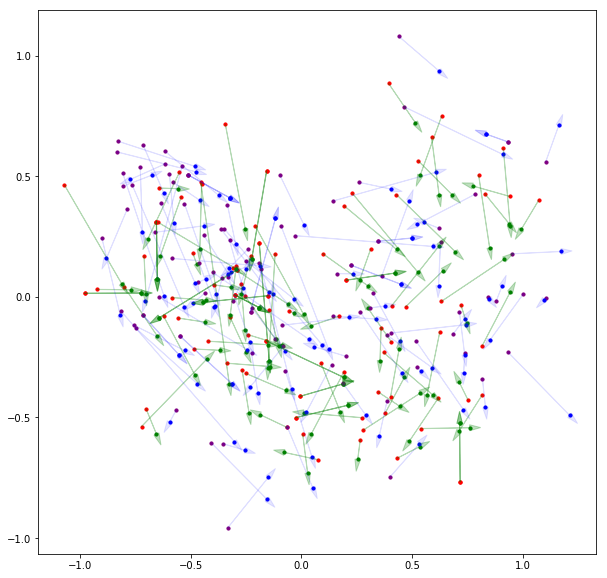

Cluster 15 (1164 words)
[-0.15379874  0.00250399  0.0975816  -0.30457604 -0.27519143 -0.00376708
 -0.09375548  0.03314959  0.27091077  0.01826034 -0.07774034 -0.04177109
  0.08570524  0.04553942  0.10927086  0.06918473 -0.01918316 -0.01766749
 -0.05760471  0.0219423   0.02272046 -0.06670156  0.03762788  0.12786005
  0.0599806  -0.02281301 -0.07983238 -0.00076304  0.03401358  0.1104629
 -0.03203981 -0.11089722]
{'en-advmod': 44, 'en-amod': 564, 'en-compound': 31, 'fr-advmod': 57, 'fr-amod': 336, 'fr-obl': 33}
0.43996435
[['But thankfully there are other flowers shops around Norman .' '4'
  'other']
 ['As such , we will distribute net shares calculating the proper withholding at fair market value the day prior to notifying the transfer agent .'
  '10' 'proper']
 ['The complaint , filed with the United States Department of Housing and Urban Development , accuses HANO of violating a 2003 enforcement agreement entered into between former St. Thomas Housing Development residents , the City o

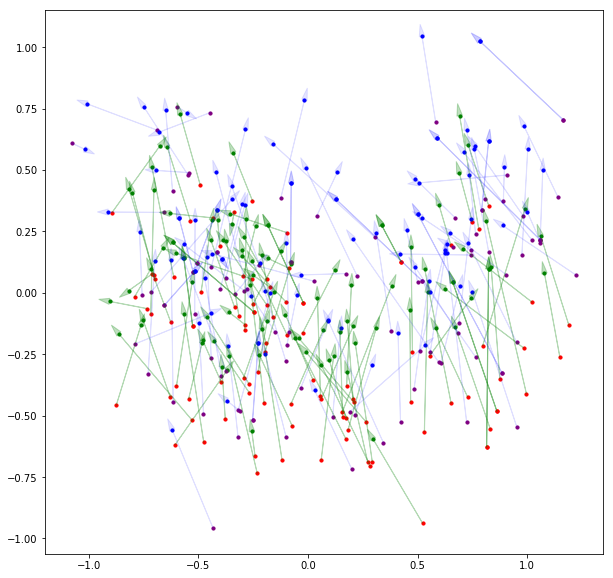

Cluster 16 (527 words)
[ 0.0236996  -0.06361485 -0.03196881  0.01106036  0.03075853 -0.15843867
 -0.12273719 -0.20611142  0.08950657 -0.17990293  0.16761367 -0.05804086
  0.04193257 -0.2757769  -0.1227677  -0.20349382  0.10920659  0.11390442
  0.11055753 -0.02934046  0.07352682 -0.01228216 -0.09142992  0.18345954
 -0.01446671 -0.10189411 -0.1304687   0.14763738  0.01266278  0.16026169
 -0.02888714 -0.0279546 ]
{'en-aux': 406}
0.4026112
[["Being a suburban teenager , I do n't really know where is cheap , safe , and close to orchestra hall ( 220 South Michigan Ave . )"
  '6' 'do']
 ['How much better does it get ?!' '3' 'does']
 ['Amazingly , these idiots think a cartoon of Mohammed is comparable to what we can expect in this new fun contest :'
  '14' 'can']]
[['En 2008 , Falleron comptait ( soit une augmentation de 28 % par rapport à 1999 ) .'
  '11' '%']
 ['Le baron zu Guttenberg , 39 ans , le plus populaire des ministres de la chancelière Angela Merkel , obtient un indice de satisfacti

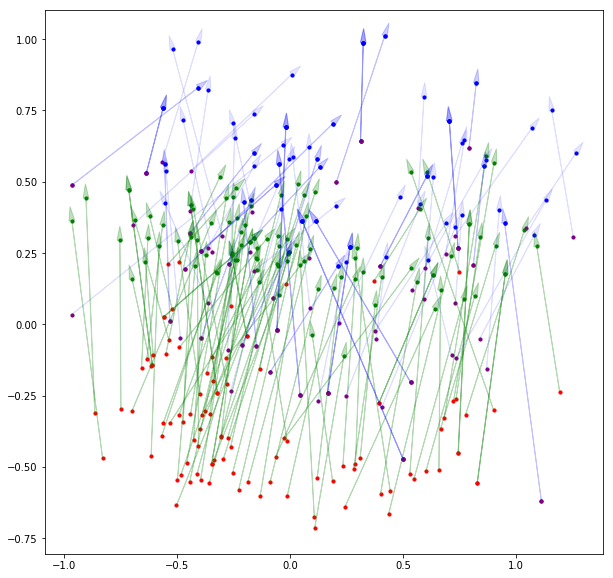

Cluster 17 (800 words)
[ 0.0901479  -0.09498953 -0.25555888 -0.13074759  0.1663055   0.22705436
 -0.07939191  0.00853851 -0.14243688  0.11112289 -0.01593037 -0.24489015
  0.03660633  0.15514055  0.02873379 -0.03854392 -0.14395615  0.11838877
 -0.12162609  0.00282251  0.08734699  0.07949291  0.08137648 -0.14237279
 -0.02418198 -0.06505875  0.06185366  0.06603396  0.042037    0.02843257
 -0.14105168  0.0388256 ]
{'en-case': 393, 'en-mark': 33, 'en-obl': 32, 'fr-case': 208, 'fr-nmod': 23}
0.471938
[['I have nothing but fantastic things to say .' '3' 'but']
 ['In addition , I received feedback from our Gas Desk that the access to the Gas segment of Enron On - Line was cut off to CPS --- do you know who would handle this at Enron that we can speak to ?'
  '13' 'to']
 ['I ve been dating a man from brittany france for a couple of months now .'
  '6' 'from']]
[["Émile Durand , né le 2 juin 1911 à Paris et décédé en janvier 1999 à Toulouse , est un physicien français , professeur de physique à 

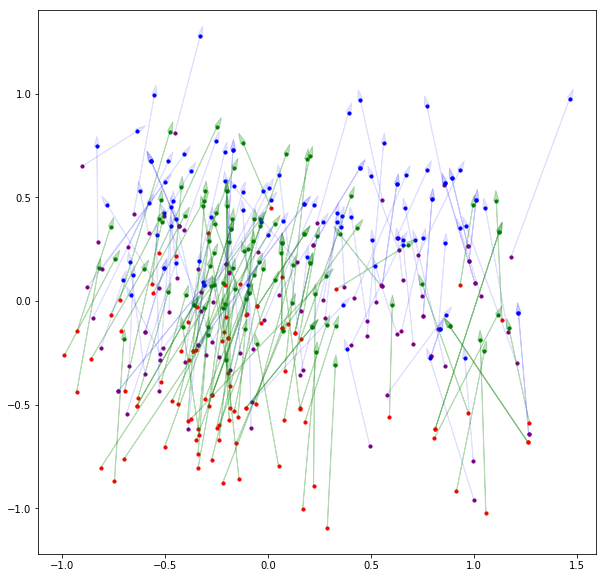

Cluster 18 (1041 words)
[ 0.21910392 -0.02469077  0.09270374  0.02555171 -0.15272589 -0.28595346
  0.07372121 -0.02488521 -0.1275704   0.02985362  0.21207228  0.04294899
  0.15533711  0.38827837  0.04881279  0.12831081  0.1475772  -0.05439602
  0.04297267  0.06886666  0.00741416  0.07019076  0.08202443  0.20534417
  0.20942326 -0.07167701 -0.04677963 -0.14673293  0.18137167 -0.0433006
 -0.2080385   0.01905219]
{'en-punct': 474, 'fr-punct': 553}
0.23041518
[['He is very knowledgeable and took the time to explain the repairs to me .'
  '14' '.']
 ['I tried to calculate the IRR on the port Aransas and Roma post offices .'
  '14' '.']
 ['My room was delightful and the attention to detail was amazing .' '11'
  '.']]
[["Il l' oppose également au mouvement des coopératives , qui maintient le salariat ."
  '13' '.']
 ['Le palais a été progressivement réaménagé comme résidence présidentielle , et depuis 1997 il sert de résidence officielle au président de la Lituanie .'
  '23' '.']
 ["Le club c

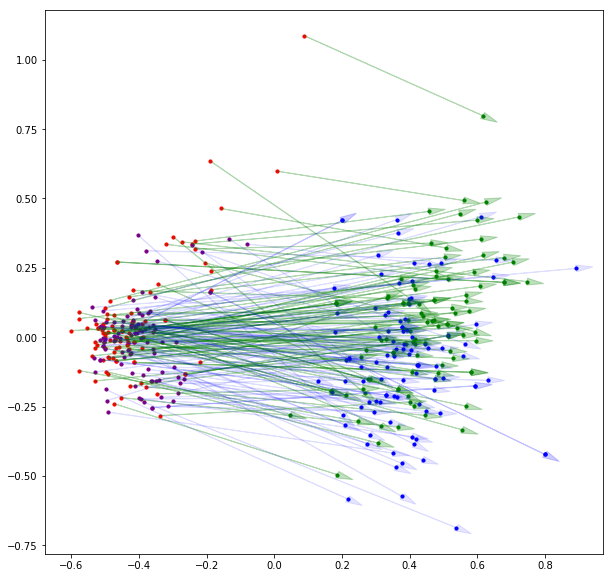

Cluster 19 (528 words)
[-1.34569466e-01 -1.42117413e-02 -3.26328725e-02  5.17479293e-02
  1.84295520e-01  1.34265319e-01  1.28339827e-01  2.51865864e-01
  8.93692859e-03 -2.42389709e-01  9.40369219e-02  1.49233699e-01
  1.79924160e-01  1.05797619e-01 -1.34573683e-01 -4.01934087e-02
 -8.13805759e-02  1.16043746e-01  2.06755266e-01 -1.05225116e-01
  6.31278232e-02  8.26607645e-02  6.33132830e-02 -1.06267333e-01
 -7.66624138e-02 -7.41995573e-02 -4.65217978e-02  1.96984708e-01
  1.40775200e-02  1.63237564e-04 -8.93357396e-02 -1.21834949e-01]
{'en-case': 31, 'en-mark': 344, 'fr-mark': 57}
0.5002693
[['I tried to do it on the HRonline web - site , but the procedure is too complicated .'
  '2' 'to']
 ['Best place to sleep !!!!!!!' '2' 'to']
 ['This cute little stunt is only going to prove just how fanatic the extremist Muslims are .'
  '7' 'to']]
[["La ligue algérienne des droits de l' homme a exprimé son indignation suite au refoulement par les autorités marocaine de Kamel JENDOUBI , Préside

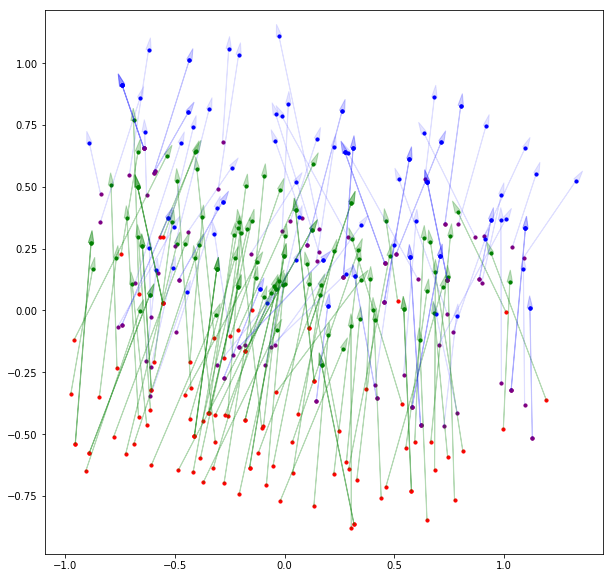

Cluster 20 (797 words)
[ 0.0877867   0.05362763  0.22773193  0.07075039  0.06370759  0.11186272
 -0.19279112  0.19797775  0.07649684  0.04219745  0.1881849  -0.00363708
 -0.11572234 -0.1343682   0.12241329  0.05182613 -0.2951119   0.08192541
 -0.03273476  0.00191725 -0.02754483  0.18859302  0.12346832  0.0860365
  0.11093873  0.02072494  0.04150978 -0.07070535  0.07976164 -0.15239319
 -0.00821251  0.16000521]
{'en-nmod': 112, 'en-nsubj': 21, 'en-obl': 76, 'fr-appos': 32, 'fr-nmod': 243, 'fr-obj': 28, 'fr-obl': 131}
0.45838094
[['I enjoyed working with all of you during the past five years at Enron / Azurix , and I wish you all of the best .'
  '11' 'years']
 ['maybe the cat needs a " new \' home .........' '9' '.........']
 ['I have already submitted my resume and cover letter right after the talk .'
  '8' 'letter']]
[["Demi Mondaine est également un groupe de rock n'roll parisien ." '9'
  'parisien']
 ["Aux yeux des économistes interrogés par l' AFP , l' absence de solutions concrètes

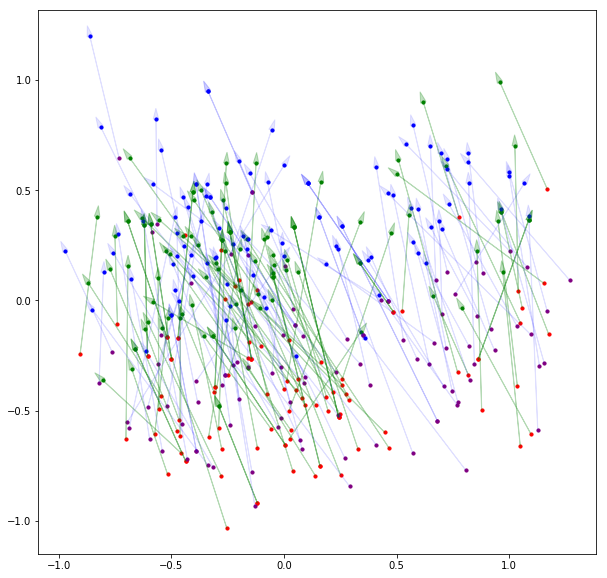

Cluster 21 (969 words)
[ 0.17090748  0.05523398  0.12189862  0.0526596  -0.00587681  0.21285559
 -0.08582384 -0.11480607  0.09051973  0.01930939  0.08329026 -0.0108218
  0.01159688 -0.06155886 -0.03941136  0.3118997  -0.18938264  0.14311281
  0.10508591 -0.00281915  0.04287188 -0.13668148  0.0747328   0.04109555
 -0.00730925 -0.01871197 -0.01061424  0.00608171 -0.04182536 -0.01695354
 -0.14055605  0.00200792]
{'en-nmod': 70, 'en-obj': 84, 'en-obl': 87, 'fr-case': 21, 'fr-nmod': 259, 'fr-nsubj': 28, 'fr-obj': 111, 'fr-obl': 171}
0.49998426
[['( I hope that the US army got an enormous amount of information from her relatives , because otherwise this move was a bad , bad tradeoff ) .'
  '20' 'move']
 ['They work on Wall Street , after all , so when they hear a company who\'s stated goals include " Do n\'t be evil , " they imagine a company who\'s eventually history will be " Do n\'t be profitable . "'
  '29' 'company']
 ['the easiest thing would be a fish - but u need to clean the tank we

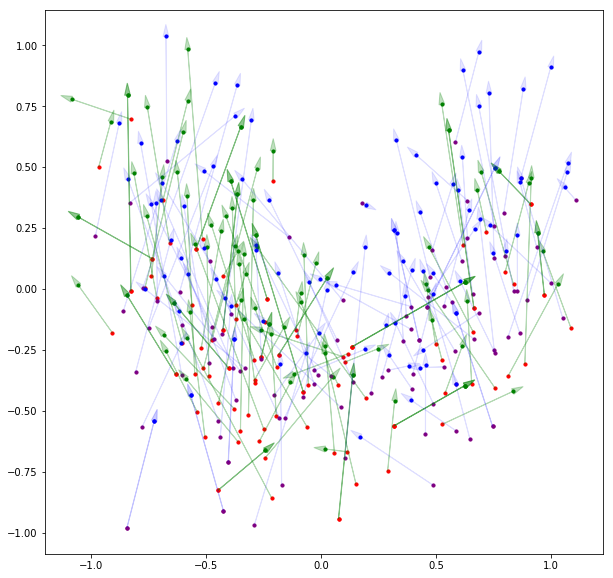

Cluster 22 (519 words)
[-0.17901842 -0.01138448  0.05003243  0.06631003  0.1366985  -0.1382419
 -0.03129819  0.00231762 -0.07930727 -0.09299336 -0.1755759  -0.04197391
  0.05093408  0.03128236 -0.18953605  0.10395175  0.1818603   0.09530482
 -0.01498465 -0.09296061 -0.06762594  0.0583906  -0.3341073   0.08410276
  0.13791229 -0.01148998  0.01127979 -0.3144383   0.01266095 -0.22132753
  0.03394075  0.07800686]
{'en-punct': 135, 'fr-punct': 279}
0.59270203
[['Though I am loathe to quote other writers at legnth in this space , this little bit from Dan Froomkin \'s " White House Briefing " column in the WashPost today is just too good to pass up ( read the whole column here ) :'
  '43' 'here']
 ['Crude - oil prices rose Wednesday as strengthening Hurricane Rita , now a Category 5 storm , threatened to disrupt oil production in the Gulf of Mexico .'
  '16' ',']
 ['" Let ( Hamas ) consider me their striking arm in Iraq because the fate of Iraq and Palestine is the same , " al - Sadr said dur

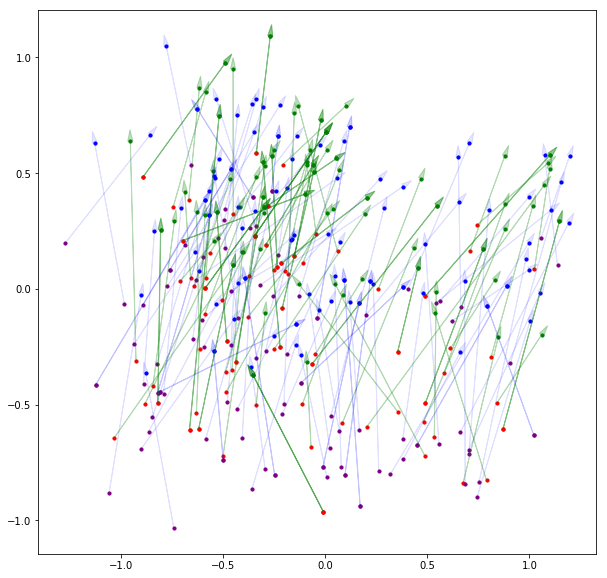

Cluster 23 (766 words)
[ 1.18379965e-01  1.17333997e-02 -2.12619722e-01 -1.22079432e-01
  1.41600415e-01  8.17436576e-02 -1.54681131e-01  2.74311360e-02
 -8.54080915e-02 -5.92078827e-02 -7.22953677e-02 -1.41433746e-01
 -7.48610049e-02  4.70551141e-02 -1.88603505e-01  4.54805754e-02
  5.32261878e-02  3.75248715e-02 -5.45925386e-02 -5.54263033e-03
 -1.49767146e-01  7.97179788e-02 -5.13428971e-02  2.22473890e-02
 -8.60457644e-02  1.69598505e-01  4.78934497e-02  1.70003057e-01
  1.46518663e-01 -6.42462168e-03 -1.41286058e-04  5.10748252e-02]
{'en-advmod': 50, 'en-case': 142, 'en-mark': 111, 'fr-advmod': 38, 'fr-case': 197, 'fr-mark': 77}
0.41367906
[['Clean & tidy with good atmosphere & pleasant staff .' '3' 'with']
 ['when you turn 21 you can party any were you want' '0' 'when']
 ['It clearly had been prepared from fresh ingredients .' '5' 'from']]
[['Même affirmation pour SOS homophobie , qui s\' est portée partie civile : " Pour SOS homophobie , la nécessité de se porter partie civile d

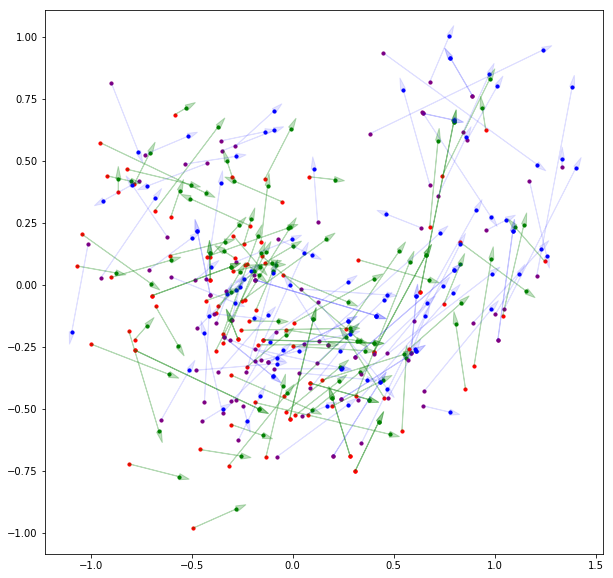

Cluster 24 (1056 words)
[ 0.04748048  0.04552275 -0.09284113 -0.14624633  0.03883103 -0.00112641
  0.1650997  -0.14183271  0.07883304  0.09040056 -0.1380129   0.46957132
 -0.18579714 -0.01326516  0.02177375 -0.04993788  0.01093102  0.20671102
  0.09175072 -0.17016122  0.01041362 -0.05722232 -0.02559399  0.02712137
  0.14386655 -0.05714808  0.14675438  0.01753584  0.073039   -0.09014035
  0.02064067  0.08880736]
{'en-det': 843, 'fr-det': 186}
0.460773
[["I 'm inclined to say that google is doing what they can to both shape and support the growth of the most popular non-Microsoft browser out there - by taking on the leading lights in Firefox development , they 're ensuring the continued life of the project , and ensuring ( not that I think they need to ) that their voice will be heard admidst the higher echelons of the firefox development team ."
  '45' 'the']
 ['Be more careful when you write reviews - this is an accounting group , not Hollister the clothing store .'
  '16' 'the']
 ["Sh

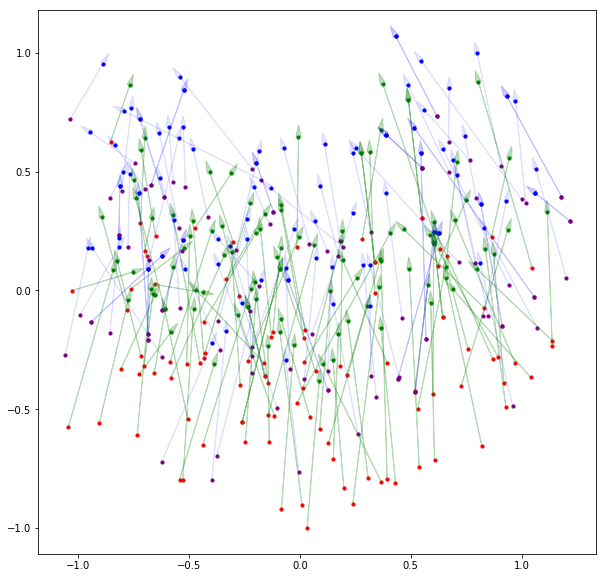

Cluster 25 (664 words)
[-0.10284902 -0.02455727  0.06366794 -0.05492422  0.34531915 -0.37324372
  0.04364373  0.05791438  0.07109061  0.04920576  0.18484215  0.05775298
 -0.06020157 -0.00112655  0.06052954  0.24420513 -0.52677226  0.02423174
 -0.06448521  0.13540769 -0.03317366  0.08111471 -0.04863011  0.09535554
  0.1630424   0.06889779 -0.07573888  0.03838023  0.13660485  0.11047845
  0.07228974  0.17487831]
{'en-acl': 28, 'en-advcl': 35, 'en-conj': 85, 'en-obl': 26, 'en-parataxis': 38, 'en-punct': 21, 'fr-acl': 48, 'fr-advcl': 27, 'fr-appos': 27, 'fr-conj': 106, 'fr-nmod': 28, 'fr-obl': 52}
0.36190876
[['Myself and Credit were calling in and none of the calls rolled into voice mail ( ? ) .'
  '16' '?']
 ['Some countries like Malaysia and Singapore promote trading for foreign visitors during some part of the year .'
  '13' 'part']
 ['John Staikos Direct Dial :? 203.961.7523 Direct Fax :? 203.674.7723 E-mail :? johnstaikos@paulhastings.com'
  '7' 'Fax']]
[["En effet , plus la proximit

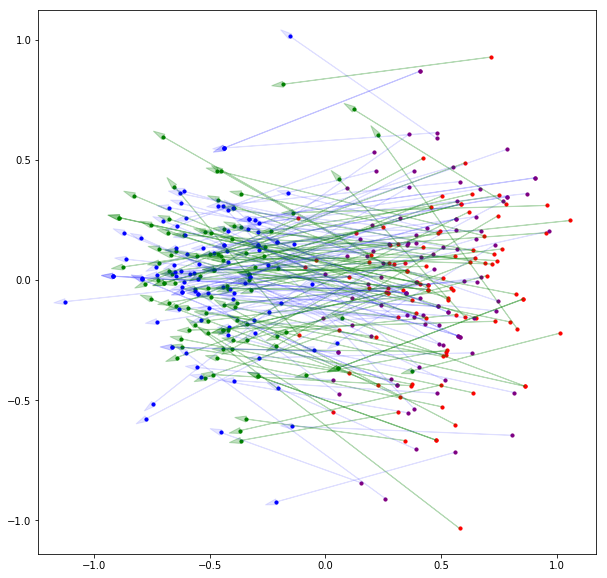

Cluster 26 (1208 words)
[ 0.08337685 -0.01819153  0.04616498 -0.02646899  0.06794321 -0.00301035
  0.00856956  0.12059687  0.00288641  0.02933203 -0.0257006  -0.1369379
  0.11864047 -0.15052332 -0.05659809 -0.07440725 -0.09793524 -0.05010728
 -0.09721082 -0.1649512   0.06594786 -0.01863008 -0.16288297 -0.18954274
  0.06279036 -0.00075706  0.09151503 -0.22345406  0.04167163  0.10024893
 -0.03429413  0.00952148]
{'en-case': 33, 'en-punct': 27, 'fr-acl': 80, 'fr-amod': 613, 'fr-appos': 42, 'fr-case': 42, 'fr-flat': 33, 'fr-nmod': 107}
0.5003394
[['But getting past who should get them , is who has them , and who is really close .'
  '17' 'close']
 ['It was incorporated as a city on May 26 , 1955 .' '9' ',']
 ['This section pertains to terminated employees who are paid out in the year following the termination event .'
  '10' 'in']]
[["Leurs premiers faits d' armes en tant que nouveau chapitre remontent à la purge du monde exodite eldar de Urolak Prime , sous la conduite du premier Maître d

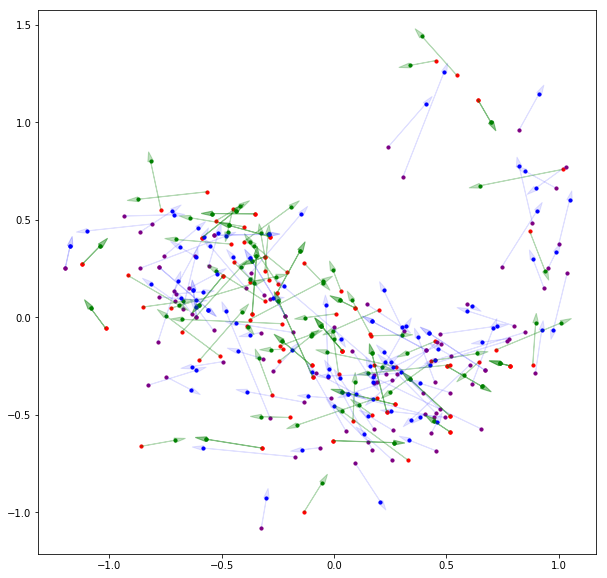

Cluster 27 (735 words)
[ 0.07945859  0.02169664 -0.0885755   0.14202039 -0.3034793  -0.0420098
 -0.06234553  0.00866868 -0.02045723 -0.0036463  -0.18214919  0.02846711
  0.06652264  0.05755891 -0.06347175 -0.2748569  -0.31318665 -0.09662075
  0.03436125 -0.06558201 -0.06359276  0.18714966  0.04169294 -0.01709447
  0.02553503  0.0369165   0.01506879 -0.05364414 -0.0453756  -0.09094603
 -0.03154491  0.01209737]
{'en-acl': 28, 'en-advcl': 23, 'en-conj': 94, 'en-nmod': 47, 'en-obl': 27, 'fr-acl': 37, 'fr-appos': 21, 'fr-conj': 103, 'fr-nmod': 75, 'fr-obl': 56}
0.40606397
[['08/10/2000 08:28 AM' '2' 'AM']
 ["Now , none of this has been confirmed by Google at the present time , but it 's an old adage that you follow the money to see who is behind something ."
  '23' 'follow']
 ['i m 15 btw' '3' 'btw']]
[["Il devient le nouveau président du conseil régional d' Auvergne , battant Valéry Giscard d' Estaing , qui occupait cette fonction depuis 1986 ."
  '18' 'occupait']
 ["D' après ce que nous a

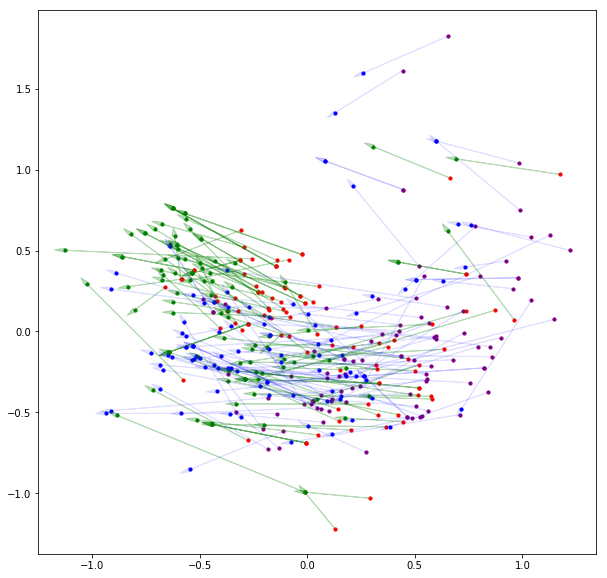

Cluster 28 (1079 words)
[ 0.24351776  0.24671999 -0.07272345  0.20366395  0.29885986  0.03528246
  0.08369604 -0.06480436 -0.12266966  0.18887916  0.06018982 -0.06021382
 -0.16942221  0.0035697  -0.11980815 -0.03347444 -0.06887798 -0.03363295
  0.01223693 -0.08131709 -0.04029221 -0.07017518 -0.01815525  0.15337421
 -0.01070874 -0.06278075 -0.0407846  -0.13538896 -0.13111246 -0.05385219
  0.13914937 -0.19213648]
{'en-case': 23, 'fr-case': 943}
0.6002948
[['I have a friend that has to get rid of one of her cats because of allergies , he is the youngest at 3 years old black , long hair , incredibly friendly .'
  '13' 'cats']
 ['An international contest of cartoons on the Holocaust opened in Tehran in response to the publication in Western papers last September of caricatures of the Prophet Mohammed .'
  '21' 'of']
 ['Certain elements of the travelling community engage in this activity , but overall no not really .'
  '2' 'of']]
[['Je vous recommande la fondue avec son pain de campagne et 

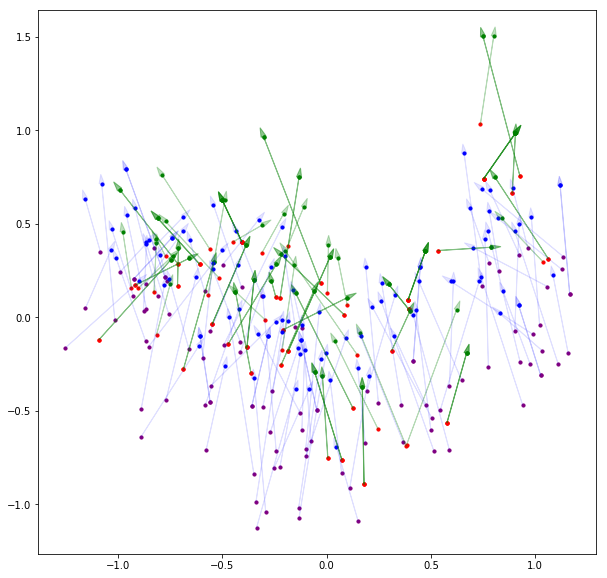

Cluster 29 (1073 words)
[-0.08716555 -0.0519178  -0.02403647 -0.05263865 -0.06547645  0.10146066
  0.10037342 -0.01231549 -0.1489956   0.00578347  0.0207797  -0.04284156
  0.10068092  0.1261051  -0.04412011  0.07193007 -0.29858068  0.02177506
  0.01692145 -0.05070379 -0.05022441 -0.02944279 -0.1142813  -0.19556116
 -0.09688704 -0.03624877  0.05521408 -0.07728328  0.01588851 -0.04073335
  0.04501844  0.06091413]
{'en-acl': 28, 'en-advmod': 96, 'en-case': 33, 'en-compound': 36, 'en-obj': 55, 'en-obl': 47, 'en-xcomp': 173, 'fr-advmod': 27, 'fr-amod': 31, 'fr-case': 34, 'fr-nmod': 45, 'fr-obj': 63, 'fr-obl': 57, 'fr-xcomp': 176}
0.41977292
[['I have no inside information , but I have been following links today that strongly indicate that Google is damn serious about securing permanent control of the leading edge browser technology in Firefox .'
  '11' 'links']
 ['Hopefully things will go smoothly .' '4' 'smoothly']
 ["As long as you are a gentleman and treat them with respect they wo n't h

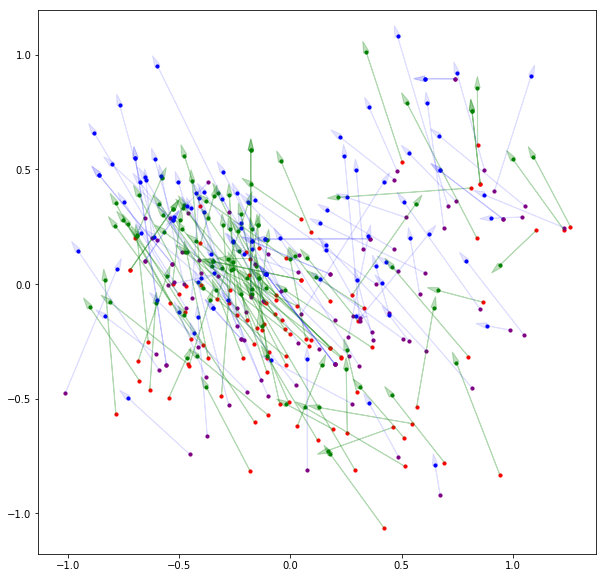

Cluster 30 (1425 words)
[-0.0510565  -0.12144651 -0.10293929 -0.07341944  0.0740212   0.03148781
 -0.06324469  0.05998999 -0.19407289  0.07567363  0.00223818 -0.06437559
  0.12747626 -0.03948652 -0.17635635  0.02154855 -0.02801965  0.14594175
 -0.14096634 -0.02857343 -0.15921187  0.17875914  0.09487821  0.03692979
 -0.16984622  0.10260387  0.2104994  -0.15226223 -0.02713731  0.23755664
  0.12274788 -0.1347349 ]
{'en-advmod': 41, 'en-case': 480, 'fr-case': 777}
0.5125129
[['great knowledge and prices compared to anyone in the industry .' '7'
  'in']
 ["I 'm not kidding , I once lost a hamster in my house 3 months later I walk down in the basement and it was as big as a rat ."
  '19' 'in']
 ['The complaint , filed with the United States Department of Housing and Urban Development , accuses HANO of violating a 2003 enforcement agreement entered into between former St. Thomas Housing Development residents , the City of New Orleans , HANO , and the U.S. Department of Housing and Urban Devel

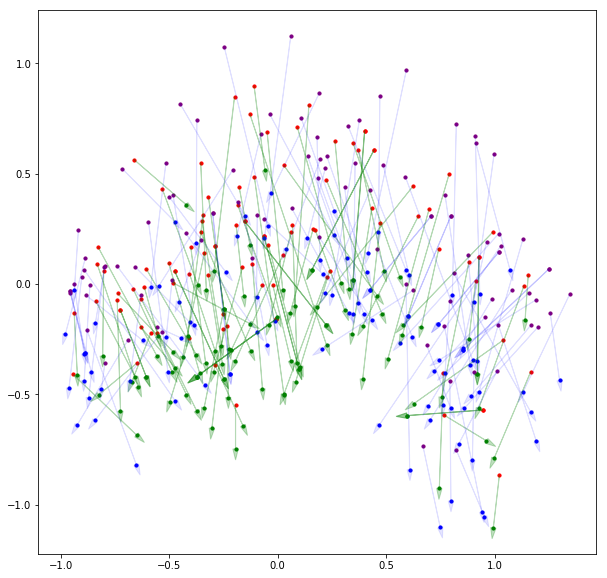

Cluster 31 (926 words)
[-1.0315716e-01  3.5133332e-02  5.8958922e-02  1.8940242e-02
 -3.7459016e-02  2.8263584e-01 -3.8602810e-02 -1.5543157e-02
 -6.9167614e-02 -1.1564769e-02 -1.2019387e-02 -9.4987694e-03
  7.5340807e-02 -3.1120526e-02  2.4381125e-02 -7.6300941e-02
 -3.6023334e-01 -1.7498830e-01 -7.4804761e-05 -2.5791913e-01
 -7.7597514e-02 -1.9004174e-01 -1.2538134e-01  1.3468266e-01
  2.2401229e-02  1.2569359e-01  6.3013211e-02  1.4267895e-02
  4.9637683e-02  7.9499912e-03 -3.4200035e-02  3.7278030e-02]
{'en-advcl': 33, 'en-ccomp': 45, 'en-conj': 57, 'en-nmod': 32, 'en-nsubj': 25, 'en-obj': 62, 'en-obl': 74, 'en-parataxis': 21, 'en-xcomp': 21, 'fr-acl': 26, 'fr-appos': 23, 'fr-conj': 52, 'fr-nmod': 68, 'fr-nsubj': 24, 'fr-obj': 65, 'fr-obl': 96, 'fr-xcomp': 26}
0.36974484
[['It has often been said that " True love is just around the corner " ... and maybe ... if you have n\'t found it as yet - you possibly soon will .'
  '23' 'found']
 ['I will definitely refer my friends and family

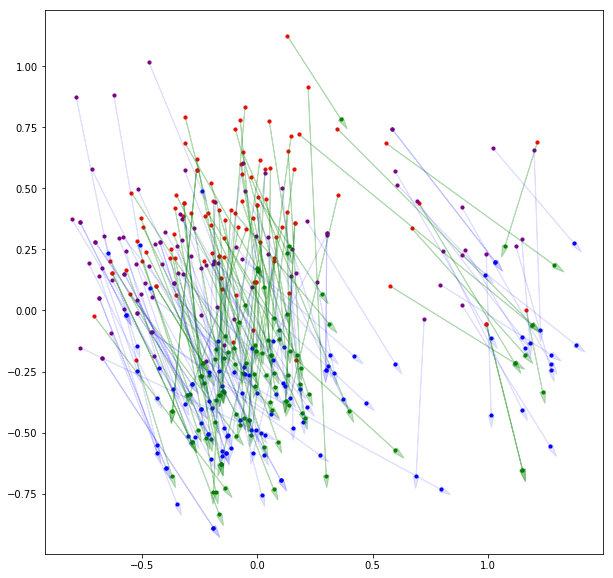

Cluster 32 (549 words)
[ 0.00321751 -0.05008466  0.04359501 -0.06020454  0.1374604  -0.7135644
  0.05244532  0.00920185 -0.17863764  0.08266139 -0.20112771  0.02744111
  0.07593026  0.03935213  0.00988187  0.21976836 -0.6912329  -0.09272096
  0.15632682 -0.04057963 -0.04654042  0.01820781  0.15511854  0.02398466
  0.1167486  -0.03096611 -0.05808008  0.06293074 -0.01319194  0.04394137
 -0.07879873 -0.02154395]
{'en-advcl': 21, 'en-conj': 78, 'en-parataxis': 57, 'en-punct': 48, 'fr-acl': 32, 'fr-advcl': 40, 'fr-conj': 118, 'fr-obl': 31, 'fr-punct': 42}
0.44772574
[["Wait staff is always ready to help if you ca n't decide ( which happens every time for me d / t the huge menu of rolls ) and always courteous !"
  '30' 'courteous']
 ['can i have some indoor pet ideas please !!!!!!!!!!!!!?' '8'
  '!!!!!!!!!!!!!?']
 ['We will be distributing the shares reflected on your 9/30/01 statement ( 6,606 shares plus cash for fractional shares ) .'
  '13' 'shares']]
[["Il comporte , de part et d' autre 

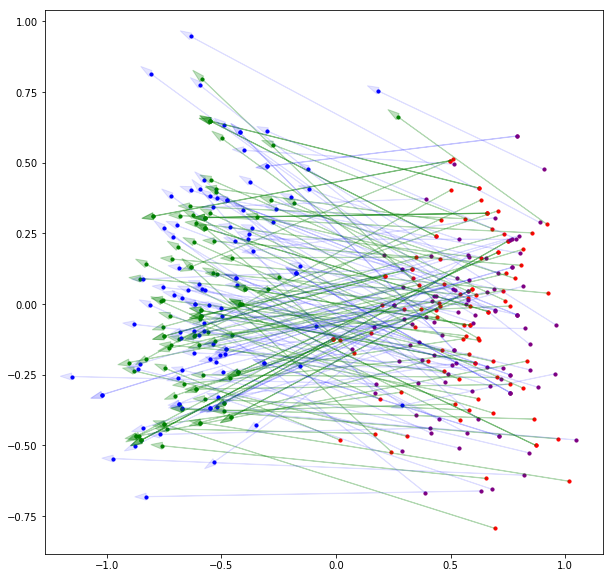

Cluster 33 (1350 words)
[-0.05197985  0.10085309 -0.10588997  0.12607603 -0.03469682 -0.25301853
 -0.20684935 -0.12801692 -0.04379    -0.04123757  0.20398538 -0.06215576
 -0.15400144 -0.23617817  0.07374024 -0.16563429  0.1288077   0.05834537
  0.17809117 -0.07732087  0.11837409 -0.1159025  -0.09962834 -0.1038558
 -0.08757909 -0.01507087 -0.10634876 -0.09773052  0.02756588  0.16137563
  0.01313055  0.02224119]
{'en-aux': 203, 'en-cop': 469, 'fr-aux': 265, 'fr-cop': 366}
0.34879202
[['max and jen are looking for you .' '3' 'are']
 ['Arial photos of the lab were uranium is being enriched , somewhat like those of chemical weapons stockpiles in Iraq .'
  '7' 'is']
 ['max and jen are looking for you .' '3' 'are']]
[["L' architecture est ressentie comme un moyen de traduire l' espace entourant le corps humain par la philosophie associée à la psychologie de la sphère intime , de la sphère privée , de la sphère publique qui se définissent selon la société ."
  '2' 'est']
 ['Les services naviga

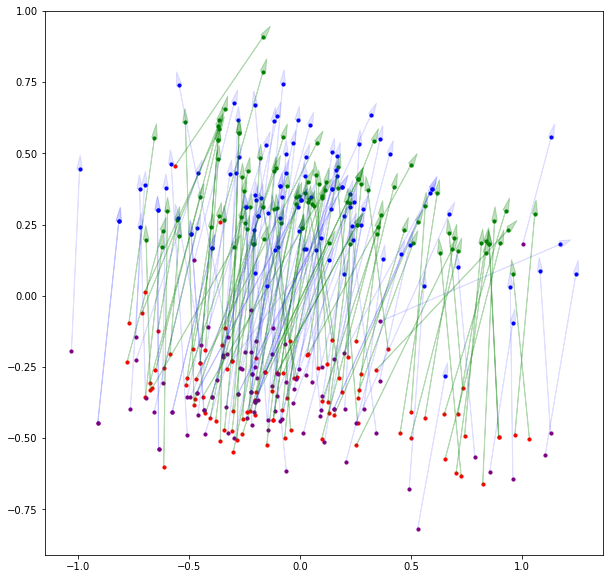

Cluster 34 (563 words)
[ 0.12088186 -0.06619136 -0.00853491  0.06218816 -0.18785727  0.1664661
  0.0430388  -0.07670766 -0.01237623 -0.01159717  0.3114942  -0.03333398
  0.09039558  0.34333953  0.05867954 -0.01070897  0.7114045  -0.02127762
 -0.07113142  0.0889091   0.07627884  0.06671959 -0.0056767   0.10364236
  0.09630442 -0.06390537  0.00192899 -0.16809793  0.22221088 -0.03778804
 -0.15490817  0.0700735 ]
{'en-punct': 178, 'fr-punct': 372}
0.3543378
[['Just one small commment - it \'s not possible , as far as I know , for Google to " Aquire " Firefox .'
  '17' 'Google']
 ["It is n't about finding the meaning of life at work ." '11' '.']
 ['Mr. Villega is an exceptional California criminal defense lawyer .'
  '9' '.']]
[['La cathédrale du Christ Rédempteur ( Cathedral Church of Christ the Redeemer ) de Dromore est une cathédrale anglicane britannique située en Irlande du Nord .'
  '25' '.']
 ["Conformément aux réquisitions du parquet , la juge d' instruction en charge de ce dossier 

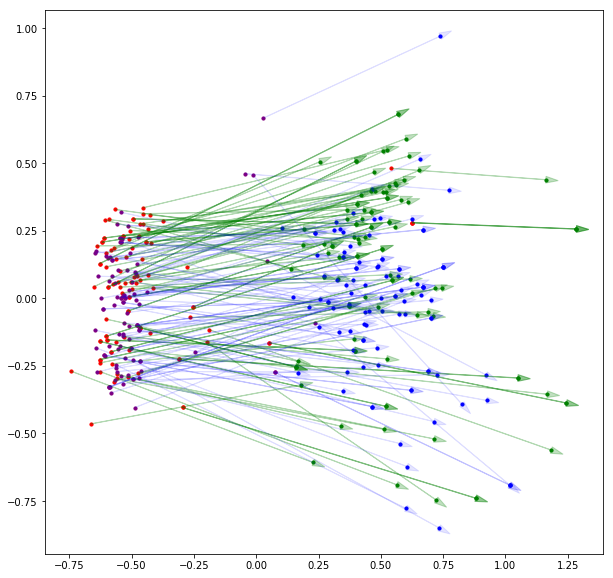

Cluster 35 (832 words)
[ 0.14161405  0.05305496  0.05501759  0.04298769 -0.04788303 -0.00957237
  0.03744964  0.01319765  0.17995246 -0.05287318  0.10754389  0.00540687
 -0.09625087 -0.00719581 -0.01440903  0.08383027 -0.29566917  0.1597925
 -0.08135442  0.21046777  0.02653169  0.18337598 -0.01909175 -0.10033679
  0.07112053 -0.03241877 -0.0967164  -0.11720503  0.00732959  0.04647703
  0.04044975  0.1145345 ]
{'en-acl': 42, 'en-conj': 46, 'en-nmod': 46, 'en-obj': 37, 'en-obl': 83, 'en-xcomp': 33, 'fr-acl': 27, 'fr-conj': 69, 'fr-nmod': 122, 'fr-obl': 85}
0.43760315
[['Though I am loathe to quote other writers at legnth in this space , this little bit from Dan Froomkin \'s " White House Briefing " column in the WashPost today is just too good to pass up ( read the whole column here ) :'
  '21' '"']
 ['answered all my questions , and called me back when I needed something .'
  '11' 'needed']
 ['As discussed , attached is a GISB draft for Pioneer .' '1' 'discussed']]
[['Paul Pelliot ( né 

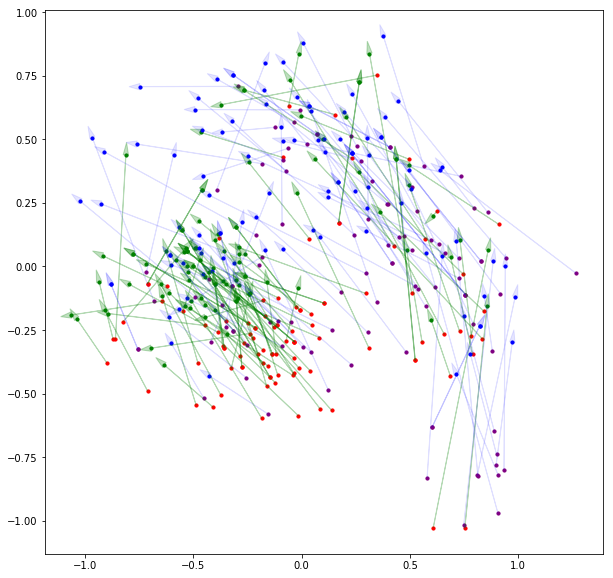

Cluster 36 (739 words)
[ 0.00338258  0.12338698  0.17348002  0.00865499  0.05809398  0.24988955
 -0.17724314  0.1323308  -0.09728008  0.10174462 -0.19033621  0.07323976
  0.00979225 -0.20623146  0.11351938  0.09611217  0.02162586 -0.08386458
  0.09381124  0.05875558  0.04652885  0.08808807  0.05412207  0.10495338
  0.11813497 -0.14197923  0.05033444  0.01228699 -0.1047211  -0.11782966
 -0.06156149  0.00902671]
{'en-nmod': 25, 'en-nsubj': 229, 'fr-nmod': 59, 'fr-nsubj': 200, 'fr-obj': 31, 'fr-obl': 50}
0.42582485
[['okay .... I have a dog and my mother is really really terrified of hamsters .'
  '8' 'mother']
 ['NiMo released an additional RFP for peaking supplies for this winter , I believe Phil should have or be getting that RFP .'
  '0' 'NiMo']
 ['The Neocons in the CPA have all sorts of ulterior motives and social experiments they want to impose on the Iraqi people , including Polish - style economic shock therapy , some sort of sweetheart deal for Israel , and maybe even breaking t

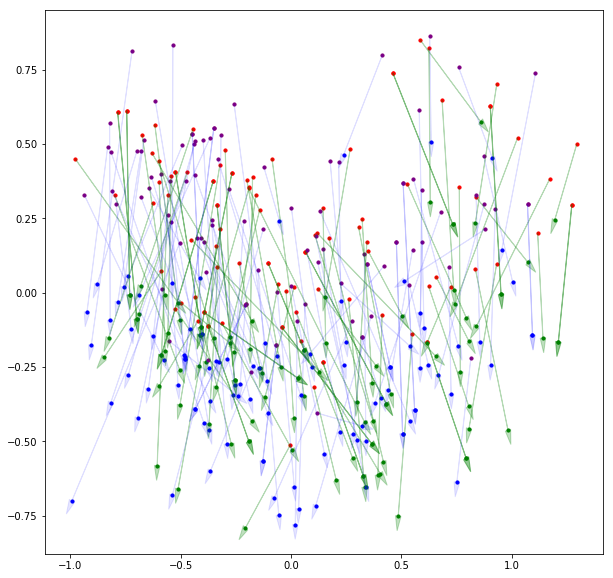

Cluster 37 (556 words)
[-0.0385753   0.04988427  0.0371134   0.00801405 -0.11219475  0.6628582
 -0.0386702  -0.01947601  0.12653092  0.04318477 -0.10803809 -0.06644759
  0.04529859 -0.15623522  0.02564277 -0.17593564  0.35755613 -0.06724824
 -0.0868275  -0.0736008   0.00800406  0.04044884 -0.09364329 -0.10361411
 -0.13889307 -0.01476859  0.10103338 -0.05817196 -0.01578546 -0.1284311
  0.06613734 -0.02123439]
{'en-advcl': 48, 'en-nsubj': 44, 'en-obl': 31, 'fr-advcl': 61, 'fr-nsubj': 164, 'fr-obl': 106, 'fr-punct': 21}
0.3459388
[['If you are looking for authentic British meat pies , then look know further .'
  '3' 'looking']
 ['When their precious cartoons are released I highly doubt it will look like the end of the world .'
  '5' 'released']
 ['Sept. 11 Commission member Philip Zelikow , who is close to the Bush administration , admitted on Sept. 10 , 2002 , that the ulterior motive of the Bush administration for the Iraq War was to " protect Israel , " according to the Asian Times .'


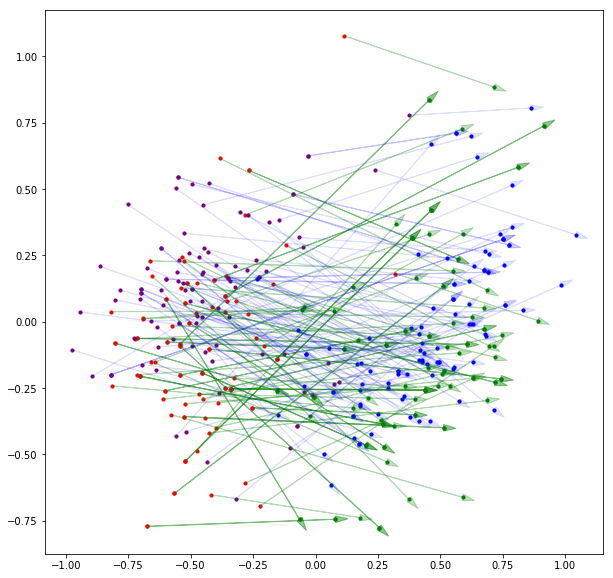

Cluster 38 (903 words)
[ 0.1793738  -0.09265213 -0.06259265  0.16175306 -0.14312474 -0.05509412
  0.05358923  0.03879431 -0.07798477 -0.05288754  0.23937212  0.1014831
  0.0555667   0.3895669   0.046072    0.03645642  0.39946532 -0.10554937
 -0.03821236 -0.03389125  0.00900284  0.02144285 -0.01982498  0.17256127
  0.19204983  0.00913446 -0.03410865 -0.17967336  0.05187082  0.02478385
 -0.13644879  0.18987767]
{'en-punct': 750, 'fr-punct': 146}
0.22193757
[['The owner Karla is welcoming and fun .' '7' '.']
 ['Fish are probably the easiest to take care of though .' '10' '.']
 ['Most importantly , the food was outstanding .' '7' '.']]
[['Aviator , un film sur la vie de Hughes .' '9' '.']
 ["A noter que deux ateliers seront organisés à l' occasion de la conférence d' Alger ."
  '15' '.']
 ['Ce sont Charles Barkley , Karl Malone , Scottie Pippen , David Robinson et John Stockton .'
  '16' '.']]


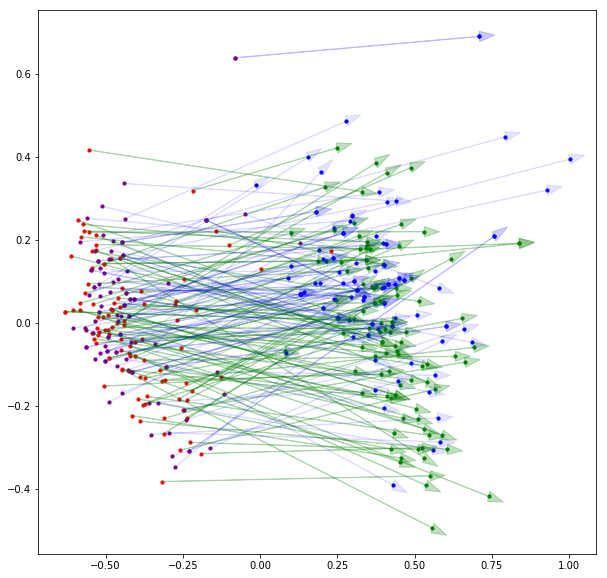

Cluster 39 (442 words)
[ 0.08682878 -0.01006436 -0.13100654 -0.17465091 -0.06705528 -0.04055214
 -0.07555301 -0.19405602 -0.19631985 -0.21856533 -0.117167   -0.00361996
  0.08299038 -0.13987485 -0.14385295  0.1293258   0.14953846 -0.05318246
 -0.04402819  0.03374626  0.1987618  -0.08885087 -0.03459081  0.09354781
 -0.0531485   0.10444431 -0.12328354 -0.24778877 -0.08049036  0.03030777
  0.17830633  0.18065491]
{'en-punct': 98, 'fr-punct': 247}
0.5308676
[["I 'm the author of three books ( including the 1.3 million seller ALTERNATIVE CURES ) and hundreds of magazine articles , and worked for 20 years at Rodale Press , as a writer and as editor - in - chief of Prevention and Rodale Books ."
  '7' '(']
 ['( Applause . ) "' '0' '(']
 ['Highly recommended for who wants to have website .' '7' 'website']]
[["Herman ( ou Hermant ) est probablement l' aîné , né vers 1385 , puis vient Paul ( ou Polleke ou Polequinen , suivant les sources ) , en 1386 ou 1387 , et Johan ( ou Johanneke , Jacquemin 

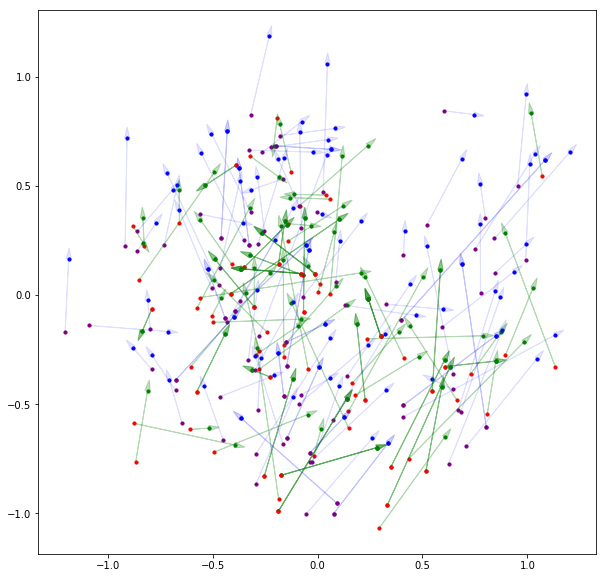

Cluster 40 (724 words)
[ 0.06879057 -0.11485937  0.05626762  0.12542096  0.05092565 -0.15436336
  0.1404723   0.09491268 -0.03492449  0.11071666  0.1099058   0.13348237
 -0.10959893  0.02126791 -0.06062843 -0.17750579  0.02155974  0.03280707
  0.08306717  0.08376277 -0.13704866 -0.21871309  0.05450579  0.00224275
 -0.10083989  0.04728248  0.29635626  0.14246249 -0.26354563 -0.06273738
  0.16701205 -0.02262853]
{'en-det': 38, 'fr-case': 65, 'fr-det': 569}
0.45024586
[['certainly not " normal " photography ... forensic photography is about the facts :'
  '10' 'about']
 ['Exxon Mobil released nonessential staff from two giant Texas plants .'
  '6' 'two']
 ['US troops there clashed with guerrillas in a fight that left one Iraqi dead .'
  '7' 'a']]
[['Cette dernière représente un évêque bénissant les fidèles et serait une représentation de Saint Pallais .'
  '3' 'un']
 ["L' « oasis de vie » , dans un milieu où règne l' obscurité totale et une pression hydrostatique importante , est riche et

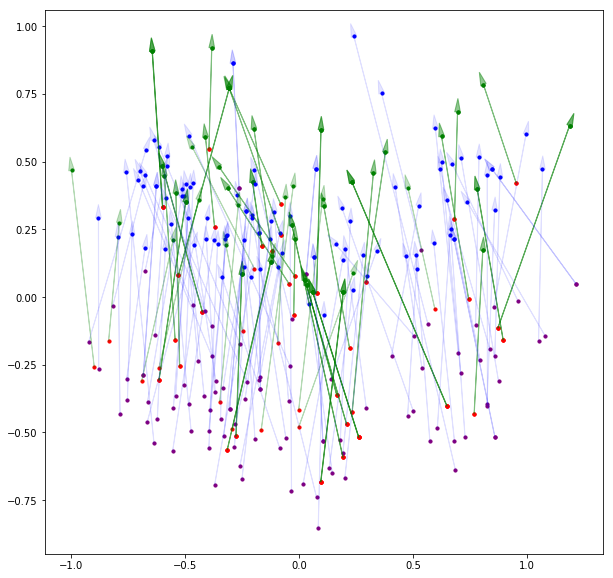

Cluster 41 (1394 words)
[-0.02007254  0.07219785  0.20343645 -0.05521249 -0.11598732  0.16829677
  0.07830316 -0.06664744  0.0483834   0.00207348  0.00785683  0.01797204
  0.07100631  0.06063462  0.0072574   0.01413336 -0.3614559  -0.0109327
 -0.00395739  0.07923793  0.04267951 -0.34718594  0.03048825 -0.05216212
 -0.03128087 -0.04383179 -0.07106721 -0.03277243 -0.03343278  0.03336838
 -0.01937241 -0.00463967]
{'en-nmod': 22, 'en-nsubj': 30, 'en-obj': 500, 'en-obl': 51, 'fr-nmod': 108, 'fr-obj': 405, 'fr-obl': 150}
0.43334246
[['( Only recently have a few experienced State Department Arabists been allowed in to try to begin mopping up the mess . )'
  '17' 'mopping']
 ['And what is their big / main meal of the day .' '7' 'meal']
 ["The Coalition decision to provoke a fight with Muqtada al - Sadr 's movement only three months before the Coalition Provisional Authority goes out of business has to be seen as a form of gross incompetence in governance ."
  '35' 'incompetence']]
[["Obama vou

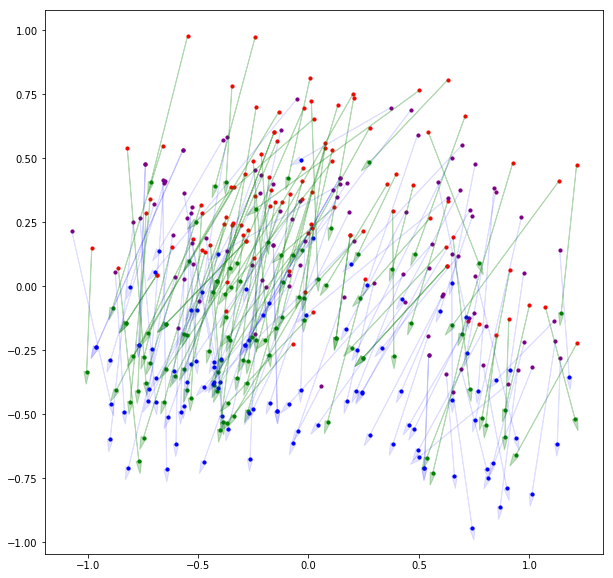

Cluster 42 (794 words)
[-1.32003590e-01 -5.70515953e-02  1.10647753e-02 -3.75586361e-01
 -4.07176651e-03 -2.24943943e-02  3.11885029e-02  2.86292154e-02
  1.07624978e-01 -1.17661715e-01 -8.26150458e-03  1.31597556e-02
  4.37044837e-02  7.44180679e-02  1.06989704e-02  1.40956389e-02
 -6.27515391e-02 -3.51661146e-02 -1.00296222e-01 -6.75488636e-03
  2.00392436e-02  8.84888321e-02 -1.84326336e-01  1.60000935e-01
 -1.11916281e-01 -1.62885934e-01  1.84487235e-02 -2.44091880e-02
 -2.37271190e-04 -1.57763302e-01  4.70745265e-02 -1.46870434e-01]
{'en-advmod': 316, 'en-amod': 33, 'fr-advmod': 221, 'fr-amod': 26, 'fr-obl': 32}
0.45400614
[["Hope you do n't miss it too much ." '6' 'too']
 ['The Atmosphere is the best .. Italian music , candles , helpful and friendly staff ... And the food is beautiful too !'
  '21' 'too']
 ['Though I am loathe to quote other writers at legnth in this space , this little bit from Dan Froomkin \'s " White House Briefing " column in the WashPost today is just too go

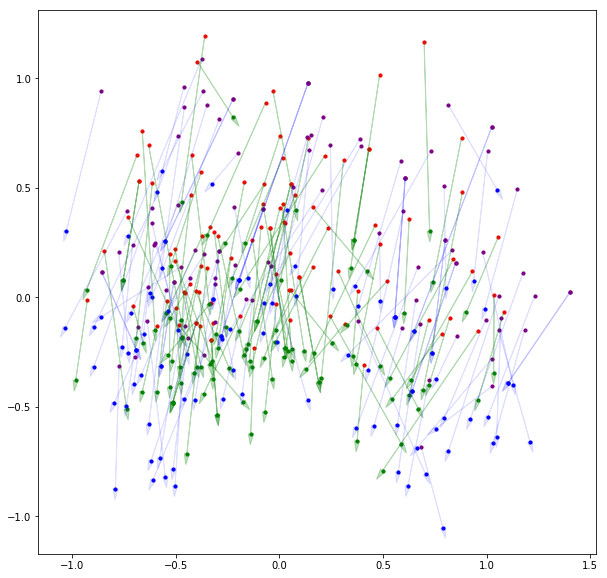

Cluster 43 (911 words)
[ 0.07443544 -0.08835661  0.15401939  0.16552386  0.03340691  0.14969473
  0.05233647  0.22969864 -0.00219589  0.10137139 -0.09998487 -0.2034823
 -0.01840362 -0.2424294   0.03317058 -0.00404857 -0.07926829 -0.11206347
  0.09453454 -0.13367882 -0.09034468  0.01609894  0.00747105 -0.0036971
 -0.04965057 -0.00177045  0.05319814 -0.08492503  0.11259808 -0.12799054
 -0.08422661  0.15254176]
{'en-advmod': 31, 'en-compound': 34, 'en-nmod': 53, 'en-nsubj': 34, 'fr-acl': 21, 'fr-amod': 96, 'fr-appos': 87, 'fr-nmod': 296, 'fr-nsubj': 62, 'fr-obl': 31}
0.4854107
[['Upon return to New Orleans after the Hurricane Katrina evacuation , former residents have been informed that there are no available public housing units at River Garden because those units have been reserved for HANO employees .'
  '26' 'Garden']
 ['My favorite so far in Bellevue .' '5' 'Bellevue']
 ['The information contained herein is based on sources that we believe to be reliable , but we do not represent tha

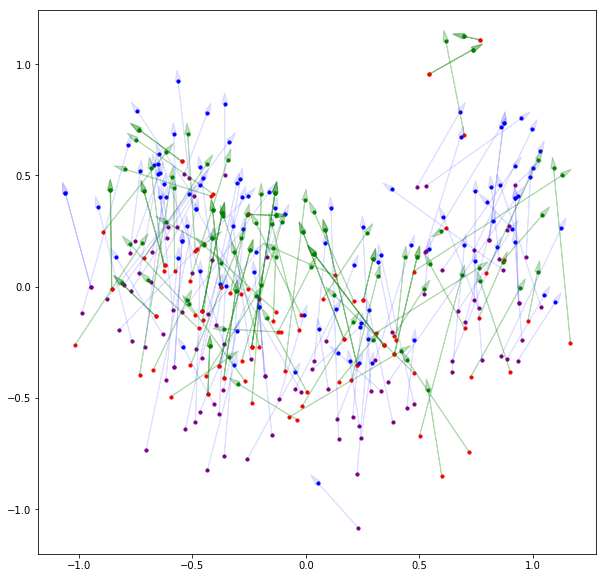

Cluster 44 (527 words)
[-0.04139319 -0.02299926 -0.10013498 -0.19885774  0.02977934  0.04020133
 -0.15766078  0.05501536  0.13745391  0.03450492 -0.19096316 -0.03142001
  0.08475007  0.16465901  0.164646    0.1792412  -0.0088651  -0.09897642
 -0.09149667  0.02338795 -0.137016   -0.0868374  -0.22253998 -0.01132946
 -0.02210218 -0.04588084 -0.06242498  0.14715776  0.04966855 -0.2238853
  0.06408064  0.02912632]
{'en-advmod': 161, 'en-det': 30, 'fr-advmod': 186, 'fr-fixed': 30}
0.49347574
[["I do n't think they ban if the tats are n't offensive and you should make them not noticeable at the time of the interview but once you got the job there nothing they can really say if so you have a sue / case against them"
  '17' 'not']
 ['Traci Warner Enron Broadband Services , Inc. Phone ( 713 ) 853-3242 Cell ( 713 ) 705-7201'
  '4' 'Services']
 ['Be more careful when you write reviews - this is an accounting group , not Hollister the clothing store .'
  '14' 'not']]
[["Amir Khadir d' origine irani

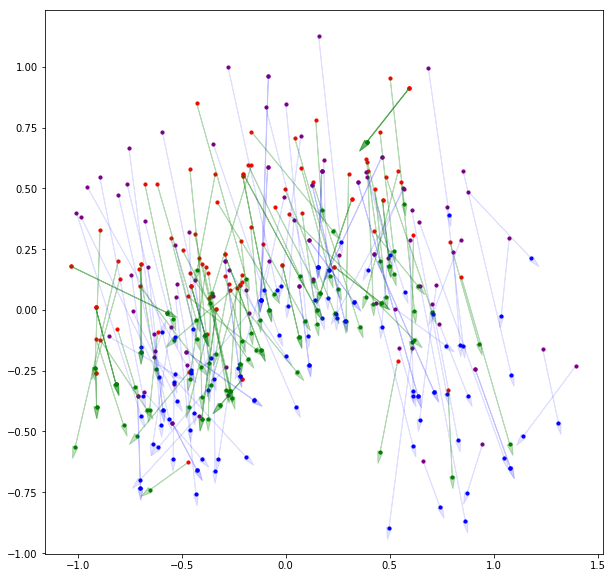

Cluster 45 (1203 words)
[ 0.0283506   0.09917309 -0.03120428  0.07686903  0.10021339 -0.20684285
  0.18353844 -0.00077689 -0.00995605  0.23232746 -0.10157362  0.3433459
 -0.20711835  0.02001315 -0.19374196 -0.15011477  0.08061403  0.31776297
  0.05087955 -0.11519017 -0.03253216 -0.04752311 -0.01251413 -0.02667238
  0.04403131 -0.0150537   0.20904124  0.13597147 -0.01397715  0.0096203
  0.14652683  0.0926979 ]
{'en-det': 36, 'fr-det': 1140}
0.5407309
[['This is the best Mediterranean Restaurant in the West Valley , I have friend who drive from central Phx to come here .'
  '2' 'the']
 ['The US lost yet another helicopter to hostile fire near Habbaniyah in the Sunni heartland , but this time the crew was safe .'
  '12' 'the']
 ['Go to Goldstar.com and get tickets for about a third of the price .'
  '8' 'a']]
[["La Convention imposa bien le bonnet phrygien au drapeau de l' armée , mais peint au centre de l' étoffe et surmontant le faisceau du licteur entouré de branches de chêne et de lau

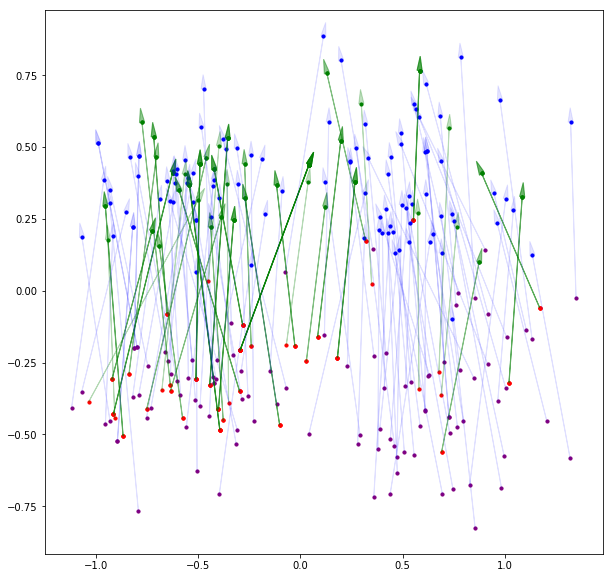

Cluster 46 (886 words)
[-7.48395175e-02 -1.08186388e-02  1.95176259e-01  3.40239629e-02
  2.32288614e-04  3.23291600e-01  5.98195009e-02 -8.02711099e-02
  2.12122910e-02  1.01015329e-01 -2.97134161e-01  1.16305694e-01
  8.43393430e-03 -1.50196984e-01  1.63791217e-02  1.77726910e-01
  6.52607009e-02 -1.24036316e-02 -4.32113782e-02  1.28545225e-01
 -7.07997456e-02 -4.12841886e-03  1.02032609e-01 -4.93929759e-02
  6.16684146e-02 -6.60577714e-02 -1.59795970e-01 -5.22037745e-02
 -1.40430883e-01 -3.35975811e-02 -9.90323126e-02 -1.04187690e-01]
{'en-nsubj': 281, 'fr-nsubj': 484}
0.34990147
[['Well last night while I was sleeping , my hamster escaped from his cage .'
  '9' 'hamster']
 ['" We were on the road and the first bridge was bombed and we drove home and all the other bridges were bombed and there was absolutely no way for us to get home , " Chahine told reporters outside federal court in Detroit .'
  '20' 'bridges']
 ['Salad bar is hit and miss for freshness - sometimes the broccoli lo

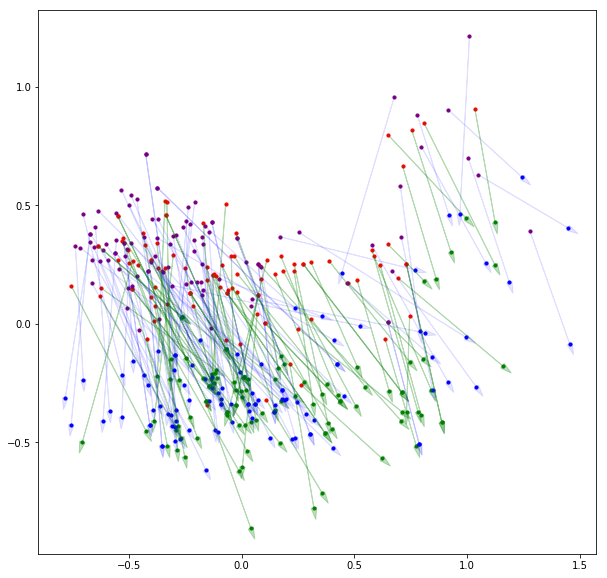

Cluster 47 (750 words)
[ 0.07672288 -0.01419772  0.12800506  0.11302066 -0.08202504  0.25640613
 -0.33327752 -0.01767852 -0.03455972  0.10712263  0.09184627  0.11654435
  0.07863898 -0.05595884  0.02071653  0.02455572 -0.3325267  -0.04889245
 -0.01403473 -0.05979523  0.10378557 -0.06559088  0.07115514  0.13438167
 -0.0647939   0.00297654  0.17147931  0.01265013  0.03766592 -0.14087868
 -0.07751855 -0.01750634]
{'en-nmod': 84, 'en-obj': 24, 'en-obl': 74, 'fr-nmod': 206, 'fr-obj': 42, 'fr-obl': 209}
0.4950923
[['But not always do those three agree , and not always are their decisions equal .'
  '9' 'not']
 ['Armed clashes broke out in several northern Iraqi cities on Wednesday , leaving some 22 persons dead in Mosul , Baiji , and Tuz .'
  '8' 'cities']
 ['1 cup of other empanadas' '4' 'empanadas']]
[['Le président du club , Angel Torres , a déclaré qu\' il espérait que le contrat " pousse Getafe jusqu\' aux sommets de la compétition nationale et européenne " .'
  '18' 'Getafe']
 ['La sec

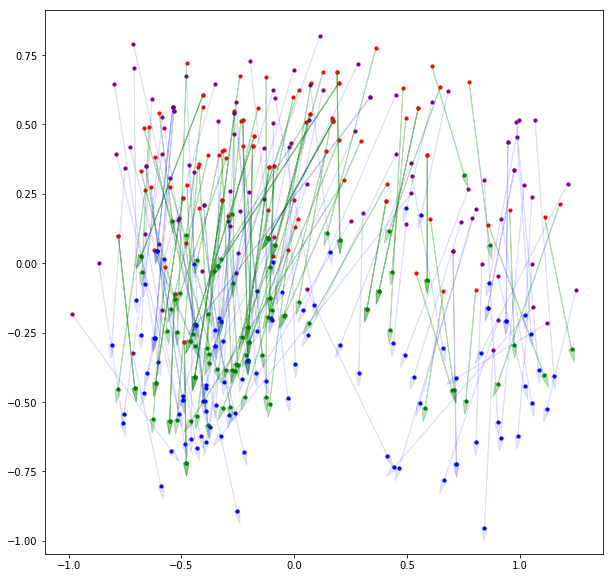

Cluster 48 (586 words)
[ 0.03414474 -0.01099501  0.06608444 -0.07033197  0.11678222  0.03031598
  0.13578792  0.00896014  0.13932265  0.0648238  -0.12499721 -0.16970077
 -0.0753046  -0.13278168  0.10525356  0.08082141  0.36090884  0.05554505
  0.07141028  0.10932384  0.04123009  0.18077335  0.08809181 -0.17843801
 -0.07742515 -0.07501218 -0.02285963 -0.12392094  0.01433406 -0.05462303
  0.04323994 -0.0717059 ]
{'en-advcl': 28, 'en-advmod': 21, 'en-nsubj': 62, 'en-obl': 25, 'en-punct': 38, 'fr-conj': 28, 'fr-nmod': 23, 'fr-nsubj': 106, 'fr-obl': 42}
0.45008692
[['P.S. Tom , Please , contact Vernon and get the details .' '1' 'Tom']
 ['ok well i have a crush on 2 guys but unforchunitly it is almost valentine s day afnd i just broke up with my and i have dated one of the guys i like and one guy lives in my naborhood guy i need your help i am a girl but i need a guy s help what shoul i do ?'
  '33' 'like']
 ['ok well i have a crush on 2 guys but unforchunitly it is almost valentine s day af

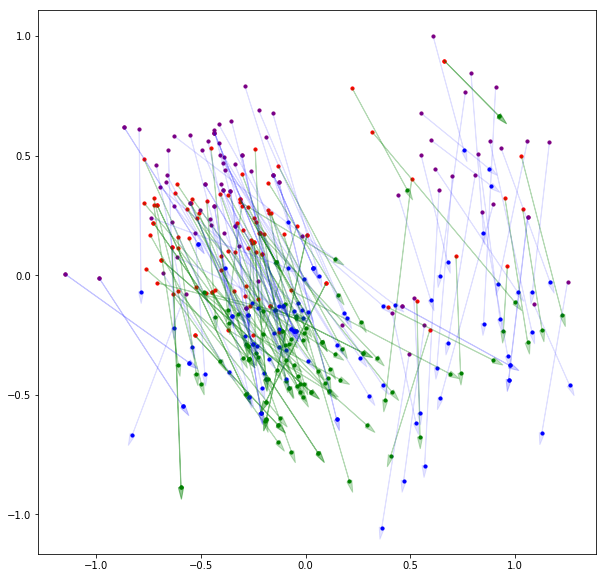

Cluster 49 (425 words)
[ 0.25300768  0.12369978 -0.0006052   0.02592409 -0.30871993 -0.53899616
  0.08122747  0.00840906 -0.10948896 -0.0574902  -0.44326767 -0.07212315
  0.01752991 -0.08028591  0.02622968 -0.03258417 -0.39881143  0.08620165
  0.20778878  0.20246798  0.07392083  0.29732674  0.19898473 -0.18838486
  0.01252515 -0.24982075  0.02696696 -0.1068309  -0.11498122 -0.116841
 -0.06928672 -0.19726346]
{'en-conj': 41, 'en-punct': 24, 'fr-acl': 64, 'fr-advcl': 30, 'fr-conj': 101, 'fr-obl': 33}
0.5347551
[['Interim Palestinian leader and the front - runner in the upcoming Jan. 9 , 2005 presidential election Mahmoud Abbas talks during his first official campaign speech in the West Bank town of Ramallah , Saturday Dec. 25 , 2004 .'
  '25' 'speech']
 ['You wear your heart on your sleeve ... and since you are an emotional person you are apt to give your all ... heart and soul ... to all those that show you a little affection ... but take care ... it would appear that you have been extr

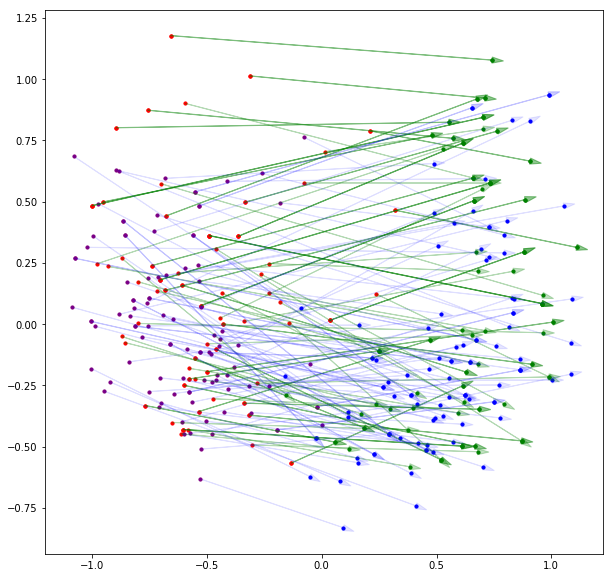

Cluster 50 (500 words)
[ 0.12831233 -0.0718859  -0.06069731  0.12934108 -0.10304047 -0.16444278
 -0.09381264 -0.10740487 -0.008852   -0.14481395  0.2106709  -0.110284
 -0.09975798 -0.38966173 -0.11901867 -0.05138693  0.12988073  0.01204226
  0.06565282 -0.19118926 -0.01756747  0.01757477 -0.17877324  0.0097804
  0.06819752 -0.08632419  0.03243294  0.04980998 -0.15367058  0.10837582
  0.19281447  0.03292155]
{'en-aux': 153, 'fr-aux': 281}
0.46737096
[['We have stayed at Tanglewood for many years now .' '1' 'have']
 ["they have n't heard from you in a while ." '1' 'have']
 ["I have visited Dr. Cooper 's office twice and I am very impressed with how friendly and polite the staff is ."
  '1' 'have']]
[['Le cardinal Suhard a voulu cet édifice en action de grâces parce que Paris avait été épargné par la guerre de 39-45 .'
  '14' 'avait']
 ["L' augustin Bernardus Désirant ( 1656-1725 ) , professeur à l' Université de Louvain , fut accusé d' avoir fabriqué de faux documents dans la controverse

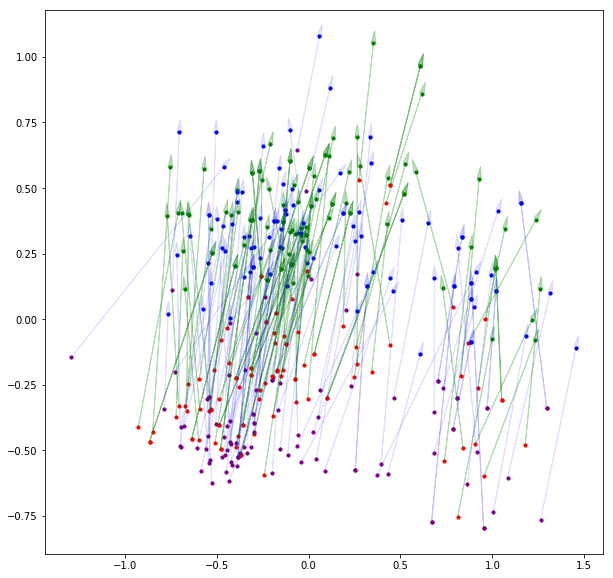

Cluster 51 (940 words)
[-0.02165834  0.10392541 -0.08087871  0.10171393  0.02191289 -0.08122568
  0.13657947 -0.13467126 -0.00596287  0.0252483  -0.18331538  0.12631598
  0.08360537 -0.09332921  0.04997532  0.09646349  0.15197653  0.06886563
 -0.39508408 -0.1474579   0.0703732   0.16800043  0.03579591 -0.07794571
  0.02064676  0.07620805  0.03632828  0.2019199  -0.1315734   0.00103229
  0.07372606 -0.05028155]
{'en-expl': 69, 'en-nsubj': 300, 'fr-nsubj': 484}
0.397781
[['I would go with a small rodent such as a mouse , rat , hamster or gerbil if you want something you can handle and hold .'
  '7' 'such']
 ['what does it mean when a veiled chameleon egg is soft ?' '2' 'it']
 ['In the past there have been .. and maybe there still are many things that you have had to do without .'
  '9' 'there']]
[['Il part à Londres et obtient un diplôme de doctorat .' '0' 'Il']
 ['Il a joué précédemment sur un Marshall JCM2000Dsl 100 .' '0' 'Il']
 ["Il peut s' agir de Koláčky ( petites tartes ) ou encor

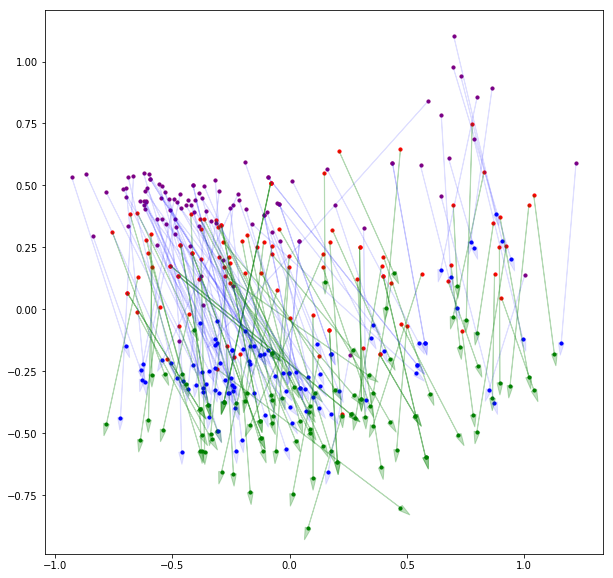

Cluster 52 (991 words)
[-0.04650795  0.03451053  0.4177472  -0.07960935 -0.25851294  0.04782541
 -0.08266893  0.00229305  0.01333103  0.037181    0.07611392 -0.0112746
 -0.16101725  0.0238065  -0.07691804  0.15053737 -0.05291843 -0.12823214
  0.00425988  0.04870268 -0.00702806  0.04356916  0.00390532 -0.01180032
 -0.1416246   0.019164    0.02429611  0.12706429 -0.00551723 -0.05824883
 -0.07607841  0.01674968]
{'en-amod': 221, 'en-compound': 487, 'fr-amod': 27, 'fr-case': 23, 'fr-nmod': 41, 'fr-obl': 36}
0.46730825
[['The Neocons in the CPA have all sorts of ulterior motives and social experiments they want to impose on the Iraqi people , including Polish - style economic shock therapy , some sort of sweetheart deal for Israel , and maybe even breaking the country up into three parts .'
  '28' 'shock']
 ['The multiple planetary afflictions are taking their toll .' '2'
  'planetary']
 ['This is either gross incompetence or was done with dark ulterior motives that can scarcely be guessed 

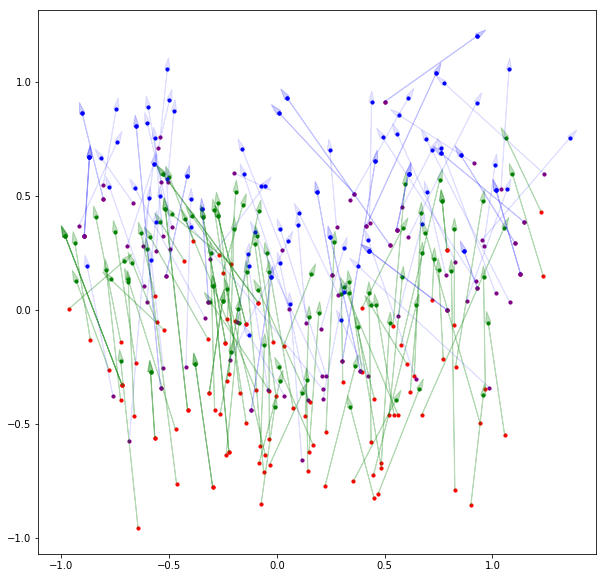

Cluster 53 (727 words)
[-0.04509422 -0.1185539   0.07416894 -0.19382307 -0.0340547  -0.15100831
  0.19054621  0.01919204  0.05075549 -0.00441531  0.05392835 -0.02263023
 -0.04807846 -0.04672566  0.16052458 -0.2965959   0.01872163  0.0885528
 -0.10654967 -0.0511003   0.08647175  0.02047607  0.0141111   0.07279914
 -0.14222543  0.04070409  0.0817419   0.04666646 -0.05362958 -0.20553613
 -0.00827502 -0.03441751]
{'en-advmod': 34, 'en-nummod': 107, 'en-obl': 27, 'fr-advmod': 30, 'fr-amod': 24, 'fr-case': 31, 'fr-nmod': 22, 'fr-nummod': 211, 'fr-obl': 37}
0.46960256
[['In London , the price of Brent North Sea crude for November delivery advanced 53 cents to 64.73 dollars .'
  '11' 'November']
 ['And on April 3 his chief aide in Najaf was suddenly arrested along with 13 other members of his organization , and the Coalition forces are put into violent conflict with his organization , which leaves 7 US soldiers dead .'
  '36' '7']
 ['The owner / baker , " Pie Guy " is a hoot to deal with as we

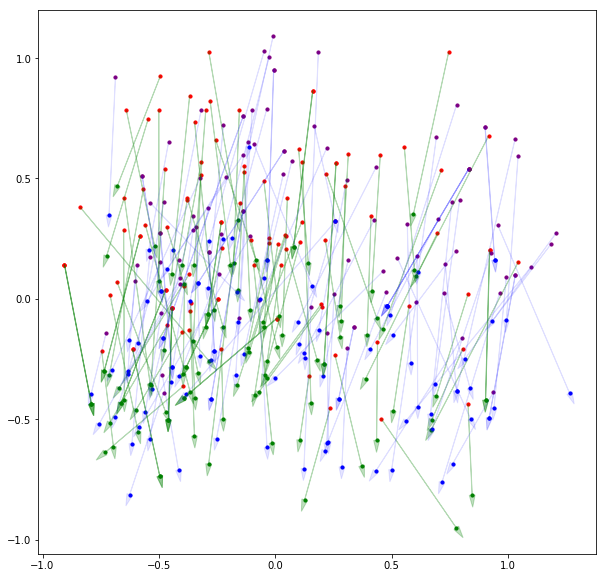

Cluster 54 (733 words)
[-0.13438709 -0.10977584 -0.17277603  0.21567301  0.11892034  0.01859722
 -0.14296381 -0.03588457  0.16022538  0.01061648 -0.08733413 -0.13877758
 -0.2855841   0.15131234  0.04636114  0.01793615 -0.00517519 -0.13852587
  0.12090805  0.08504106 -0.08202197  0.02259902 -0.14903182  0.03494957
  0.18089256  0.13451901  0.23921895  0.1084253  -0.02636588  0.02645969
  0.08766234 -0.09331226]
{'en-cc': 332, 'fr-cc': 333}
0.38285446
[['You have now decided to set your sights on a position or situation that could give you greater prestige and which will afford you considerable self esteem .'
  '19' 'and']
 ['( We check in early afternoon and we fly next day . )' '6' 'and']
 ["As long as you are a gentleman and treat them with respect they wo n't have any problem talking with you and your nationality will have nothing to do with how they treat you ."
  '7' 'and']]
[["Le Conseil a globalement adopté une définition large des noms insultants ou préexistants et le ministre n

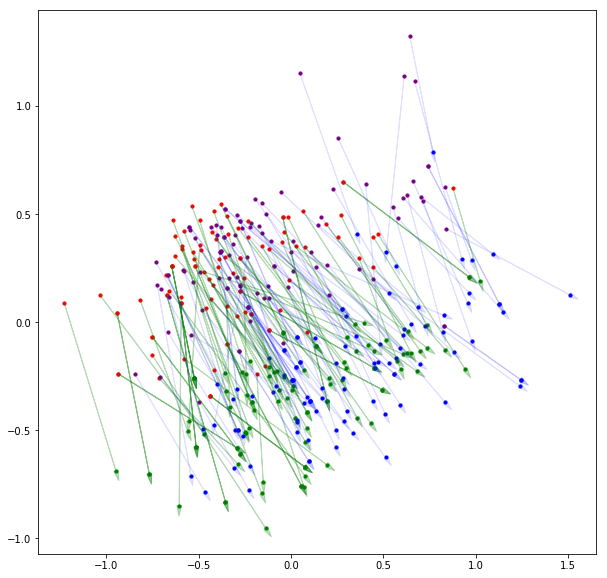

Cluster 55 (536 words)
[ 0.24904875 -0.00591594  0.0380579   0.02515093 -0.31413218 -0.10904475
  0.03381912 -0.13825938 -0.06446031  0.02740699  0.09076027 -0.05283513
  0.21539573  0.31410217  0.02903442  0.03219611  0.5192413  -0.06246325
  0.09248203  0.09036025  0.1027841   0.13011666  0.08821407  0.06545678
  0.04479996 -0.19005352  0.05993475 -0.18284592  0.15422474 -0.0907139
 -0.21312757 -0.05652721]
{'en-punct': 124, 'fr-punct': 393}
0.29052287
[['( Only recently have a few experienced State Department Arabists been allowed in to try to begin mopping up the mess . )'
  '22' ')']
 ['In London , the price of Brent North Sea crude for November delivery advanced 53 cents to 64.73 dollars .'
  '19' '.']
 ['The American - Arab Discrimination Committee is suing Condoleeza Rice and Donald Rumsfeld , charging that they mismanaged the evacuation efforts .'
  '21' '.']]
[['Cette terre riches en attraits naturels est maintenant bien implantée dans le domaine touristique , mais le domaine

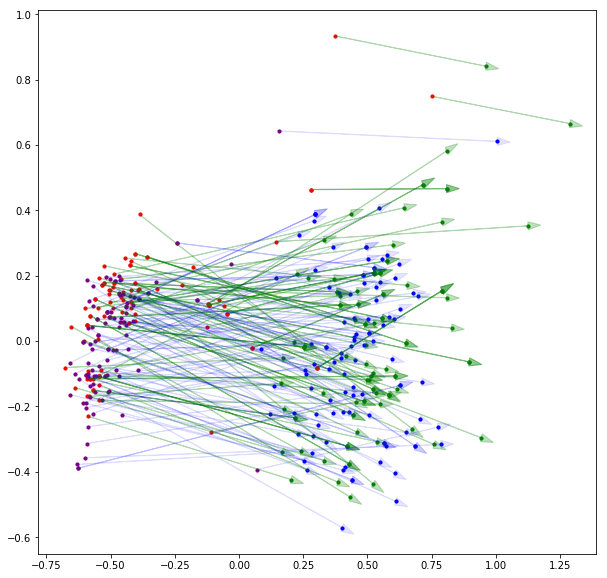

Cluster 56 (760 words)
[-0.05008797 -0.19481972 -0.10642169  0.07102099 -0.03621046 -0.06516595
 -0.01462398  0.20866069  0.02417726 -0.01852043  0.07876208  0.0400302
  0.13969782 -0.12989603 -0.15805213  0.14241867  0.01800771  0.10877422
 -0.05356507 -0.08510017 -0.03487876  0.0006452  -0.0606293   0.0629959
 -0.09206887 -0.10030806  0.16685486  0.13642652 -0.05198729 -0.05693208
 -0.07387707  0.04811498]
{'en-case': 26, 'fr-advmod': 93, 'fr-case': 232, 'fr-expl': 82, 'fr-mark': 49, 'fr-nsubj': 36, 'fr-obj': 46}
0.48497403
[['The multiple planetary afflictions are taking their toll .' '7' 'toll']
 ['For some black satire on Fallujah , see Unconfirmed Sources which has some fun with my Weblog .'
  '1' 'some']
 ["Chuck and Gretchen were very positive , and when Alan 's refused to work on my bike , Chuck came right out and saw the problem and did what Alan 's mechanic would n't do ."
  '34' 'do']]
[["Ces institutions prêtent à leur tour l' argent reçu à des habitants du pays dans leque

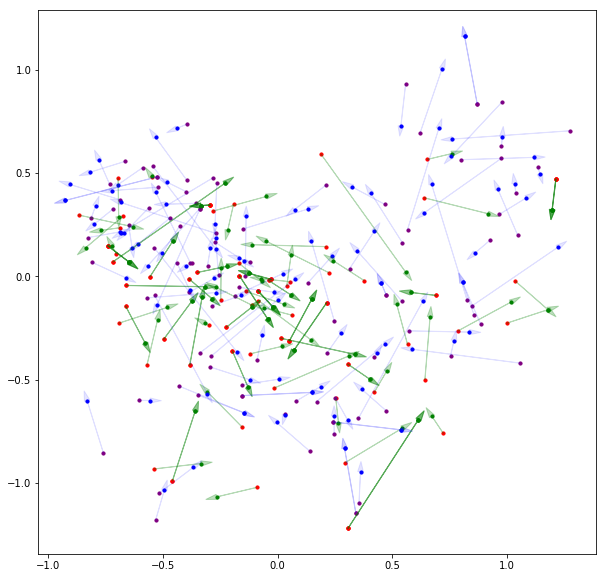

Cluster 57 (574 words)
[ 0.0743708  -0.03756498  0.07203206 -0.01368372 -0.05350354 -0.247249
 -0.00616365 -0.14593631 -0.09609176  0.12972507 -0.2830296  -0.09306652
  0.24191682 -0.0182535  -0.00611821  0.02480439 -0.24552152 -0.18502314
  0.22565405 -0.23109926  0.02725232 -0.024424    0.1654997  -0.01215848
 -0.10781344 -0.06003192  0.16846633  0.05512119 -0.04777145 -0.08343649
 -0.11188652 -0.09943969]
{'en-acl': 24, 'en-conj': 32, 'en-nmod': 31, 'en-obl': 41, 'fr-acl': 29, 'fr-appos': 24, 'fr-conj': 79, 'fr-nmod': 65, 'fr-obl': 81}
0.40316063
[['" It \'s not cost - effective doing station flights while at the same time focusing on getting back to the Moon , " says Brett Alexander , vice-president of Transformational Space , one of the companies hoping to launch astronauts to the ISS .'
  '17' 'getting']
 ['" It \'s not cost - effective doing station flights while at the same time focusing on getting back to the Moon , " says Brett Alexander , vice-president of Transformational S

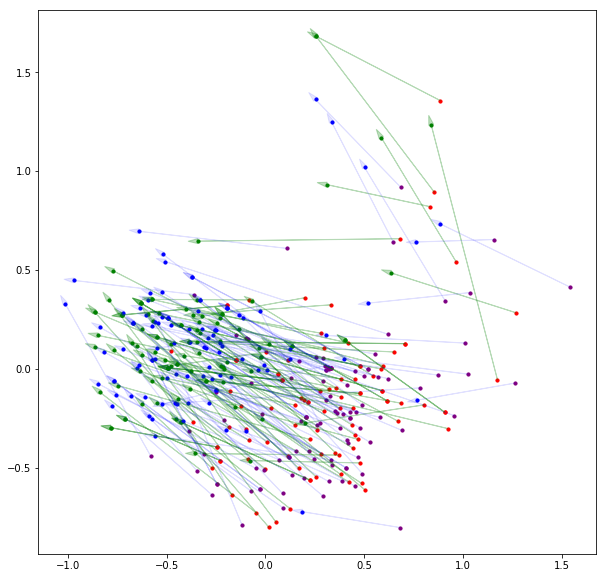

Cluster 58 (777 words)
[-0.06555381  0.13864774 -0.16876988 -0.09608372 -0.00503188 -0.05184215
 -0.09602541  0.08665015 -0.04066412  0.08527003  0.12258032  0.12116074
 -0.04958411 -0.14706251  0.09707677 -0.00179936  0.01685485 -0.13006482
  0.09949882 -0.06897899 -0.02410671 -0.04184681  0.06190972 -0.15264781
 -0.0629677  -0.00084505  0.00774315 -0.17229345  0.08461811  0.01840037
 -0.02869178 -0.04669563]
{'en-aux': 95, 'en-cop': 73, 'fr-acl': 31, 'fr-amod': 52, 'fr-aux': 78, 'fr-cop': 31, 'fr-expl': 66, 'fr-nmod': 62, 'fr-obj': 45}
0.45960695
[['They are out of business .' '2' 'out']
 ['Caldwell insurance has been doing our insurance for a couple years now and they have been extremely thorough .'
  '15' 'been']
 ['He said the top three cartoons will be announced on September 2 , with the winners being awarded prizes of 12,000 , 8,000 and 5,000 dollars respectively .'
  '26' 'respectively']]
[['Billie Holiday ne chante pas , elle joue dans tous les sens du terme , elle est à la fo

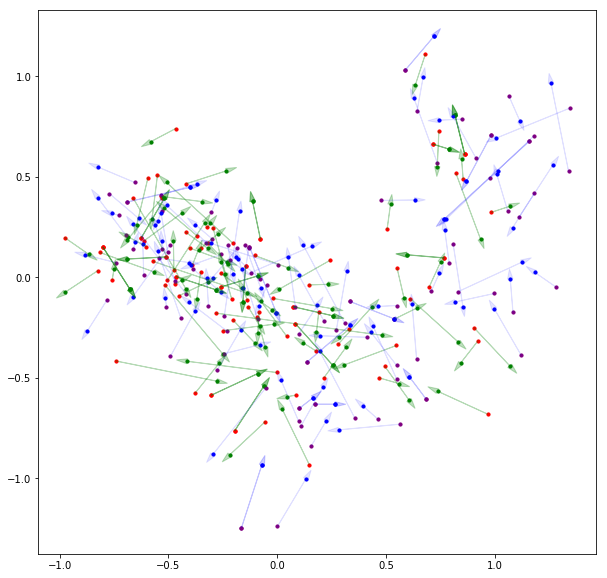

Cluster 59 (1169 words)
[ 0.15191698 -0.03596796  0.10230851  0.18914565  0.09978231  0.23294953
 -0.00255557 -0.03019804 -0.02312263  0.16756113  0.04305018 -0.03829537
  0.06676076 -0.06977494 -0.11719039  0.03089261 -0.25110716 -0.13672256
 -0.03810937  0.07644723  0.04288344 -0.10563083 -0.1496138  -0.21590441
 -0.06881604  0.00736352 -0.00599159 -0.14978641  0.13877551 -0.02349909
 -0.14176273 -0.01254947]
{'en-nmod': 89, 'en-obl': 22, 'fr-amod': 209, 'fr-appos': 23, 'fr-flat': 36, 'fr-nmod': 584, 'fr-obl': 36}
0.5297301
[["After several years of use , we arrive at the present day when the village people have suddenly discovered the fertilizer is actually the bottling plant 's waste sludge and is laden with cadmium , a highly toxic , cancer - causing heavy metal ."
  '2' 'years']
 ['Thank you for helping us to sell out of our first issue , now let your friends and local news organizations know that a delicious reprint , with a hot spanking new cover by Greg Mannino , is available 

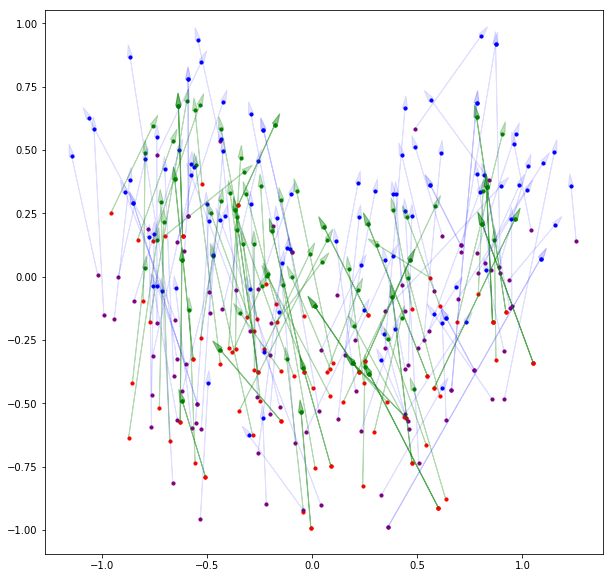

Cluster 60 (768 words)
[ 0.1872561  -0.08218352 -0.05994169  0.12281828  0.02154152  0.06333894
  0.19461225 -0.05696527 -0.14480945  0.05183272  0.03949931  0.07395095
 -0.08910296  0.04891085  0.20097552  0.03028829 -0.0799078  -0.078417
 -0.0542888   0.00664608 -0.04769864  0.03033123  0.0340877   0.23357311
 -0.27178213 -0.02991061 -0.15088043  0.08621005 -0.21130529  0.09695242
  0.19211584 -0.04232165]
{'en-case': 21, 'en-nmod': 302, 'fr-det': 348}
0.5059326
[["If you 've successfully used any of these supplement to aid weight loss , please write me at gottlie...@yahoo.com and let me know , telling me about your experience ."
  '27' 'your']
 ["During the preliminary interrogation , Lone ' confessed ' his involvement in the blasts and gave several vital clues ."
  '9' 'his']
 ['During this period , they offer cheap air tickets to their country on certain flights .'
  '10' 'their']]
[['Elle écrit pour son blog intitulé Dancing shoes ( mode et musique ) .'
  '3' 'son']
 ["Ses clubs 

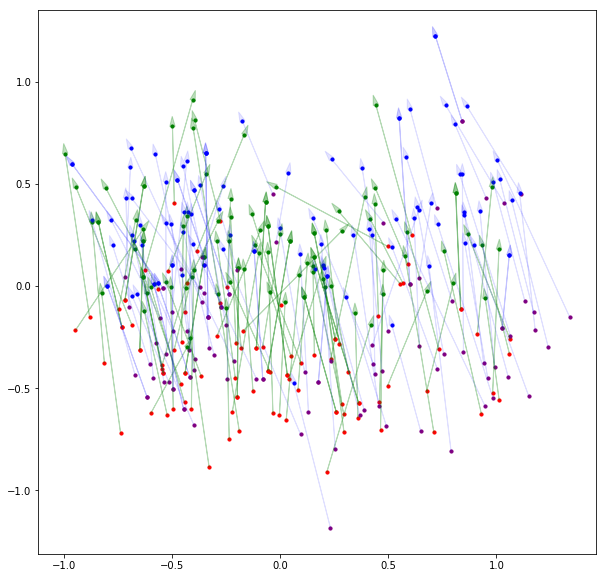

Cluster 61 (962 words)
[-0.07442072 -0.08976766 -0.17905098 -0.07406384  0.16540152  0.06674237
  0.00321609  0.11055313 -0.13668132  0.02402776  0.0646984  -0.13995354
 -0.12885892  0.16312225 -0.01396232 -0.02764334 -0.04158664  0.20422752
 -0.00779573 -0.2519553  -0.06173058  0.17154673  0.21656105 -0.10057476
 -0.02509406 -0.08803621  0.17210385 -0.04160864 -0.13939314  0.02045088
  0.05613991  0.10967373]
{'en-advmod': 27, 'en-case': 170, 'fr-case': 564, 'fr-det': 48, 'fr-nmod': 29}
0.5379884
[['you can view at dresscod.com' '3' 'at']
 ["We 've had about 5 repairs done on 3 different laptops ." '6' 'done']
 ['Posted by Hidden Nook to Hidden Nook at 3/9/2005 11:16:00 PM' '1' 'by']]
[['En effet , on y retrouve la même approche , des arrangements précis combinés à une grande liberté laissée aux solistes .'
  '18' 'laissée']
 ["La vieille-ville de Krouchevo fut notamment visitée par Le Corbusier , il apprécia grandement l' ensemble compact de maisons caractérisées par des couleurs viv

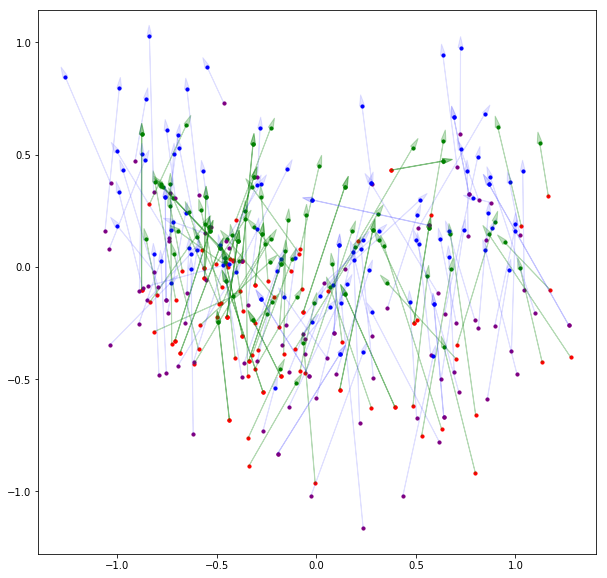

Cluster 62 (1457 words)
[-0.10849331 -0.12016094 -0.14043547  0.03340982  0.05021331 -0.13916428
 -0.1946997   0.05064588 -0.15297301 -0.3342434  -0.10782634  0.06190394
 -0.24360523  0.14183079 -0.09098158  0.04912427  0.10496619 -0.04974243
 -0.07626468  0.00806527  0.13321206 -0.24356407  0.0361358  -0.03751843
 -0.05963815  0.08107214 -0.00475324 -0.22824897 -0.10326239  0.1908096
 -0.16661446  0.22795554]
{'en-punct': 415, 'fr-punct': 1001}
0.45271453
[['Summary : Not cheep , but very fast , and super friendly service .'
  '1' ':']
 ["Usually , these are just a chance for the suckups to suck up , but this time people are actually concerned about the company 's plans ."
  '1' ',']
 ['Thank you ,' '2' ',']]
[["Dans l' étape de jeudi ( Tourmalet ) , qui est très dure , il faut s' attendre à de très gros écarts , supérieurs à ceux du contre-la-montre ."
  '8' ',']
 ["Sous les arcades , dans les cantons de la croix , douze personnages debout , des apôtres ou des pères d' église , tienn

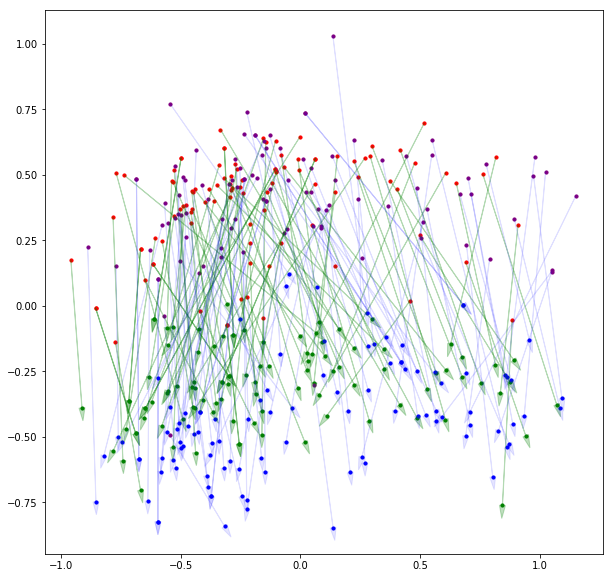

Cluster 63 (767 words)
[ 0.06830604 -0.11675701 -0.06138984  0.01000856 -0.00526391 -0.13114862
 -0.02685777 -0.0197372   0.06221168  0.21476455 -0.14770325 -0.07519075
 -0.00771028 -0.05074951 -0.12790556 -0.06858395  0.06311847  0.14915735
 -0.03220687  0.1807974  -0.06813753  0.14699814  0.11793399 -0.14997032
 -0.07958416 -0.02802559 -0.07902664  0.2443122   0.07162125 -0.11495345
  0.13971573  0.01093268]
{'en-advmod': 69, 'en-case': 64, 'en-cc': 30, 'en-mark': 84, 'en-nsubj': 23, 'fr-advmod': 81, 'fr-case': 189, 'fr-cc': 28, 'fr-mark': 42}
0.34628135
[['Please help .' '0' 'Please']
 ['Food like the stuff they eat in Spanish countries like tacos , beans , rice , pork , steak , ect .'
  '1' 'like']
 ['Until we have come up with those numbers it would be premature to make any offers for the summer .'
  '0' 'Until']]
[['Au nom de quoi refuser telle pratique et autoriser telle autre ?' '1'
  'nom']
 ['Depuis peu , cette créatrice inspirée fait aussi des chaussures customisées en plus 

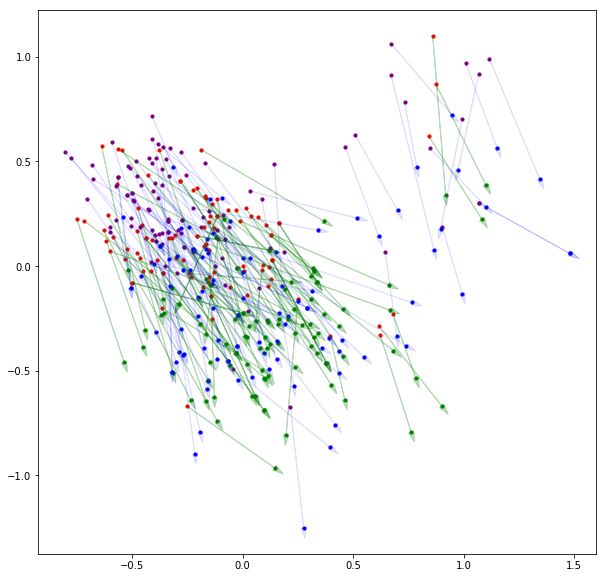

Cluster 64 (657 words)
[-0.13361967  0.16609043 -0.13466462 -0.11362578  0.08600117 -0.06875778
  0.02741561  0.10557759 -0.02945013 -0.3838566  -0.18992944  0.04591425
 -0.11974853  0.16116309 -0.11635426  0.07465925  0.09591169  0.12950079
  0.07461477 -0.05093851  0.05595791 -0.13937175  0.27077037 -0.18202792
 -0.17164285  0.21290252 -0.12661019 -0.08292019 -0.11282147  0.12608933
 -0.19996172  0.22196843]
{'en-punct': 268, 'fr-punct': 350}
0.5766407
[["But , I 'm very happy for you !" '1' ',']
 ['cats react to the treatment they receive , they are not toys .' '7'
  ',']
 ['Your father never listens to me , what can I say ?' '6' ',']]
[['Quand on hésite , pas de panique , Michelle est là pour nous donner de précieux conseils .'
  '7' ',']
 ["Depuis l' âge de 15 ans il façonne le bois afin de réaliser ou de restaurer les plus beaux instruments du quatuor ( alto , violon , violoncelle , contrebasse ) ."
  '28' ',']
 ["Miro s' attira aussi la faveur populaire lorsqu' il renvoya sur le

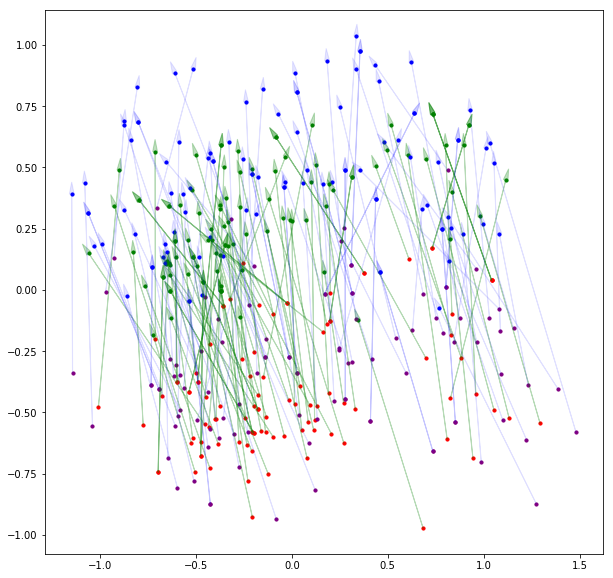

Cluster 65 (663 words)
[-0.05248764 -0.09209229  0.13899212 -0.0941472   0.33241227 -0.31778303
  0.09206116 -0.14127629  0.05361717  0.13284059  0.007036   -0.08283592
  0.13146992 -0.03040788  0.06037817  0.33863863 -0.24097252 -0.08493093
  0.15589316 -0.04459499  0.08586322 -0.01078764  0.06467056 -0.02898455
 -0.04004123 -0.06153626  0.11743437  0.01127774  0.09732222  0.04248381
  0.02682013  0.04780472]
{'en-acl': 27, 'en-advcl': 26, 'en-conj': 59, 'en-nmod': 30, 'en-obl': 35, 'fr-acl': 52, 'fr-appos': 33, 'fr-conj': 97, 'fr-nmod': 73, 'fr-obl': 69}
0.41763958
[['This happened very quickly , and I wanted to make sure that I let everyone know before I left .'
  '18' 'left']
 ['I have a friend that has to get rid of one of her cats because of allergies , he is the youngest at 3 years old black , long hair , incredibly friendly .'
  '16' 'allergies']
 ['I would go with a small rodent such as a mouse , rat , hamster or gerbil if you want something you can handle and hold .'
  '14' '

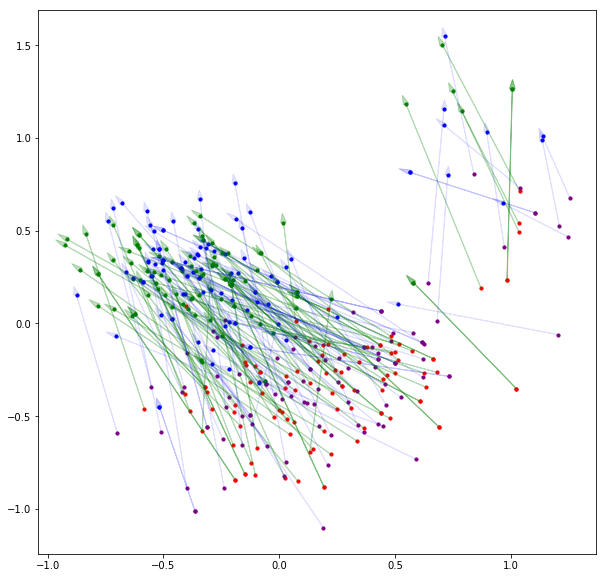

Cluster 66 (318 words)
[ 0.23606926  0.29147917 -0.09642868  0.17739871 -0.3055729   0.03856118
 -0.05703562  0.08992735  0.18003285 -0.36133626 -0.24150574 -0.10297281
 -0.19238873 -0.07154781  0.24949877  0.03108479 -0.10956689  0.2871279
  0.07143042  0.3635237   0.09823945  0.15853989 -0.2179038  -0.09127888
 -0.21964546 -0.13143817  0.3584349  -0.11409135 -0.07624584 -0.04253107
 -0.06908624 -0.1943553 ]
{'en-conj': 33, 'fr-acl': 29, 'fr-conj': 77, 'fr-nmod': 23, 'fr-obl': 33}
0.58438635
[['You got ta get an iPhone for 3G ... only way ... actually there is a thing that you pay for monthly that gets wifi from satellite and you can connect to it anywhere but you have to Cary it with you'
  '36' 'have']
 ['i am deadly serious , i really do get sexual releif from even hearing of torture of animals , now some people may call me a brute or a coward but i ca nt help my true feelings .'
  '34' 'help']
 ['" The book -- I guess one way , one thing to think about it is -- one of the themes w

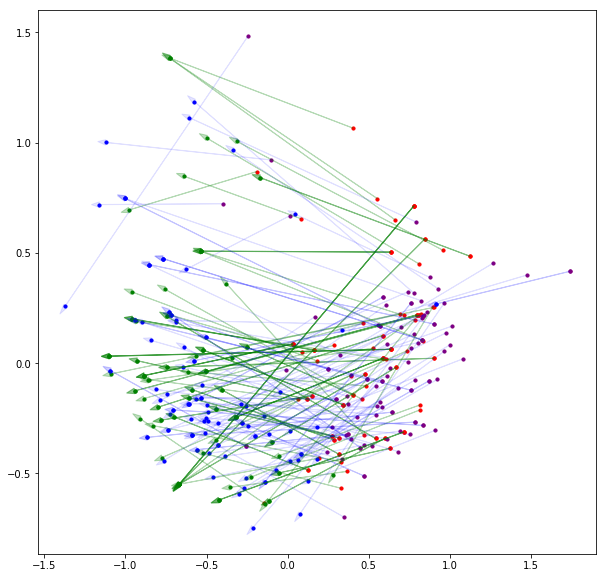

Cluster 67 (843 words)
[-0.08222707 -0.14992967 -0.05078133  0.19755007  0.1355237  -0.0556497
  0.06562266 -0.1617577   0.22901866 -0.06055082 -0.10979863 -0.09686153
 -0.08001117  0.09423685  0.12152224 -0.13232237 -0.06223972 -0.16110198
  0.2393768   0.04385382  0.08190046  0.12385815  0.03079543  0.06801865
  0.15151168  0.18172629  0.13913526 -0.06048445 -0.08568129  0.12888913
  0.04562799 -0.09938118]
{'en-cc': 324, 'en-conj': 27, 'fr-cc': 387, 'fr-conj': 39}
0.5615122
[['i am deadly serious , i really do get sexual releif from even hearing of torture of animals , now some people may call me a brute or a coward but i ca nt help my true feelings .'
  '27' 'or']
 ['I searched all over the internet , but I could not find one place in Tampa Bay that sells morcillas , also known as blood pudding , black pudding and blood sausages .'
  '29' 'and']
 ['A company which provide good quality portals , E-commerce solutions , web based MMOG ... etc'
  '14' '...']]
[["L' application de la lé

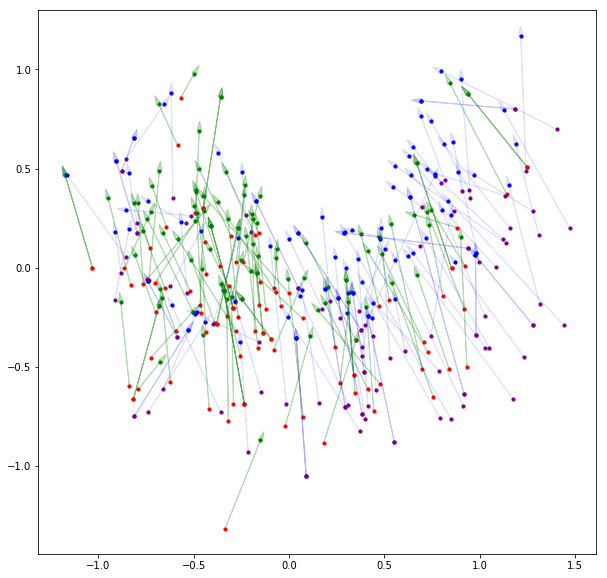

Cluster 68 (568 words)
[ 0.09560558  0.0700328  -0.08308975  0.30947432  0.19322877 -0.04195429
  0.06245467  0.10560441 -0.00246695  0.19922383  0.16192505 -0.15177722
 -0.16854052  0.1605186  -0.11086272 -0.06356457 -0.048576    0.19528466
 -0.02363895 -0.27610195 -0.02194483 -0.13777092  0.0098219   0.05898976
 -0.02144085 -0.02461619  0.03749534  0.06926842 -0.16961135 -0.13647078
  0.18445097 -0.12291262]
{'fr-case': 411, 'fr-det': 41, 'fr-fixed': 24}
0.53482336
[['The games will have to take place on Fri , Sat , or Sun .' '12' 'or']
 ['And what is their big / main meal of the day .' '8' 'of']
 ['" The problem is not with the Palestinian resistance groups but with Israel \'s scheme to destroy the Palestinians \' infrastructure , " Habib said .'
  '13' "'s"]]
[["La Musique de la gendarmerie mobile fait partie des musiques militaires de la place de Paris , placée sous l' autorité du Commandant de la Région de Gendarmerie de Paris et du Gouverneur militaire de Paris ."
  '14' 'de']
 

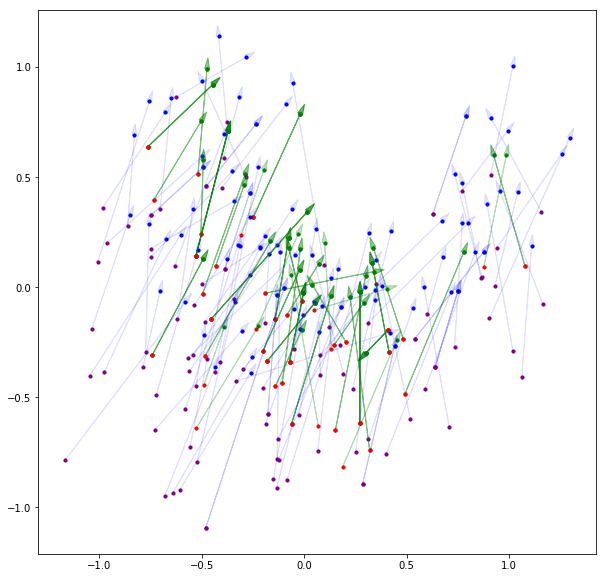

Cluster 69 (548 words)
[-0.01540152  0.25823894  0.04727539 -0.04273631  0.06105958 -0.0079348
 -0.01029787  0.06073665 -0.04120568 -0.03847708 -0.01327153 -0.10627303
  0.05772756  0.03487308  0.16552585 -0.25530767  0.0469842   0.10712826
  0.01636698 -0.18138489 -0.08460645 -0.00870274  0.23253469  0.03639614
 -0.02065791  0.2214405  -0.03854615 -0.03248626 -0.03735579  0.0580263
  0.06052518 -0.02462751]
{'en-case': 21, 'en-punct': 103, 'fr-case': 44, 'fr-nmod': 37, 'fr-obl': 39, 'fr-punct': 109}
0.46504068
[['Iguazu is in Argentina :)' '4' ':)']
 ['I used to e-mail Vince Kaminski about the advice on his article " The Challenge of Pricing and Risk Managing Electricity Derivatives " and he had mailed me the copy .'
  '12' '"']
 ['Email : " Julie " < julie...@bellsouth.net >' '2' '"']]
[['Le lazy bed ( littéralement : « plate-bande de paresseux » ) est une technique de travail du sol autrefois pratiquée dans certaines régions des Îles britanniques .'
  '6' '«']
 ["Sous contrat chez R

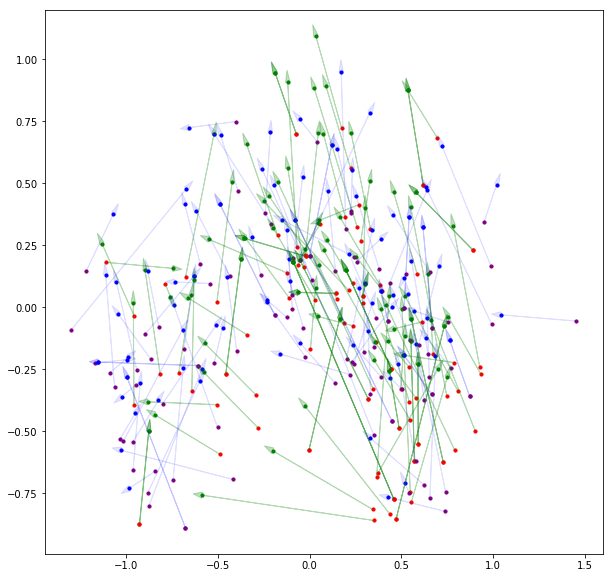

(548, 2, 2)


In [37]:
NUM_TO_DRAW = 100

u_labels, counts = np.unique(kmeans_all.labels_, return_counts=True)
for cluster in u_labels:
  word_pairs = pairs_data[kmeans_all.labels_ == cluster]
  print("Cluster {} ({} words)".format(cluster, word_pairs.shape[0]))
  print(kmeans_all.cluster_centers_[cluster])
  trimmedLabels = labels[kmeans_all.labels_ == cluster]
  cluster_labels, counts = np.unique(trimmedLabels, return_counts=True)
  print(dict([kv for kv in zip(cluster_labels, counts) if kv[1] > 20]))
  pca = PCA(n_components=2)
  pca_data = pca.fit_transform(word_pairs.reshape(-1, 32))
  print(np.sum(pca.explained_variance_))
  pca_data = pca_data.reshape(-1, 2, 2)
  

  plt.figure(figsize=(10, 10))

  is_src = np.vectorize(lambda x: 'en' in x)
  is_dest = np.vectorize(lambda x: 'fr' in x)

  
  to_draw_src = pca_data[is_src(trimmedLabels)]
  to_draw_dest = pca_data[is_dest(trimmedLabels)]

  indices_to_examine_src = np.random.randint(to_draw_src.shape[0], size=NUM_TO_DRAW)
  indices_to_examine_dest = np.random.randint(to_draw_dest.shape[0], size=NUM_TO_DRAW)
  
  to_draw_src = to_draw_src[indices_to_examine_src]
  to_draw_dest = to_draw_dest[indices_to_examine_dest]
  
  print(extra[kmeans_all.labels_ == cluster][is_src(trimmedLabels)][indices_to_examine_src][0:3])
  print(extra[kmeans_all.labels_ == cluster][is_dest(trimmedLabels)][indices_to_examine_dest][0:3])
  
  for row in to_draw_src:
    plt.arrow(row[0][0], row[0][1], row[1][0] - row[0][0], row[1][1] - row[0][1], color='green', head_width=0.025, head_length=0.05, alpha=0.25)
  for row in to_draw_dest:
    plt.arrow(row[0][0], row[0][1], row[1][0] - row[0][0], row[1][1] - row[0][1], color='blue', head_width=0.025, head_length=0.05, alpha=0.1)
  
  plt.scatter(to_draw_src[:, 0, 0], to_draw_src[:, 0, 1], c='r', label='en-subj', s=10, alpha=1)
  plt.scatter(to_draw_src[:, 1, 0], to_draw_src[:, 1, 1], c='green', label='en-verb', s=10, alpha=1)

  plt.scatter(to_draw_dest[:, 0, 0], to_draw_dest[:, 0, 1], c='purple', label='fr-subj', s=10, alpha=1)
  plt.scatter(to_draw_dest[:, 1, 0], to_draw_dest[:, 1, 1], c='blue', label='fr-verb', s=10, alpha=1)

  plt.show()
    
    
pca_data = pca_data.reshape(-1, 2, 2)

# ROW_TO_CHECK = 57
# pca_first_test = pca.transform(trimmedData[ROW_TO_CHECK][1].reshape(1, -1)).squeeze()
# assert np.allclose(pca_first_test, pca_data[ROW_TO_CHECK][1])

print(pca_data.shape)